**Import necessary Libraries,**
**Packages download and installations**

In [1]:
import numpy as np
import pandas as pd
from datetime import datetime

**Installations**

In [2]:
# Text processing libraries
!pip install nltk spacy emoji textblob contractions wordsegment

# Sentiment analysis
!pip install vaderSentiment==3.3.2

# Deep learning and NLP libraries
!pip install transformers -U accelerate -U transformers[torch] -U

# Download the spacy model
!python -m spacy download en_core_web_sm


!pip install langdetect



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 358.9/358.9 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 14.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 21.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.8/110.8 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 20.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 34.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 39.6 MB/s eta 0:00:00
2023-09-04 08:47:49.295779: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable t

In [3]:
#download necessary libraries for preprocessing

import nltk
nltk.download('words')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Unzipping corpora/words.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [4]:
#import all necessary libaries
import pandas as pd
import logging
from nltk.corpus import wordnet
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.tokenize import WordPunctTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.tag import pos_tag
import spacy
from collections import Counter
import matplotlib.pyplot as plt
import re
from textblob import TextBlob
from typing import List, Callable, Union
from multiprocessing import cpu_count, Pool
from typing import List, Tuple, Union, Callable
from nltk.tokenize import TweetTokenizer
from langdetect import detect, DetectorFactory

In [5]:
import nltk
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

In [4]:
#Link notebook to google drive
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    COLAB = True
    print("Note: using Google CoLab")
    %tensorflow_version 2.x
except:
    print("Note: not using Google CoLab")
    COLAB = False

Mounted at /content/drive
Note: using Google CoLab
Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


# Web Scraping, Google Play Store, Trustpilot, and Twitter Datasets Import with some initial cleaning

## Web Scraping Google Play Store

In [ ]:
#import necessary libaries

from google_play_scraper import app
from google_play_scraper import Sort, reviews_all
from numpy.random import default_rng
from time import sleep

Using news reports, data was scraped for Spotify top global markets across North America, Latin America, Asia and Africa. Countries representing the continents are United States, Canada, United Kingdon, Ireland, Sweden, Mexico, Spain, Phillipines, India, Nigeria, South Africa, Ghana, and Kenya

### Google Play Store Web Scraping- Includes saving the scraped data if error encountred and catch all exceptions

In [ ]:
#fecth all reviews for the specified countries from google API

def scrape_reviews(app_id, country_codes=['us', 'ca', 'uk', 'ie', 'se', 'mx', 'es', 'ph', 'id', 'ng', 'sa', 'gh','ke'], retries=3):
    # Initialize a DataFrame to store all reviews
    df_all = pd.DataFrame()

    # Create random generator
    rng = default_rng()

    # Loop through all country codes and fetch reviews
    for country in country_codes:
        for _ in range(retries):
            try:
                # generates a scalar [single] value greater than or equal to 1 but less than 5
                time_to_sleep = rng.uniform(1, 5)
                sleep(time_to_sleep)  # Add delay between requests

                result = reviews_all(
                    app_id,
                    sleep_milliseconds=0,  # 0 ms means no sleep.
                    lang='en',  # Language is English
                    country=country,  # Use current country
                    sort=Sort.NEWEST,  # Sort by newest
                )

                # Convert the result to a DataFrame and add a country column
                df = pd.DataFrame(result)
                df['country'] = country

                # Append the data to the master DataFrame
                df_all = pd.concat([df_all, df])

                # If my code runs to this point, it means I have successfully fetched the data, break the retry loop
                break

            except Exception as e:
                print(f'Error occurred when fetching reviews for {app_id} in {country}. Retrying...')
                print(f"Exception details: {e}")

        # Save the scraped data to a CSV file after each country
        df_all.to_csv('google_play_reviews.csv', index=False)

    return df_all

# Use the function
df_ggps = scrape_reviews('com.spotify.music')

In [7]:
#df_ggplay = pd.read_csv(r"C:\Users\USER\Documents\UHull\Research Project\google_play_reviews.csv") #read file using lab
df_ggplay = pd.read_csv('/content/drive/My Drive/Project/google_play_reviews.csv') #using google colab

In [ ]:
# # Load data
# #df = pd.read_csv("google_play_reviews.csv")

# # Convert 'at' column to datetime
# df_ggplay['at'] = pd.to_datetime(df_ggplay['at'])

# # Get the distribution of reviews by year
# year_distribution = df_ggplay['at'].dt.year.value_counts()

# # Print the distribution
# print(year_distribution)


In [8]:
df_ggplay.count() #before filter

reviewId                3444292
userName                3444277
userImage               3444292
content                 3444292
score                   3444292
thumbsUpCount           3444292
reviewCreatedVersion    3085965
at                      3444292
replyContent             209184
repliedAt                209184
appVersion              3085965
country                 3444292
dtype: int64

In [9]:
print(df_ggplay.columns) #display columns

Index(['reviewId', 'userName', 'userImage', 'content', 'score',
       'thumbsUpCount', 'reviewCreatedVersion', 'at', 'replyContent',
       'repliedAt', 'appVersion', 'country'],
      dtype='object')


In [ ]:
# Initialize the first chunk flag
first_chunk = True

# Initialize counters for the statistics
total_rows = 0
total_dup_content = 0
total_rows_after_dropping = 0

# Keep track of all unique pairs of 'userName' and 'content'
unique_pairs = set()

# Load the data in chunks and process each chunk
chunksize = 10 ** 6  # adjusted this value based on system's memory
for chunk in pd.read_csv(r"C:\Users\USER\Documents\UHull\Research Project\google_play_reviews.csv", chunksize=chunksize):
    # Specify the columns to keep
    chunk = chunk[['userName', 'at', 'content', 'appVersion', 'country']].copy()

    # Convert 'at' column to datetime and filter rows where year is 2022 or later
    chunk['at'] = pd.to_datetime(chunk['at'])
    chunk = chunk[chunk['at'].dt.year >= 2022]

    # Convert 'userName' and 'content' to lowercase
    chunk['userName'] = chunk['userName'].str.lower()
    chunk['content'] = chunk['content'].str.lower()

    # Update total_rows counter
    total_rows += chunk.shape[0]

    # Update total_dup_content counter
    total_dup_content += chunk.duplicated(subset=['userName', 'content']).sum()

    # Keep only the rows where the pair of 'userName' and 'content' is not in unique_pairs
    chunk = chunk[~chunk.apply(lambda row: (row['userName'], row['content']) in unique_pairs, axis=1)]

    # Add the pairs of 'userName' and 'content' from this chunk to unique_pairs
    unique_pairs.update(chunk.apply(lambda row: (row['userName'], row['content']), axis=1).tolist())

    # Update total_rows_after_dropping counter
    total_rows_after_dropping += chunk.shape[0]

    # Add 'source' column and rename columns
    chunk['source'] = 'GooglePlayStore'
    chunk.columns = ['userName', 'date', 'review', 'appVersion', 'country', 'source']

    # Save the chunk to a new CSV file, appending if it's not the first chunk
    if first_chunk:
        chunk.to_csv(r"C:\Users\USER\Documents\UHull\Research Project\google_play_reviews_filtered.csv", index=False)
        first_chunk = False
    else:
        chunk.to_csv(r"C:\Users\USER\Documents\UHull\Research Project\google_play_reviews_filtered.csv", mode='a', header=False, index=False)

# Print the initial number of rows, the number of duplicates in 'userName' and 'content', and the number of rows after dropping duplicates
# print("Initial number of rows:", total_rows)
# print("Number of duplicate 'userName' and 'content':", total_dup_content)
# print("Number of rows after dropping duplicates:", total_rows_after_dropping)


In [11]:
#Read in the filtered dataset 2022 to the latest date in 2023
#df_ggplayf = pd.read_csv(r"C:\Users\USER\Documents\UHull\Research Project\Data\GooglePlayStore\google_play_reviews_filtered.csv")
df_ggplayf = pd.read_csv('/content/drive/My Drive/Project/Data/GooglePlayStore/google_play_reviews_filtered.csv') #using google colab


print(df_ggplayf.duplicated(subset=['userName', 'review']).sum())

235289


After performing chunk-wise duplicate removal process, there are still duplicates in the final DataFrame, df_ggplayf, when I load it into memory all at once. Attempted to load the chunks in batches previously.

A 'userName' and 'review' pair that appears in two different chunks would be considered unique in each individual chunk and would not be dropped.

In [12]:
df_ggplayf.count()
df_ggplayf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 340974 entries, 0 to 340973
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   userName    340968 non-null  object
 1   date        340974 non-null  object
 2   review      340974 non-null  object
 3   appVersion  310514 non-null  object
 4   country     340974 non-null  object
 5   source      340974 non-null  object
dtypes: object(6)
memory usage: 15.6+ MB


In [13]:
# Drop duplicates based on 'userName' and 'review'
df_ggplayf.drop_duplicates(subset=['userName', 'review'], keep='first', inplace=True)

# Check the number of duplicates again
userName_review_dups_after = df_ggplayf.duplicated(subset=['userName', 'review']).sum()


#Dropping all duplicates in reviews as there are different usernames with the same review from different countries and saving this to a new csv file
#after dropping thwe duplicates- to be used for the sentiment analysis

# Drop duplicates based on 'review' column
df_ggplayf.drop_duplicates(subset=['review'], keep='first', inplace=True)

# Check the number of duplicates again
review_dups_after = df_ggplayf.duplicated(subset=['review']).sum()

print(f"Duplicates based on 'userName' and 'review' after dropping: {userName_review_dups_after}")
print(f"Duplicates based on 'review' after dropping: {review_dups_after}")


Duplicates based on 'userName' and 'review' after dropping: 0
Duplicates based on 'review' after dropping: 0


In [14]:
# Check the number of rows left in the dataframe
df_ggplayf.shape[0]

104298

In [15]:
#check for missing values
df_ggplayf.isnull().sum()

userName          2
date              0
review            0
appVersion    10428
country           0
source            0
dtype: int64

In [16]:
# Set appVersion null to 'unknown'
df_ggplayf['appVersion'] = df_ggplayf['appVersion'].fillna('unknown')

# Change 'date' to datetime
df_ggplayf['date'] = pd.to_datetime(df_ggplayf['date'])


In [17]:
df_ggplayf.head(2)

,userName,date,review,appVersion,country,source
0,jama bradfield,2023-06-28 01:13:53,"stoppage issues. since the last update, i've h...",8.8.46.529,us,GooglePlayStore
1,night pantheress,2023-06-24 18:59:07,the new update makes it nearly impossible to e...,8.8.44.527,us,GooglePlayStore


In [18]:
# Check the number of duplicates again
print(df_ggplayf.duplicated(subset=['userName', 'review']).sum())
print(df_ggplayf.duplicated(subset=['review']).sum())

0
0


In [19]:
# Drop 'userName' column
df_ggplayf = df_ggplayf.drop(columns='userName')

# Save the cleaned dataframe to a new CSV file
df_ggplayf.to_csv('google_play_reviews22.csv', index=False)

In [20]:
df_ggplayreview = pd.read_csv('google_play_reviews22.csv') #cleaned and final data from googleplaystore

print(df_ggplayreview.columns)

Index(['date', 'review', 'appVersion', 'country', 'source'], dtype='object')


In [22]:
print(df_ggplayreview['date'].min())
print(df_ggplayreview['date'].max())

2022-01-01 00:13:00
2023-07-04 16:18:38


In [23]:
df_ggplayreview.head(5)

,date,review,appVersion,country,source
0,2023-06-28 01:13:53,"stoppage issues. since the last update, i've h...",8.8.46.529,us,GooglePlayStore
1,2023-06-24 18:59:07,the new update makes it nearly impossible to e...,8.8.44.527,us,GooglePlayStore
2,2023-06-25 19:12:44,it's the home page and the horrible playlists ...,8.8.46.529,us,GooglePlayStore
3,2023-06-20 12:52:10,using spotify for tv very 1.76.1 which updated...,8.8.44.527,us,GooglePlayStore
4,2023-06-24 10:45:51,i love spotify. it's a great app to listen to ...,8.8.46.529,us,GooglePlayStore


## Datascraping Trustpilot

In [ ]:
#datascraping

class TrustpilotScraper:
    def __init__(self):
        self.root = 'https://www.trustpilot.com'
        self.website = f'{self.root}/review/www.spotify.com'
        self.visited_pages = set()
        self.allUsers = []
        self.allRatings = []
        self.allDates = []
        self.allReviewContent = []
        self.allCountry = []
        self.allReviewTitles = []
        self.allSerialNumbers = []
        self.serial_number = 1

    def extract_reviews(self, start_page=1, end_page=80):
        for i in range(start_page, end_page+1):
            # Get each page to access the reviews
            page_url = f"{self.website}?page={i}"

            if page_url in self.visited_pages:
                continue  # Skip this page if it has already been visited
            else:
                self.visited_pages.add(page_url)

            # Get the page
            page = requests.get(page_url)

            # Get the page source and create a BeautifulSoup object
            soup = BeautifulSoup(page.text, 'html.parser')

            # Find all the reviews
            reviews = soup.find('section', class_='styles_reviewsContainer__3_GQw')

            # Parse the reviews
            self.parse_reviews(reviews)

    def parse_reviews(self, reviews):
        # Users
        users = reviews.find_all('span', class_='typography_heading-xxs__QKBS8 typography_appearance-default__AAY17')
        for user in users:
            self.allUsers.append(user.text.strip())
            self.allSerialNumbers.append(self.serial_number)
            self.serial_number += 1

        # Ratings
        ratings = reviews.find_all('div', class_='styles_reviewHeader__iU9Px')
        for rating in ratings:
            if rating.has_attr("data-service-review-rating"):
                self.allRatings.append(rating.attrs["data-service-review-rating"])
            else:
                self.allRatings.append(None)

        # Dates
        dates = reviews.find_all('p', class_='typography_body-m__xgxZ_ typography_appearance-default__AAY17')
        for date in dates:
            self.allDates.append(date.text.split(":")[1].strip())

        # Review Titles
        titles = reviews.find_all('h2', class_='typography_heading-s__f7029 typography_appearance-default__AAY17')
        for title in titles:
            self.allReviewTitles.append(title.text.strip() if title else None)

        # Review Content
        content = reviews.find_all('p', class_='typography_body-l__KUYFJ typography_appearance-default__AAY17 typography_color-black__5LYEn')
        for story in content:
            self.allReviewContent.append(story.text.strip() if story else None)

        # Countries
        countries = reviews.find_all('div', class_='typography_body-m__xgxZ_ typography_appearance-subtle__8_H2l styles_detailsIcon__Fo_ua')
        for j in range(len(users)):  # assuming every user corresponds to a country.
            try:
                self.allCountry.append(countries[j].text.strip())
            except IndexError:
                self.allCountry.append(None)  # Append None if a country is not found

    def get_dataframe(self):
        # Store extracted data in a DataFrame
        df_tp = pd.DataFrame({
            "S/N": self.allSerialNumbers,
            'user': self.allUsers,
            'rating': self.allRatings,
            'date': self.allDates,
            'reviewTitle': self.allReviewTitles,
            'reviewContent': self.allReviewContent,
            'country': self.allCountry})

    def get_dataframe(self):
        # Balance the lists
        max_length = max(len(self.allUsers), len(self.allRatings), len(self.allDates), len(self.allReviewTitles), len(self.allReviewContent), len(self.allCountry))

        if len(self.allUsers) < max_length:
            self.allUsers.extend([None] * (max_length - len(self.allUsers)))

        if len(self.allRatings) < max_length:
            self.allRatings.extend([None] * (max_length - len(self.allRatings)))

        if len(self.allDates) < max_length:
            self.allDates.extend([None] * (max_length - len(self.allDates)))

        if len(self.allReviewTitles) < max_length:
            self.allReviewTitles.extend([None] * (max_length - len(self.allReviewTitles)))

        if len(self.allReviewContent) < max_length:
            self.allReviewContent.extend([None] * (max_length - len(self.allReviewContent)))

        if len(self.allCountry) < max_length:
            self.allCountry.extend([None] * (max_length - len(self.allCountry)))

        # Store extracted data in a DataFrame
        df_tp = pd.DataFrame({
            "S/N": self.allSerialNumbers,
            'user': self.allUsers,
            'rating': self.allRatings,
            'date': self.allDates,
            'reviewTitle': self.allReviewTitles,
            'reviewContent': self.allReviewContent,
            'country': self.allCountry})

        # Save the DataFrame to a CSV file
        df_tp.to_csv('trustpilot_reviews.csv', index=False)

        return df_tp


#Usage
scraper = TrustpilotScraper()
scraper.extract_reviews()
df_tp = scraper.get_dataframe()

### Data Cleaning Trust Pilot Reviews

In [24]:
# Read the twitter CSV file into a DataFrame
#df_trustpilot = pd.read_csv(r"C:\Users\USER\Documents\UHull\Research Project\Data\Trustpilot\trustpilot_reviews.csv", parse_dates=['date']) #read in trustpilot data
df_trustpilot = pd.read_csv('/content/drive/My Drive/Project/Data/Trustpilot/trustpilot_reviews.csv') #using google colab

In [25]:
df_trustpilot.head(2)

,S/N,user,rating,date,reviewTitle,reviewContent,country
0,1,Mujafar Alam,2,"June 28, 2023",I must say that my experience with…,I must say that my experience with Spotify has...,US
1,2,Charlie,1,"July 05, 2023",Constantly trying to scam you to pay!,Tries to trick you into paying every time you ...,GB


In [26]:
df_trustpilot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1588 entries, 0 to 1587
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   S/N            1588 non-null   int64 
 1   user           1588 non-null   object
 2   rating         1588 non-null   int64 
 3   date           1588 non-null   object
 4   reviewTitle    1588 non-null   object
 5   reviewContent  1525 non-null   object
 6   country        1588 non-null   object
dtypes: int64(2), object(5)
memory usage: 87.0+ KB


In [27]:
#check for the min and max date in the dataframe
print(df_trustpilot['date'].min())
print(df_trustpilot['date'].max())

April 01, 2018
September 30, 2022


In [28]:
# Convert the 'date' column to datetime format
df_trustpilot['date'] = pd.to_datetime(df_trustpilot['date'])

# Filter the DataFrame to include only entries from 2022-01-01 to the max date
df_trustpilot_2022 = df_trustpilot[(df_trustpilot['date'] >= '2022-01-01')].copy()

df_trustpilot_2022.head(5)

,S/N,user,rating,date,reviewTitle,reviewContent,country
0,1,Mujafar Alam,2,2023-06-28,I must say that my experience with…,I must say that my experience with Spotify has...,US
1,2,Charlie,1,2023-07-05,Constantly trying to scam you to pay!,Tries to trick you into paying every time you ...,GB
2,3,Fred BCN,1,2023-07-05,Spotify he's refusing payment from the…,Spotify he's refusing payment from the bank ca...,ES
3,4,Sam,2,2023-07-06,Alright app,Well this app/website is alright but sadly not...,GB
4,5,step toe,5,2023-06-18,Worthiml every single penny brought back…,Worth every single penny brought back so many ...,GB


In [29]:
df_trustpilot_2022.count()

S/N              473
user             473
rating           473
date             473
reviewTitle      473
reviewContent    473
country          473
dtype: int64

In [30]:
# Check for missing values
print(df_trustpilot_2022.isnull().sum())

# Check for duplicate rows
duplicate_rows_tp = df_trustpilot_2022.duplicated().sum()
print(f"Number of duplicate rows: {duplicate_rows_tp}")

# Remove duplicate rows
df_trustpilot_2022.drop_duplicates(inplace=True)

# Check the number of rows after dropping duplicates
print(f"Number of rows after dropping duplicates: {len(df_trustpilot_2022)}")

# Create a new column for data source
df_trustpilot_2022['source'] = 'Trustpilot'

# Rename the column header reviewContent to review
df_trustpilot_2022.rename(columns={'reviewContent': 'review'}, inplace=True)

# Print DataFrame info
print(df_trustpilot_2022.info())

S/N              0
user             0
rating           0
date             0
reviewTitle      0
reviewContent    0
country          0
dtype: int64
Number of duplicate rows: 0
Number of rows after dropping duplicates: 473
<class 'pandas.core.frame.DataFrame'>
Int64Index: 473 entries, 0 to 472
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   S/N          473 non-null    int64         
 1   user         473 non-null    object        
 2   rating       473 non-null    int64         
 3   date         473 non-null    datetime64[ns]
 4   reviewTitle  473 non-null    object        
 5   review       473 non-null    object        
 6   country      473 non-null    object        
 7   source       473 non-null    object        
dtypes: datetime64[ns](1), int64(2), object(5)
memory usage: 33.3+ KB
None


In [31]:
# Show rows with null in review column
rows_with_none = df_trustpilot_2022[df_trustpilot_2022['review'].isnull()]

# Replace Null values with content from "reviewTitle" column
df_trustpilot_2022.loc[df_trustpilot_2022['review'].isnull(), 'review'] = rows_with_none['reviewTitle']

# Create new column for appVersion and assign 'unknown'
df_trustpilot_2022['appVersion'] = 'unknown'

df_trustpilot_2022.head(2)

,S/N,user,rating,date,reviewTitle,review,country,source,appVersion
0,1,Mujafar Alam,2,2023-06-28,I must say that my experience with…,I must say that my experience with Spotify has...,US,Trustpilot,unknown
1,2,Charlie,1,2023-07-05,Constantly trying to scam you to pay!,Tries to trick you into paying every time you ...,GB,Trustpilot,unknown


In [32]:
# Check the number of duplicates again
print(df_trustpilot_2022.duplicated(subset=['user', 'review']).sum())
print(df_trustpilot_2022.duplicated(subset=['review']).sum())

0
2


In [33]:
# Get duplicate rows
tp_duplicate_rows = df_trustpilot_2022[df_trustpilot_2022.duplicated(subset=['review'], keep=False)]

# Display duplicate rows
tp_duplicate_rows

,S/N,user,rating,date,reviewTitle,review,country,source,appVersion
45,46,Dave,2,2023-04-14,I have been a premium Spotify user for…,I have been a premium Spotify user for years (...,US,Trustpilot,unknown
84,85,Dean,1,2023-04-22,I have been a premium Spotify user for…,I have been a premium Spotify user for years (...,US,Trustpilot,unknown
282,283,Julia Boechat,1,2022-07-14,Kicked out of premium and still trying to get ...,"Tried upgrading to premium for 1h, not the fir...",IT,Trustpilot,unknown
374,375,Clayton Reynolds,5,2022-03-05,I think it will not surprise anyone…,"Tried upgrading to premium for 1h, not the fir...",US,Trustpilot,unknown


In [34]:
# Drop the duplicate and keep the latest review, row 44
df_trustpilot_2022 = df_trustpilot_2022.drop([84])

# Check the number of duplicates again
df_trustpilot_2022.duplicated(subset=['review']).sum()

1

In [35]:
# Drop the unnecessary columns 'S/N','rating', 'user', and 'reviewTitle'
df_trustpilot_2022.drop(['S/N','rating', 'user', 'reviewTitle'], axis=1, inplace=True)

# Reorder the columns
df_trustpilot_2022 = df_trustpilot_2022[['date', 'review', 'appVersion', 'country', 'source']]

df_trustpilot_2022.head(2)

,date,review,appVersion,country,source
0,2023-06-28,I must say that my experience with Spotify has...,unknown,US,Trustpilot
1,2023-07-05,Tries to trick you into paying every time you ...,unknown,GB,Trustpilot


In [36]:
# Save the dataframe to a new csv file
df_trustpilot_2022.to_csv('trustpilot_reviews_22.csv', index=False)

In [37]:
#read the file
df_trustpilot_reviews = pd.read_csv('trustpilot_reviews_22.csv')

df_trustpilot_reviews

,date,review,appVersion,country,source
0,2023-06-28,I must say that my experience with Spotify has...,unknown,US,Trustpilot
1,2023-07-05,Tries to trick you into paying every time you ...,unknown,GB,Trustpilot
2,2023-07-05,Spotify he's refusing payment from the bank ca...,unknown,ES,Trustpilot
3,2023-07-06,Well this app/website is alright but sadly not...,unknown,GB,Trustpilot
4,2023-06-18,Worth every single penny brought back so many ...,unknown,GB,Trustpilot
...,...,...,...,...,...
467,2022-01-03,"The service is excellent, I have been able to ...",unknown,GB,Trustpilot
468,2022-01-03,This is the second time Spotify have taking mo...,unknown,US,Trustpilot
469,2022-01-03,Garbage platform with copy pasted customer sup...,unknown,NL,Trustpilot
470,2022-01-01,Worse customer service. Every time you email a...,unknown,GB,Trustpilot


### Import Twitter Data Files

In [ ]:
#merge the the two folders containing all the excel files both positive, negative and neutral for Tweets sheet.


def merge_files(directory, output_file):
    # Initialize an empty DataFrame to store the merged data
    df_merged = pd.DataFrame()

    # Loop through all Excel files in the directory
    for file in os.listdir(directory):
        if file.endswith(".xlsx"):
            try:
                # Load the "Tweets" sheet from the Excel file
                df_tweets = pd.read_excel(os.path.join(directory, file), sheet_name="Tweets")
                df_tweets = df_tweets[['Username', 'UTC Date', 'Tweet']]

                try:
                    # Try to load the "Contributors" sheet and merge it with "Tweets"
                    df_contributor = pd.read_excel(os.path.join(directory, file), sheet_name="Contributors")
                    df_contributor = df_contributor[['Username', 'Location']]
                    df_merged_new = pd.merge(df_tweets, df_contributor, on='Username', how='left')
                except ValueError:
                    # If the "Contributors" sheet is missing, use the "Tweets" data as is
                    df_merged_new = df_tweets

                # Append the new merged data to the main dataframe
                df_merged = df_merged.append(df_merged_new, ignore_index=True)

            except ValueError as e:
                print(f"Error in file {file}: {e}")

    # Export the merged dataframe to a new Excel file
    df_merged.to_excel(output_file, index=False)

    print(f"Successfully merged all files and saved to {output_file}")

# Call the function with the directory containing Excel files and the name of the output file
merge_files(r'C:\Users\USER\Documents\UHull\Research Project\Data\Twitter\Twitter_data_Negative', 'SpotifyTweets.xlsx')


In [38]:
pip install xlsxwriter

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.0/153.0 kB 2.2 MB/s eta 0:00:00


In [ ]:
import os
import pandas as pd

def merge_excel_sheets(path, output_filename):
    # Initialize a list to store all dataframes
    dfs_tweets = []
    dfs_contributors = []

    # Get list of all excel files in the directory
    files = [f for f in os.listdir(path) if f.endswith('.xlsx') or f.endswith('.xls')]

    for file in files:
        # Create the complete filepath
        filepath = os.path.join(path, file)

        # Read 'Tweets' sheet and append to the list of dataframes
        df_tweets = pd.read_excel(filepath, sheet_name='Tweets', engine='openpyxl', usecols=['User', 'Username', 'UTC Date', 'Tweet'])
        dfs_tweets.append(df_tweets)

        # Try to read 'Contributors' sheet and append to the list of dataframes
        try:
            df_contributors = pd.read_excel(filepath, sheet_name='Contributors', engine='openpyxl', usecols=['User', 'Username', 'Location'])
            dfs_contributors.append(df_contributors)
        except Exception as e:
            print(f"No 'Contributors' sheet in {file} or another error occurred: {e}")

    # Concatenate all dataframes
    df_tweets = pd.concat(dfs_tweets, ignore_index=True)
    df_contributors = pd.concat(dfs_contributors, ignore_index=True)

#     # Create a new 'Country' column in the 'Tweets' DataFrame by mapping the 'User' column to the 'Location' column in the 'Contributors' DataFrame
#     user_country_map = df_contributors.set_index('User')['Location'].to_dict()
#     df_tweets['Country'] = df_tweets['User'].map(user_country_map)

    # Create a Pandas Excel writer using XlsxWriter as the engine
    writer = pd.ExcelWriter(f"{output_filename}.xlsx", engine='xlsxwriter')

    # Write each dataframe to a different worksheet
    df_tweets.to_excel(writer, sheet_name='Tweets', index=False)
    df_contributors.to_excel(writer, sheet_name='Contributors', index=False)

    # Close the Pandas Excel writer and output the Excel file
    writer.save()

# Usage
path_negative = r"C:\Users\USER\Documents\UHull\Research Project\Data\Twitter\Twitter_data_Negative"
merge_excel_sheets(path_negative, 'SpotifyNeg')

path_positive = r"C:\Users\USER\Documents\UHull\Research Project\Data\Twitter\Twitter_data_Neutral_Positive"
merge_excel_sheets(path_positive, 'SpotifyPos')


In [ ]:
#merge the spotify tweets both positive and negative to a single file without the contributors sheet

import pandas as pd

# Read the csv files into pandas DataFrames
df_neg = pd.read_csv(r'C:\Users\USER\Documents\UHull\Research Project\TwitterC\SpotifyNegV2.csv', encoding='utf-8')
df_pos = pd.read_csv(r'C:\Users\USER\Documents\UHull\Research Project\TwitterC\SpotifyPosV2.csv', encoding='utf-8')


# Concatenate the DataFrames
df_tweets = pd.concat([df_neg, df_pos])

# Write the concatenated DataFrame to a new csv file
df_tweets.to_csv('SpotifyTweets.csv', encoding='utf-8', index=False)


In [42]:
#df_twitter = pd.read_csv('SpotifyTweets.csv')
df_twitter = pd.read_excel('/content/drive/My Drive/Project/Data/SpotifyTweets.xlsx') #using google colab

df_twitter.head(5)

,Username,UTC Date,Tweet,Location
0,@Mysoldier242,2022-12-02 09:42:05,"Such a beautiful soul that is Lisa, does not d...",NaN
1,@JarredMcGinnis,2022-12-02 09:42:03,My wife was feeling low and said 'having kids ...,NaN
2,@jctwits1,2022-12-02 09:40:36,@legitannies @SpotifyKpop Spotify wants the pu...,NaN
3,@tangysphere,2022-12-02 09:39:52,@psibreaker Sadly my https://t.co/nLC3gFIk1s s...,NaN
4,@yuujiikun_,2022-12-02 09:38:56,i need RM1 on spotify so bad 😭😭 i know... i KN...,NaN


In [43]:
print(df_twitter['UTC Date'].min())
print(df_twitter['UTC Date'].max())

2022-08-28 19:16:11
2023-06-25 23:58:42


In [44]:
# Check for missing values
print(df_twitter.isnull().sum())

# Check for duplicate rows
duplicate_rows_tt = df_twitter.duplicated().sum()
print(f"Number of duplicate rows: {duplicate_rows_tt}")

# Remove duplicate rows
df_twitter.drop_duplicates(inplace=True)

# Check the number of rows after dropping duplicates
print(f"Number of rows after dropping duplicates: {len(df_twitter)}")

# Rename the column header 'Tweet' to 'review'
df_twitter.rename(columns={'Tweet': 'review'}, inplace=True)

# Create a new column for data source
df_twitter['source'] = 'Twitter'

# Print DataFrame info
print(df_twitter.info())

# Show rows with None in review column
rows_with_none = df_twitter[df_twitter['review'].isnull()]

# Create new column for appVersion and assign 'unknown'
df_twitter['appVersion'] = 'unknown'

# 'UTC Date' is equivalent to 'date' and 'country' is unknown
df_twitter.rename(columns={'UTC Date': 'date'}, inplace=True)
df_twitter['country'] = 'unknown'

# Reorder the columns
df_twitter = df_twitter[['date', 'review', 'appVersion', 'country', 'source']]

df_twitter.head(2)


Username         0
UTC Date         0
Tweet            1
Location    142774
dtype: int64
Number of duplicate rows: 2
Number of rows after dropping duplicates: 142772
<class 'pandas.core.frame.DataFrame'>
Int64Index: 142772 entries, 0 to 142773
Data columns (total 5 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   Username  142772 non-null  object        
 1   UTC Date  142772 non-null  datetime64[ns]
 2   review    142771 non-null  object        
 3   Location  0 non-null       float64       
 4   source    142772 non-null  object        
dtypes: datetime64[ns](1), float64(1), object(3)
memory usage: 6.5+ MB
None


,date,review,appVersion,country,source
0,2022-12-02 09:42:05,"Such a beautiful soul that is Lisa, does not d...",unknown,unknown,Twitter
1,2022-12-02 09:42:03,My wife was feeling low and said 'having kids ...,unknown,unknown,Twitter


In [45]:
# Get duplicate rows
duplicate_tweets = df_twitter[df_twitter.duplicated(subset=['review'], keep=False)]

# Display the first few rows of duplicate_tweets
print(duplicate_tweets.head())

# Check the number of rows in duplicate_tweets
print(duplicate_tweets.shape[0])

# Save duplicate_tweets to a CSV file to review content
duplicate_tweets.to_csv('duplicate_tweets.csv', index=False) #(duplictaes are mostly ads)

                   date                                             review  \
22  2022-11-27 23:42:26  Now on air :  unsigned unheard low  #Hitmusic ...   
477 2022-11-27 12:58:01  Now on air :  Tom Zanetti - Slow Down  #Hitmus...   
493 2022-11-27 12:32:06  Where to find I Hate Politics Podcast? \nApple...   
519 2022-11-27 11:40:00  MAD Shampoo\n\n　feeling so low\n\n#psychedelia...   
555 2022-11-27 09:57:13              i wanna see my spotify wrapped so bad   

    appVersion  country   source  
22     unknown  unknown  Twitter  
477    unknown  unknown  Twitter  
493    unknown  unknown  Twitter  
519    unknown  unknown  Twitter  
555    unknown  unknown  Twitter  
3206


In [46]:
# Drop duplicates based on the 'review' column
df_twitter.drop_duplicates(subset=['review'], inplace=True)

# Check the number of duplicates again
num_duplicates_after = df_twitter.duplicated(subset=['review']).sum()
num_duplicates_after, df_twitter.shape[0]


(0, 140216)

In [47]:
# Change the 'date' column to datetime format
df_twitter['date'] = pd.to_datetime(df_twitter['date'])

# Check the info again to confirm the change
print(df_twitter.info())

df_twitter.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140216 entries, 0 to 142773
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   date        140216 non-null  datetime64[ns]
 1   review      140215 non-null  object        
 2   appVersion  140216 non-null  object        
 3   country     140216 non-null  object        
 4   source      140216 non-null  object        
dtypes: datetime64[ns](1), object(4)
memory usage: 6.4+ MB
None


,date,review,appVersion,country,source
0,2022-12-02 09:42:05,"Such a beautiful soul that is Lisa, does not d...",unknown,unknown,Twitter
1,2022-12-02 09:42:03,My wife was feeling low and said 'having kids ...,unknown,unknown,Twitter
2,2022-12-02 09:40:36,@legitannies @SpotifyKpop Spotify wants the pu...,unknown,unknown,Twitter
3,2022-12-02 09:39:52,@psibreaker Sadly my https://t.co/nLC3gFIk1s s...,unknown,unknown,Twitter
4,2022-12-02 09:38:56,i need RM1 on spotify so bad 😭😭 i know... i KN...,unknown,unknown,Twitter


In [ ]:
# Save the cleaned twitter dataframe to a new csv file
df_twitter.to_csv('twitter_reviews_22.csv', index=False)

In [ ]:
#Attempt to clean the country column in the twitter dataset
# from geopy.geocoders import Nominatim
# import pandas as pd

# # Load the CSV files
# df_tweets = pd.read_csv("SpotifyNegativeTweet.csv")
# df_contributors = pd.read_csv("SpotifyNegativeContributors.csv")

# # Merge the dataframes on 'Username'
# df_merged = pd.merge(df_tweets, df_contributors, on='Username', how='left')

# # Initialize the geolocator
# geolocator = Nominatim(user_agent="geoapiExercises")

# def get_country(location):
#     try:
#         # Geolocate the location
#         loc = geolocator.geocode(location)
#         return loc.address.split(",")[-1]
#     except:
#         return None

# # Apply the function to the 'Location' column
# df_merged['Country'] = df_merged['Location'].apply(lambda x: get_country(x))

# # Save the merged dataframe to a new CSV file
# df_merged.to_csv("SpotifyNegativeTweetWithCountries.csv", index=False)


## Merge Cleaned Googleplaystore, Trustpilot and Twitter data into a single csv file

In [ ]:
# Read the cleaned csv files into pandas DataFrames
df_twitter = pd.read_csv('/content/drive/My Drive/Project/twitter_reviews_22.csv')
df_trustpilot = pd.read_csv('/content/drive/My Drive/Project/trustpilot_reviews_22.csv')
df_googleplay = pd.read_csv('/content/drive/My Drive/Project/google_play_reviews22.csv')

# Print the number of rows in each DataFrame
print(f"Twitter reviews count: {len(df_twitter)}")
print(f"Trustpilot reviews count: {len(df_trustpilot)}")
print(f"Google Play reviews count: {len(df_googleplay)}")

# Concatenate the three dataframes
df_reviews_merged = pd.concat([df_twitter, df_trustpilot, df_googleplay], ignore_index=True)  # ignore_index ensures a continuous index

# Save the merged dataframe to a new csv file
df_reviews_merged.to_csv('/content/drive/My Drive/Project/spotifyreviews_final.csv', index=False, encoding='utf-8')

# Print the number of rows in the merged DataFrame
print(f"Merged reviews count: {len(df_reviews_merged)}")


Twitter reviews count: 283794
Trustpilot reviews count: 472
Google Play reviews count: 104298
Merged reviews count: 388564


# Data PreProcessing and Cleaning

## Data Cleaning

In [ ]:
pip install pycountry

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 15.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pycountry: filename=pycountry-22.3.5-py2.py3-none-any.whl size=10681831 sha256=a128f768bf7e368d1aa9c1373122eccbf1df24e0ebba21566359f914f1f77651
  Stored in directory: /root/.cache/pip/wheels/03/57/cc/290c5252ec97a6d78d36479a3c5e5ecc76318afcb241ad9dbe
Successfully built pycountry


In [ ]:
#import necessary libaries

import pycountry
import re

In [ ]:
import pandas as pd
df_spotifyreviews = pd.read_csv('/content/drive/My Drive/Project/spotifyreviews_final.csv')

In [ ]:
df_spotifyreviews.dtypes

In [ ]:
# Checking the shape of the dataset and missing values
data_shape = df_spotifyreviews.shape
missing_values = df_spotifyreviews.isnull().sum()

print(f"Original shape of the spotifyreviews dataset: {data_shape}")
print(f"Missing values in the spotifyreviews dataset: \n{missing_values}")

Original shape of the spotifyreviews dataset: (388564, 5)
Missing values in the spotifyreviews dataset: 
date          0
review        0
appVersion    0
country       0
source        0
dtype: int64


In [ ]:
# Function to convert country codes to country names
def country_name(country_code):
    try:
        # If the country code is 'unknown', return 'unknown'
        if country_code == 'unknown':
            return 'unknown'
        # If the country code is not 'unknown', return the country name
        else:
            return pycountry.countries.get(alpha_2=country_code).name
    except AttributeError:
        return 'unknown'

# Apply the function to the 'country' column
df_spotifyreviews['country'] = df_spotifyreviews['country'].apply(country_name)

# Check the result
df_spotifyreviews.head(2)

,date,review,appVersion,country,source
0,2022-12-02 09:42:05,"Such a beautiful soul that is Lisa, does not d...",unknown,unknown,Twitter
1,2022-12-02 09:42:03,My wife was feeling low and said 'having kids ...,unknown,unknown,Twitter


In [ ]:
# Extract the major version from the 'appVersion' column and store it in a new column 'major_version'
df_spotifyreviews['major_appVersion'] = df_spotifyreviews['appVersion'].apply(lambda x: x.split('.')[0] if x != 'unknown' else 'unknown')

# Check the result
df_spotifyreviews.head(2)


,date,review,appVersion,country,source,major_appVersion
0,2022-12-02 09:42:05,"Such a beautiful soul that is Lisa, does not d...",unknown,unknown,Twitter,unknown
1,2022-12-02 09:42:03,My wife was feeling low and said 'having kids ...,unknown,unknown,Twitter,unknown


In [ ]:
#create a function to filter out and clean the promotional tweets in the twitter dataset

class Preprocessor:
    def __init__(self, df):
        #initialize the dataframe
        self.df = df

         # Define a list of phrases/words that indicate promotional content
        self.promotional_indicators = [
            'now on air', 'Spotify Daily streams', 'Pre-save', 'streaming team', 'SEE PRICE LIST', 'promotion packages', 'stand out from the crowd', 'stand out in the music industry',
            'unsigned unheard low', 'ZB1', 'zb1', '#Hitmusic', '#NewMusicFriday', '#music', '#soundcloud', '#newmusic', 'arcade', 'arcadian', 'viral',
            '#newmusicfriday', '@officialcharts', 'ZOZA PODCAST', 'Listen on spotify','@BRITs', 'brand new', 'the chateau', 'canva', 'Apple:',
            'Please stream', 'episode one', 'our website', 'Listen to the podcast', 'Podcast Charts', 'nairamarley', 'most streamed',
            '#audiodrama', '#podnation', '#podernfamily', '#ads', '#podcast', '#music promo', 'YouTube Promotion', 'trend hashtags', 'just released',
            'Nightcore with Spotify Premium ads', 'followers', '#RomCom', '#FuturePerfect Spotify Streams', 'pre-voting day', '#JapanHits', 'album stream',
            'Pre-Voting Day' 'Check out my new single', '"Hermione', 'Nintendo Switch', 'Podcast Charts','voting end', 'daily update', 'new podcast',
            'focused playlists', 'streams are really low', 'diamonds & dancefloors', 'Daily Charts', 'Night Everyone', 'spotify global chart', 'indonesian spotify',
            'Zombies', '#Zombies ', 'Spotify:', 'YouTube', 'Melon:', 'daily spotify streams count', 'daily music recommendation', '#ISIS', 'Genie', '100% trusted'
            'million dollar baby', 'daily spotify streams', 'nmixx','Zinoleesky', 'ZIEGFELD GIRL', 'total plays', 'spotify no ads for free', 'Flo', 'pandora',
            'This Shit Is Real', 'Global Spotify', 'pre-save my new single', 'get low', 'powered by', '@distrokid', 'free spotify premium', 'spotify crack 2022'
            'ZHOLO', 'ZHANG HAO', '#ZHANGHAO', 'selling cheap premium accounts for the following website', 'stream spotify', 'disney+', 'Shopeepay', 'daily top songs',
            'Organic Podcast Promotion', '230616 1PM', 'Spotify Premium ads', 'ZHANGHAO', 'Please stream on Spotify', '100% trusted', 'disney', 'download here',
            'increase Downloads Listeners', 'Spotify Promotion', 'join our server discord in bio', 'Good Boy Gone', 'KST', 'kst','genie', '(TIC-TOC)', '(TUMBLR)',
            'surpassed', 'Share my podcast', '#DealoftheDay', 'now listening', '@fleursonseaux', 'enjoy and share', 'brand new episode', 'podimo', 'start your day',
            '#GetHeard', 'biggest streaming day', 'ZEROBASEONE', ' out now in spotify', '#ArtistsSupportingArtists', 'happy streaming', 'keep streaming', 'keep streaming on spotify',
            '#Spotifypromo', '#SPOTIFYPLAYLIST', '#Playlist', '#ListenNow', '#rtartboost', 'Military Guy', '@callherdaddy', 'whatsapp', 'our website', 'spotify link',
            'CallHerDaddy', '#ArtistOnTwitter', '#RomanceReaders', '#NintendoSwitch', '#nowlistening', '#FuturePerfect', 'facebook page', 'facebook group',
            '#nowlisteningto', '#TrueToAtlanta', '#nowlistening2', '#musicindie', '#listeningtogether', 'now selling', 'listen, stream and enjoy', 'start the day',
            'brand new', 'monthly listeners', '#HipHopPSA', 'Find us on Spotify', 'New pod!', 'NEW POD!', 'listen to the most recent episode of my podcast:',
            'yvespre-save my new single', 'selling cheap preium account', 'StationHead', 'StationHead 24/7', '@SPIN', '#influencer', 'watch here', 'no one gets her like i do',
            'apple music korea', 'Nice song on #Spotify', 'Zac Brown', "our today's #spotify top 5 tracks", 'soundcloud:', 'streaming platforms', 'download app now',
            'Melon / VIBE / FLO / Genie / Bugs / Spotify', 'Zombies are Nice', 'Zombies got you trapped', 'subscribe today', 'listen along here', 'apple podcasts'
            'the daily taoist podcast with will', 'the yukon gold podcast episode', 'doomer bloomer podcast season 2 episode', '#BlackMentalHealth',
            '#HORI7ON_LoveyDovey_Out', 'Hermione', 'spotify daily charts', 'daily streams', '@scaraslcats', 'now streaming', 'apple podcast:', 'no one will',
            'new episodes', 'Burning Time Event', 'most streamed artists on spotify', 'now listening', 'now playing', 'spotify on repeat', 'no one understands',
            '@NAS_Spotlight', 'Song of the day', 'listen and download', 'real followers', 'boost', 'available here', 'spotify plays', 'no one loves this song like i do',
            'check price below', 'check us out on Spotify', 'linktree', 'million', 'selling app prem', 'listening to', 'listen to', 'youtube https://',
        ]

    def get_promotional_tweets(self):
        # Filter rows where source of the review is Twitter
        twitter_df = self.df[self.df['source'] == 'Twitter']
        # Create a regex pattern of promotional indicators and check if review contains promotional indicators
        escaped_promo_indicators = '|'.join(map(re.escape, self.promotional_indicators))
        mask = twitter_df['review'].str.contains(escaped_promo_indicators, na=False, case=False)
        # Return only the rows that contain promotional tweets
        promotional_tweets = twitter_df[mask]
        return promotional_tweets

    def remove_promotional_tweets(self):
        """
        Method to remove promotional tweets from the dataset.
        """
        # Create a regex pattern of promotional indicators
        # Check if review contains promotional indicators
        escaped_promo_indicators = '|'.join(map(re.escape, self.promotional_indicators))
        mask = self.df['review'].str.contains(escaped_promo_indicators, na=False, case=False)
        # Remove the rows that contain promotional tweets
        self.df = self.df[~mask]
        return self.df

In [ ]:
# Instantiate the preprocessor with the dataframe
preprocessor = Preprocessor(df_spotifyreviews)

# Extract promotional tweets
promotional_tweets = preprocessor.get_promotional_tweets()
promotional_tweets_count = len(promotional_tweets)

# Save promotional_tweets DataFrame to a CSV file
promotional_tweets.to_csv('/content/drive/My Drive/Project/promotional_tweets.csv', index=False)

# Display the count of promotional tweets and sample of such tweets
promotional_tweets_count, promotional_tweets.head()


(81394,
                    date                                             review  \
 9   2022-12-02 09:36:51  @Abiodunoye4 @Spiffsam @_AsiwajuLerry I don't ...   
 12  2022-11-27 23:56:47  Tweeted this without context and walked away f...   
 13  2022-11-27 23:56:21  why does my spotify shuffle wanna fuck so bad ...   
 15  2022-11-27 23:55:00  Brand New!\n\nThe Chateau - Episode One\n\nLis...   
 16  2022-11-27 23:53:16  @Chezi34 @Kabula_Queen I respect your culture....   
 
    appVersion  country   source major_appVersion  
 9     unknown  unknown  Twitter          unknown  
 12    unknown  unknown  Twitter          unknown  
 13    unknown  unknown  Twitter          unknown  
 15    unknown  unknown  Twitter          unknown  
 16    unknown  unknown  Twitter          unknown  )

In [ ]:
# Load the manually verified promotional tweets. Adjust the path based on where you saved it.
verified_promo_tweets = pd.read_csv('/content/drive/My Drive/Project/promotional_tweets_checked.csv')

# Identifying the rows to keep
rows_to_keep = verified_promo_tweets[verified_promo_tweets['status'] == 'keep']

# Filtering the main df_spotifyreviews and
# Drop rows that match the promotional tweets
df_spotifyreviews_cleaned = df_spotifyreviews[~df_spotifyreviews['review'].isin(promotional_tweets['review'])]

# Appending the manually verified rows
df_spotifyreviews_cleaned = pd.concat([df_spotifyreviews_cleaned, rows_to_keep.drop(columns='status')])


In [ ]:
# Check for duplicates in the 'review' column
duplicate_reviews_cleaned = df_spotifyreviews.duplicated(subset=['review'], keep=False)

# Print the number of duplicate reviews
print("Number of duplicate reviews:", duplicate_reviews_cleaned.sum())
# Print the count of the dataset
print("Number of the dataset:", df_spotifyreviews_cleaned.count())


Number of duplicate reviews: 4
Number of the dataset: date                315886
review              315886
appVersion          315886
country             315886
source              315886
major_appVersion    315886
dtype: int64


In [ ]:
#Save the final cleaned data to a new csv file
file_path = '/content/drive/My Drive/Project/spotifyreviewsfinal_cleaned.csv'
df_spotifyreviews_cleaned.to_csv(file_path, index=False)

## Data Preprocessing

In [48]:
df_spotifyreviews_cleaned = pd.read_csv('/content/drive/My Drive/Project/spotifyreviewsfinal_cleaned.csv')

In [ ]:
df_spotifyreviews_cleaned.columns

Index(['date', 'review', 'appVersion', 'country', 'source',
       'major_appVersion'],
      dtype='object')

In [ ]:
print("Number of None values:", df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['review'].isnull()].shape[0])
print("Number of 'None' string values:", df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['review'] == 'None'].shape[0])


Number of None values: 0
Number of 'None' string values: 0


**Installations**

In [ ]:
# Text processing libraries
!pip install nltk spacy emoji textblob contractions wordsegment

# Sentiment analysis
!pip install vaderSentiment==3.3.2

# Deep learning and NLP libraries
!pip install transformers -U accelerate -U transformers[torch] -U

# Download the spacy model
!python -m spacy download en_core_web_sm


!pip install langdetect



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 358.9/358.9 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 96.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 36.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.8/110.8 kB 11.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 59.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 30.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 33.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 104.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 83.7 MB/s eta 0:00:00
2023-09-01 08:47:19.777198: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from differe

In [ ]:
#download necessary libraries for preprocessing

import nltk
nltk.download('words')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Unzipping corpora/words.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [ ]:
#import all necessary libaries for data preprocessing
import pandas as pd
import logging
from nltk.corpus import wordnet
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.tokenize import WordPunctTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.tag import pos_tag
import spacy
import re
import contractions
import json
import emoji
import unicodedata
from textblob import TextBlob
from typing import List, Callable, Union
from multiprocessing import cpu_count, Pool
from typing import List, Tuple, Union, Callable
from nltk.tokenize import TweetTokenizer
import html
from langdetect import detect, DetectorFactory

In [49]:
# Extract all the mentions from the 'review' column
mentions = df_spotifyreviews_cleaned['review'].str.findall(r'@\w+').explode().dropna()

# Filter for Spotify-related mentions
spotify_related_mentions = mentions[mentions.str.contains('spotify', case=False, na=False)].unique()

spotify_related_mentions

array(['@SpotifyKpop', '@SpotifyKR', '@spotify', '@spotifyartists',
       '@Spotify', '@SpotifyCares', '@spotify_data', '@lg_spotify',
       '@SpotifyNews', '@spotifycharts', '@SpotifyID', '@Spotify_PH',
       '@spotifyindia', '@spotify_swift', '@SpotifyAfrica',
       '@sb19_spotify', '@SB19SpotifyTeam', '@SpotifyUSA', '@SpotifyUK',
       '@SpotifyArabia', '@ARMYonSpotify', '@NMs_Spotify',
       '@SpotifyStatus', '@spotifypodcasts', '@SpotifyDE',
       '@AskSpotifyStars', '@spotifyfrance', '@SpotifyMY', '@SpotifyNga',
       '@SpotifyCanada', '@SpotifyAU', '@spotify_louis',
       '@SpotifySwiftie', '@BadBunnySpotify', '@NJ_spotify', '@SPOTIFY',
       '@BPxSpotify', '@AGSpotifyData', '@spotifyisloved',
       '@spotifydesign', '@SpotifyHilft', '@spotify_gaga',
       '@SpotifyTurkiye', '@EX0_spotify', '@SpotifyAds', '@Remer_Spotify',
       '@ot7_bts_spotify', '@DuaOnSpotify', '@SpotifyPakistan',
       '@SpotifyARG', '@Billie_Spotify', '@spotifycares',
       '@SpotifyTurkiye_

In [ ]:
print(df_spotifyreviews_cleaned['review'].apply(type).value_counts())


<class 'str'>    315886
Name: review, dtype: int64


Json file reference: https://github.com/Abhayparashar31/crazytext/blob/main/crazytext/data/abbreviations_wordlist.json

This was used to convert all the abbreviations to a full and normal sentence

Intialization

Preprocessing Step-by-Step

In [ ]:
# Configuring the logging system
logging.basicConfig(filename='preprocessor.log', level=logging.INFO)
logger = logging.getLogger()

DetectorFactory.seed = 0

class TextProcessor:
    def __init__(self, df: pd.DataFrame, abbreviations_df: pd.DataFrame):
        """Initialize the processor with necessary resources."""
        self.df_original = df.copy()
        self.stopwords = set(stopwords.words('english'))
        self.lemmatizer = WordNetLemmatizer()
        self.nlp = spacy.load("en_core_web_sm")
        self.report = {"tokens_changed": 0}
        self.warnings = []

        # Load abbreviations from DataFrame
        self.abbreviations_mapping = dict(zip(abbreviations_df['abbreviation'], abbreviations_df['expansion']))
        # Extract all the mentions from the dataframe
        mentions = self.df_original['review'].str.findall(r'@\w+').explode().dropna()
        # Filter for Spotify-related mentions
        self.spotify_related_mentions = set(mentions[mentions.str.contains('spotify', case=False, na=False)].unique())

        # Check and handle non-string values in the dataframe
        non_string_indices = self.df_original['review'].apply(lambda x: not isinstance(x, str))
        if any(non_string_indices):
            non_string_values = self.df_original.loc[non_string_indices, 'review']
            for idx, text in non_string_values.items():
                logger.warning(f"Skipping non-string value at index {idx}: {text}")
            self.df_original = self.df_original.loc[~non_string_indices]

    def remove_non_english_words(self, text: str) -> str:
        """Remove non-English words from the text."""
        tokens = text.split()
        english_tokens = [token for token in tokens if self.is_english_word(token)]
        return ' '.join(english_tokens)

    def decode_html_entities(self, text: str) -> str:
        """Convert HTML entities to their actual symbols (e.g., &amp; to &)."""
        return html.unescape(text)


    def is_english_word(self, word: str) -> bool:
        """Check if the word is English."""
        try:
            if not word:  # Check if the word is empty or None
                return False
            return detect(word) == 'en'
        except Exception as e:
            logger.warning(f"Error detecting language for word '{word}'. Error message: {str(e)}")
            self.warnings.append((word, str(e)))
            return True  # Default to True so that I don't accidentally remove the word


    def retain_branded_mentions(self, text):
        mentions = re.findall(r'@\w+', text)
        retained_mentions = {mention for mention in mentions if mention in self.spotify_related_mentions or mention[1].isupper()}

        # Remove mentions that are not in retained_mentions
        for mention in mentions:
            if mention not in retained_mentions:
                text = text.replace(mention, "")

        return text


    def replace_abbreviations(self, text: str) -> str:
        """Replace abbreviations with their full form."""
        for abbreviation, expansion in self.abbreviations_mapping.items():
            # Using word boundaries to ensure full word match
            text = re.sub(r'\b' + re.escape(abbreviation) + r'\b', expansion, text)
        return text

    def handle_contractions(self, tokens: List[str]) -> List[str]:
        """Handle contractions in the text."""
        text = ' '.join(tokens)         # Joining tokens into text
        fixed_text = contractions.fix(text)
        return fixed_text.split()      # Split the fixed text back into tokens

    def refined_handle_hashtags(self, tokens: List[str]) -> List[str]:
        """Segment hashtags using a more refined regex."""
        new_tokens = []
        for token in tokens:
            if token.startswith('#'):
                split_hashtag = self.refined_segment_hashtag(token)
                new_tokens.extend(split_hashtag)
            else:
                new_tokens.append(token)
        return new_tokens

    def remove_urls_handles_and_digits(self, text):
        """Remove URLs, handles, and specific number patterns."""

        # Remove URLs starting with http or https
        text = re.sub(r'http\S+', '', text)

        # Remove URLs starting with www
        text = re.sub(r'www\.\S+', '', text)

        # Remove potential shortened URLs (this can be expanded if more shortening services are identified)
        text = re.sub(r'\b(bit\.ly|t\.co|lnkd\.in|db\.tt|qr\.ae|adf\.ly|goo\.gl|tinyurl\.com|ow\.ly)\S+', '', text)

        # Remove handles
        text = re.sub(r'@\w+', '', text)

        # Remove patterns like 10k, 20m, etc.
        text = re.sub(r'\b\d+[kKmM]?\b', '', text)

        return text


    def refined_segment_hashtag(self, hashtag: str) -> List[str]:
        """Segment hashtags using a more refined regex."""
        if not hashtag.startswith('#'):
            return [hashtag]
        return re.findall(r'[A-Z]?[a-z]+|[A-Z]+|\d+', hashtag[1:])


    def social_media_tokenizer(self, text: str) -> List[str]:
        """Custom tokenizer for social media text using TweetTokenizer."""

        # Convert to lowercase
        text = self.normalize_text(text)

        # Convert emojis
        text = emoji.demojize(text)

        # Retain branded mentions and replace unbranded mentions with "REMOVEME"
        text = self.retain_branded_mentions(text)

        # Removal of URLs, User Handles, and special number formats
        text = self.remove_urls_handles_and_digits(text)

        # Replace apostrophes with space
        text = text.replace("'", " ")

        # Split hyphenated words
        text = re.sub(r'(-\w)', r' \1', text)

        # Tokenize using TweetTokenizer
        tokenizer = TweetTokenizer()
        tokens = tokenizer.tokenize(text)

        # Handle mentions
        tokens = [token for token in tokens if token != 'URL']
        text_with_retained_mentions = ' '.join(tokens)
        tokens = text_with_retained_mentions.split()

        # Handle contractions and repetitions
        tokens = self.handle_contractions(tokens)
        tokens = self.handle_repeating_characters(tokens)
        tokens = self.refined_handle_hashtags(tokens)

        return tokens

    def pos_tag_tokens(self, tokens: List[str]) -> List[Tuple[str, str]]:
        """Tag tokens with their part-of-speech."""
        return pos_tag(tokens)

    def pos_tagging(self, text: str) -> str:
        """Apply POS tagging to the text and return only the tags."""
        tokens = text.split()
        pos_tags = self.pos_tag_tokens(tokens)
        tagged_text = [tag for word, tag in pos_tags]
        #tagged_text = ' '.join([f"{word}/{tag}" for word, tag in pos_tags])
        return tagged_text

    def tokenize_text(self, text: str) -> str:
        """Tokenize text using the social media tokenizer and return space-separated tokens."""
        text = self.remove_urls_handles_and_digits(text)  # Updated this line
        text = text.replace('\n', ' ')  # Replace newline characters with spaces

        tokens = self.social_media_tokenizer(text)
        tokens = [t for t in tokens if t != 'URL']  # Filter out 'URL' tokens
        return ' '.join(tokens)


    def get_wordnet_pos(self, treebank_tag):
        """Map treebank POS tag to first character used by WordNetLemmatizer."""
        tag = {
            'N': wordnet.NOUN,
            'V': wordnet.VERB,
            'R': wordnet.ADV,
            'J': wordnet.ADJ
        }.get(treebank_tag[0].upper(), wordnet.NOUN)  # Default to noun
        return tag

    def lemmatize_text(self, text: str) -> str:
        """Lemmatize the text to its base form using POS tagging."""
        words = text.split()
        pos_tags = self.pos_tag_tokens(words)
        lemmatized_words = [self.lemmatizer.lemmatize(word, pos=self.get_wordnet_pos(tag)) for word, tag in pos_tags]
        return ' '.join(lemmatized_words)

    def normalize_text(self, text: str) -> str:
        return text.lower()

    def remove_stopwords(self, text: str) -> str:
        """Remove stopwords from the text."""
        tokens = text.split()
        filtered_tokens = [token for token in tokens if token.lower() not in self.stopwords]
        return ' '.join(filtered_tokens)

    def convert_emojis(self, text: str) -> str:
        return emoji.demojize(text)

    def remove_html_tags(self, text: str) -> str:
        return re.sub(r'<.*?>', '', text)

    def remove_special_characters(self, text: str) -> str:
        # Remove all characters that are not letters, numbers, or spaces
        text = re.sub(r'[^a-zA-Z0-9\s]', ' ', text)

        # Remove extra spaces resulting from the removal of special characters
        text = ' '.join(text.split())

        return text

    def handle_repeating_characters(self, input_data: Union[str, List[str]]) -> Union[str, List[str]]:
        """Limit repeating characters to 2-3 max for each token."""
        if isinstance(input_data, str):
            # If it's a string, first tokenize it
            tokens = input_data.split()
        else:
            tokens = input_data

        # Now process the tokens
        limited_repeats = [''.join([char if char.isalpha() else char * min(3, len(char)) for char in token]) for token in tokens]

        # If input was a string, return a string; if a list, return a list
        return ' '.join(limited_repeats) if isinstance(input_data, str) else limited_repeats

    def handle_repeating_tokens(self, text: str) -> str:  # Renamed this method for clarity
        text = self.handle_repeating_characters(text)
        return text

    def filter_ngrams(self, ngrams: List[str]) -> List[str]:
        """Post-process n-grams to filter based on conditions."""
        ngrams = [ng for ng in ngrams if ng.count(' ') + 1 == len(ng.split())]  # Filters out repeating words
        ngrams = [ng for ng in ngrams if not any(word in self.stopwords for word in ng.split())]  # Filters out ngrams with stopwords
        ngrams = [ng for ng in ngrams if not any(char in string.punctuation for char in ng)]  # Filters out ngrams with punctuation
        ngrams = [ng for ng in ngrams if not any(word in emoji.UNICODE_EMOJI_ENGLISH for word in ng.split())]  # Filters out ngrams with emojis
        return ngrams

    def remove_accented_chars(self, text: str) -> str:
        return unicodedata.normalize('NFD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')

    def remove_whitespace(self, text: str) -> str:
        return text.strip()

    def preprocess(self, text: str, steps: List[Union[str, Callable]] = [], return_pos: bool = False) -> pd.DataFrame:
        if text is None or pd.isna(text):
            return pd.DataFrame({"Original_Text": [text], "Processed_Review": [""]})

        # Call updated tokenize text method
        text = self.tokenize_text(text)

        original_text = text
        pos_tags = []

        try:
            for step in steps:
                if callable(step):
                    text = step(text)
                else:
                    text = getattr(self, step)(text)

                if step == 'pos_tagging' and return_pos:
                    tokens = self.social_media_tokenizer(text)
                    pos_tags = self.pos_tag_tokens(tokens)
                    text = ' '.join(tokens)

            if original_text != text:
                self.report["tokens_changed"] += 1

        except Exception as e:
            logger.error(f"Error processing text: '{original_text}'. Error message: {str(e)}")
            self.warnings.append((original_text, str(e)))
            text = ""

        return pd.DataFrame({"Original_Text": [original_text], "Processed_Review": [text]})

    def calculate_similarity(self, word1: str, word2: str) -> float:
        """Calculate similarity between two words."""
        doc1 = self.nlp(word1)
        doc2 = self.nlp(word2)
        return doc1.similarity(doc2)

    def detect_subjectivity(self, text: str) -> float:
        """Detect subjectivity of the text."""
        return TextBlob(text).sentiment.subjectivity

def preprocess_row(row):
  text = row['review']
  text = processor.handle_repeating_characters(text)
  cleaned = processor.preprocess(text, steps)
  return cleaned.iloc[0]['Processed_Review']

def parallelize_dataframe(df, func, num_partitions=None):
    num_cores = cpu_count()  # get the number of cores
    if not num_partitions:
        num_partitions = num_cores  # number of partitions to split dataframe if not specified

    df_split = np.array_split(df, num_partitions)  # split the dataframe

    with Pool(num_cores) as pool:
        df = pd.concat(pool.map(func, df_split))

    return df

def preprocess_chunk(chunk):
    chunk['Processed_Review'] = chunk.apply(preprocess_row, axis=1)  # Apply modified preprocess_row
    return chunk


In [ ]:
# Deduplicate the data
df_spotifyreviews_cleaned = df_spotifyreviews_cleaned.drop_duplicates()

# Convert the abbreviations_wordlist.json dictionary into a DataFrame
abbreviations_dict = json.load(open('/content/drive/My Drive/Project/abbreviations_wordlist.json', 'r'))
#abbreviations_dict = json.load(open("abbreviations_wordlist.json", 'r'))
abbreviations_df = pd.DataFrame(list(abbreviations_dict.items()), columns=['abbreviation', 'expansion'])

# Create TextProcessor instance using the DataFrames
processor = TextProcessor(df_spotifyreviews_cleaned, abbreviations_df=abbreviations_df)

steps = [
    'decode_html_entities',
    'normalize_text',
    'remove_html_tags',
    'convert_emojis',
    'replace_abbreviations',
    'handle_repeating_characters',
    'handle_repeating_tokens',
    'remove_special_characters',
    'lemmatize_text',
    'remove_stopwords',
    'remove_accented_chars',
    'remove_whitespace'
]

# Function to preprocess each row
def preprocess_row(row):
    return processor.preprocess(row['review'], steps).iloc[0]['Processed_Review']

# Parallelize the preprocessing
def parallelize_dataframe(df, func, num_partitions=None):
    num_cores = cpu_count()  # get the number of cores
    if not num_partitions:
        num_partitions = num_cores  # number of partitions to split dataframe if not specified

    df_split = np.array_split(df, num_partitions)  # split the dataframe

    with Pool(num_cores) as pool:
        df = pd.concat(pool.map(func, df_split))
    return df

# Function to preprocess a chunk of the dataframe
def preprocess_chunk(chunk):
    chunk['Processed_Review'] = chunk.apply(preprocess_row, axis=1)  # Explicitly mention axis=1
    return chunk

# sample_rows = df_spotifyreviews_cleaned.sample(3)
# sample_rows['Processed_Review'] = sample_rows['review'].apply(lambda x: processor.preprocess(x, steps).iloc[0]['Processed_Review'])
# print(sample_rows)
# print(processor.warnings)

# Apply parallelized preprocessing
df_spotifyreviews_cleaned = parallelize_dataframe(df_spotifyreviews_cleaned, preprocess_chunk)

print(df_spotifyreviews_cleaned.head())
print(processor.warnings)

                  date                                             review  \
0  2022-12-02 09:42:05  Such a beautiful soul that is Lisa, does not d...   
1  2022-12-02 09:42:03  My wife was feeling low and said 'having kids ...   
2  2022-12-02 09:40:36  @legitannies @SpotifyKpop Spotify wants the pu...   
3  2022-12-02 09:39:52  @psibreaker Sadly my https://t.co/nLC3gFIk1s s...   
4  2022-12-02 09:38:56  i need RM1 on spotify so bad 😭😭 i know... i KN...   

  appVersion  country   source major_appVersion  \
0    unknown  unknown  Twitter          unknown   
1    unknown  unknown  Twitter          unknown   
2    unknown  unknown  Twitter          unknown   
3    unknown  unknown  Twitter          unknown   
4    unknown  unknown  Twitter          unknown   

                                    Processed_Review  
0  beautiful soul lisa deserve much hate heartles...  
1  wife feel low say kid ruin body try comfort te...  
2  spotify want publicity know anything relate bt...  
3  sadly s

In [ ]:
# Drop rows where 'Processed_Review' is blank
df_spotifyreviews_cleaned = df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['Processed_Review'].str.strip() != ""]

In [ ]:
# Check if the dataframe has any rows left for sampling
def safe_sample(dataframe, sample_size=5):
    if len(dataframe) == 0:
        return "No samples found"
    return dataframe.sample(min(sample_size, len(dataframe)))

# Filter rows containing URLs
url_rows = df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['Processed_Review'].str.contains(r'http\S+', na=False)]

# Filter rows containing mentions
mention_rows = df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['Processed_Review'].str.contains(r'@\w+', na=False)]

# Filter rows containing hashtags
hashtag_rows = df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['Processed_Review'].str.contains(r'#\w+', na=False)]

# Filter rows containing emojis
emoji_pattern = re.compile(pattern = "["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F700-\U0001F77F"  # alchemical symbols
        u"\U0001F780-\U0001F7FF"  # Geometric Shapes Extended
        u"\U0001F800-\U0001F8FF"  # Supplemental Arrows-C
        u"\U0001F900-\U0001F9FF"  # Supplemental Symbols and Pictographs
        u"\U0001FA00-\U0001FA6F"  # Chess Symbols
        u"\U0001FA70-\U0001FAFF"  # Symbols and Pictographs Extended-A
        u"\U00002702-\U000027B0"  # Dingbats
        u"\U000024C2-\U0001F251"
                           "]+", flags = re.UNICODE)
emoji_rows = df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['Processed_Review'].str.contains(emoji_pattern, na=False)]

# Filter rows containing HTML tags in the Processed_Review column
html_rows = df_spotifyreviews_cleaned[df_spotifyreviews_cleaned['Processed_Review'].str.contains(r'<.*?>', na=False)]

print("Samples of rows containing URLs:")
print(safe_sample(url_rows[['Processed_Review']]))

print("\nSamples of rows containing Mentions:")
print(safe_sample(mention_rows[['Processed_Review']]))

print("\nSamples of rows containing Hashtags:")
print(safe_sample(hashtag_rows[['Processed_Review']]))

print("\nSamples of rows containing Emojis:")
print(safe_sample(emoji_rows[['Processed_Review']]))

print("\nSamples of rows containing HTML tags:")
print(safe_sample(html_rows[['Processed_Review']]))


Samples of rows containing URLs:
No samples found

Samples of rows containing Mentions:
No samples found

Samples of rows containing Hashtags:
No samples found

Samples of rows containing Emojis:
No samples found

Samples of rows containing HTML tags:
No samples found


In [15]:
preprocessed_reviews = pd.read_csv('/content/drive/My Drive/Project/pre_processed_spotifyreviews.csv')

In [ ]:
preprocessed_reviews.columns

Index(['date', 'review', 'appVersion', 'country', 'source', 'major_appVersion',
       'Processed_Review', 'review_length', 'polarity', 'subjectivity',
       'compound', 'sentiment_label', 'sentiment'],
      dtype='object')

In [ ]:
sample_data = preprocessed_reviews[['review', 'Processed_Review']].sample(50)
sample_data

,review,Processed_Review
235917,uninstalling..does not allow you to view and s...,uninstalling allow view select song select sug...
161571,@Reithez @nfr_podcast He just dropped a collab...,drop collab mozart
106598,Free them boys\n https://t.co/I3GTbIq8hC,free boy
226845,spotify introduced changes to lyrics sectio n ...,spotify introduce change lyric sectio allow ch...
187907,SPOTIFY | 230712\n\nDo It Like That -\n\nDay 1...,spotify like day day day day total stream doit...
140740,Good day! Last time I asked you to name songs ...,good day last time ask name song make think sb...
41592,uuuugh spotify appears to have removed Jerry G...,uuuugh spotify appear remove jerry green final...
93983,Am i the only one who has had their Spotify tr...,one spotify trip past week lag freeze slow af ...
85423,@itsjustamar Salaries in UK/Europe are ridicul...,salary uk europe ridiculously low remember get...
264853,it's a good app....i can choose a variety of s...,good application choose variety song exercise ...


### Exploratory Data Analysis

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from wordcloud import WordCloud, STOPWORDS
from collections import Counter
from nltk.util import ngrams
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

**Distribution of reviews across different sources (Google Play Store, Trustpilot, Twitter)**

In [ ]:
# Extracting the distribution of reviews based on their source
source_distribution = preprocessed_reviews['source'].value_counts()

# Checking the unique sources and their counts
source_distribution

Twitter            211107
GooglePlayStore    104281
Trustpilot            472
Name: source, dtype: int64

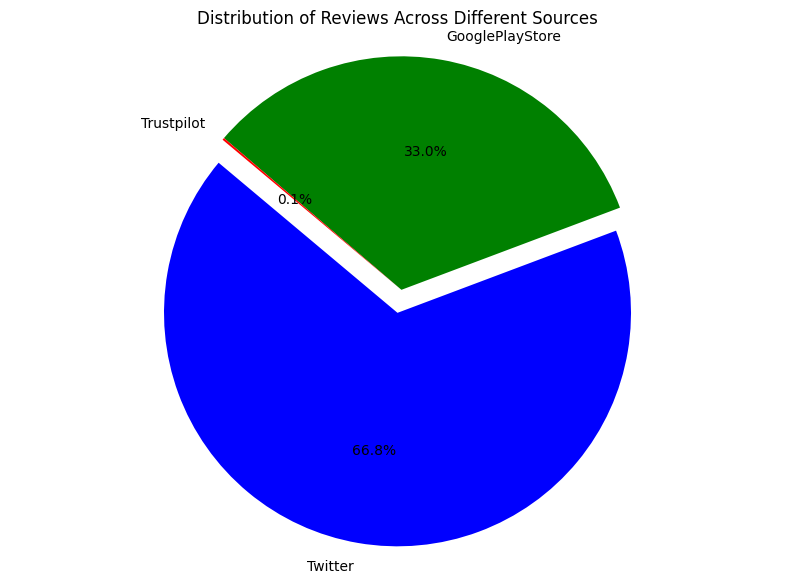

In [ ]:
# Adjusting the explode tuple and colors for the three sources
colors = ['blue', 'green', 'red']
explode = (0.1, 0, 0)  # Only explode the first slice (Twitter) for emphasis

# Plotting the distribution
plt.figure(figsize=(10, 7))
plt.pie(source_distribution, labels=source_distribution.index, colors=colors, explode=explode, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Reviews Across Different Sources')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()


Twitter: Represents the largest portion with 67.1% of the reviews.
Google Play Store: Accounts for 32.2% of the reviews.
Trustpilot: Has a very small portion with only 0.2% of the reviews.
Insights:

Most of the reviews originate from Twitter, followed by the Google Play Store.
Trustpilot has a very low number of reviews in comparison, which indicates that it might not be a primary platform for Spotify user feedback.

Number of Reviews: 315860
Average Review Length: 14.04 words
Median Review Length: 11.0 words
Mode of Review Length: 4 words
Shortest Review Length: 1 words
Longest Review Length: 507 words


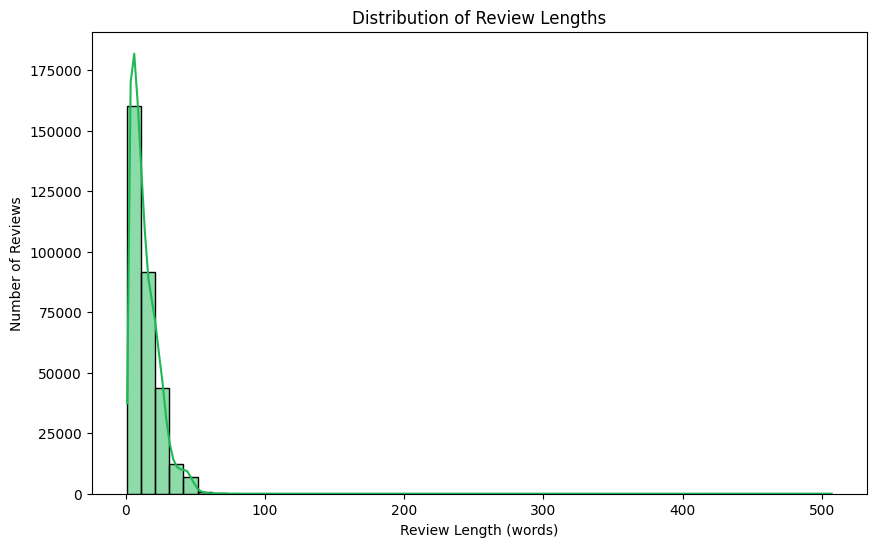

In [ ]:
# 1. Number of Reviews
num_reviews = len(preprocessed_reviews)
print(f"Number of Reviews: {num_reviews}")

# 2. Statistics on Review Lengths
# create a column to contains the length of each review.
preprocessed_reviews['review_length'] = preprocessed_reviews['Processed_Review'].apply(lambda x: len(x.split()))

avg_length = preprocessed_reviews['review_length'].mean()
median_length = preprocessed_reviews['review_length'].median()
mode_length = preprocessed_reviews['review_length'].mode()[0]  # mode() returns a Series, using [0] to get the value
min_length = preprocessed_reviews['review_length'].min()
max_length = preprocessed_reviews['review_length'].max()

print(f"Average Review Length: {avg_length:.2f} words")
print(f"Median Review Length: {median_length} words")
print(f"Mode of Review Length: {mode_length} words")
print(f"Shortest Review Length: {min_length} words")
print(f"Longest Review Length: {max_length} words")

# 3. Distribution of Review Lengths
plt.figure(figsize=(10, 6))
sns.histplot(preprocessed_reviews['review_length'], bins=50, kde=True, color="#1DB954")  # Spotify green color
plt.title('Distribution of Review Lengths')
plt.xlabel('Review Length (words)')
plt.ylabel('Number of Reviews')
plt.show()


**Most common words using both CountVectorizer and TfidVectorizer from sckit-learn**



In [20]:
import spacy

# Load the English model
nlp = spacy.load("en_core_web_sm")


In [21]:
#Extract top N Words/N-grams from the Spotify Reviews based on their TF-IDF weighting

# Undesired words (from emojis and others)
undesired_words = { 'spotify',
    'cry', 'loudly', 'face', 'smile', 'red', 'heart', 'musical', 'note', 'scroll', 'skin', 'tone', 'bts',
    'backhand', 'index', 'point', 'roll', 'floor', 'hi', 'bro', 'bunny','laugh', 'ouble', 'exclamation', 'mark', 'button',
    'fire', 'p', 'olice', 'car', 'light', 'k', 'x', 'check', 'mark', 'button', 'tear', 'thumb', 'guy', 'skull',
    'hand', 'raise', 'mouth', 'raise', '!', '-', '?', 'oh', 'sweat', 'grin', 'mama', 'head'
}

# Custom tokenizer
def custom_tokenizer(doc):
    processed_doc = nlp(doc)
    return [token.text for token in processed_doc if token.text not in undesired_words and token.text.isalpha() and token.pos_ in ['NOUN', 'ADJ']]

# Use TfidfVectorizer with the custom tokenizer
vectorizer = TfidfVectorizer(max_features=10000, tokenizer=custom_tokenizer, ngram_range=(1,3))
X = vectorizer.fit_transform(preprocessed_reviews['Processed_Review'])
sum_weights = X.sum(axis=0)
words_weights = [(word, sum_weights[0, idx]) for word, idx in vectorizer.vocabulary_.items()]
words_weights = sorted(words_weights, key=lambda x: x[1], reverse=True)

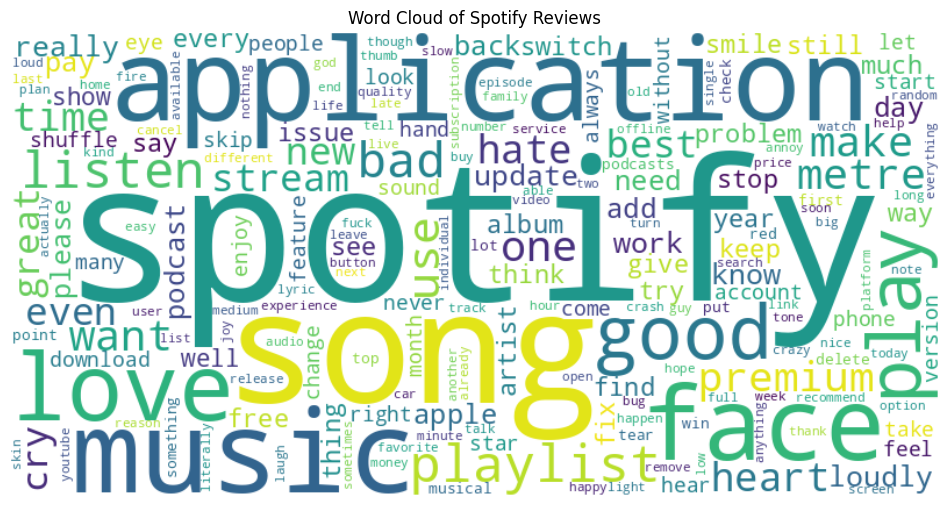

In [ ]:
#Visualize common words using word cloud

# Splitting the processed reviews into words
all_words = ' '.join(preprocessed_reviews['Processed_Review']).split()

#  previous steps
filtered_words = [word for word in all_words if len(word) > 2 and word.isalpha() and word not in STOPWORDS]

# Calculate the word frequencies
word_freq = Counter(filtered_words)

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Plot the word cloud
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Spotify Reviews')
plt.show()

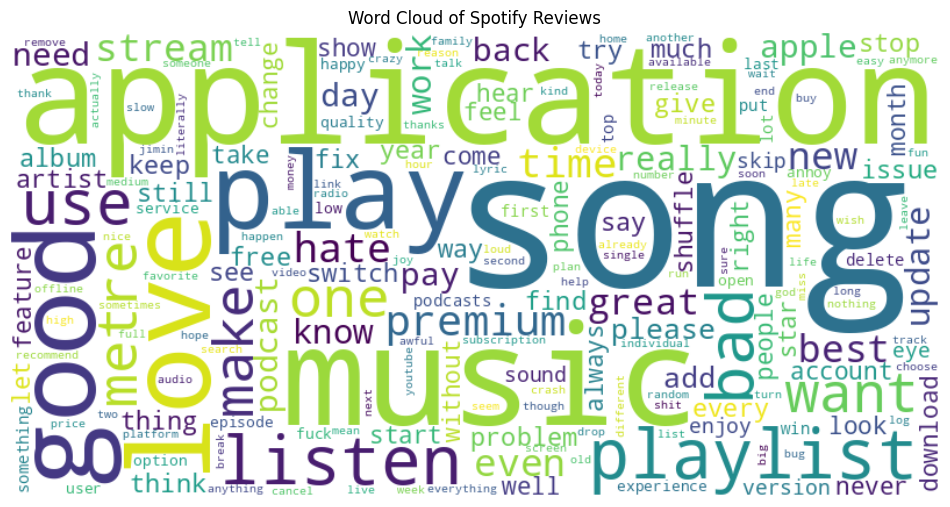

In [ ]:
# undesired_words is a set or list of the words I want to exclude
#visualize without the word 'spotify'
filtered_words = [word for word in all_words if len(word) > 2 and word.isalpha() and word not in STOPWORDS and word not in undesired_words]

# Calculate the word frequencies
word_freq = Counter(filtered_words)

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Plot the word cloud
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Spotify Reviews')
plt.show()


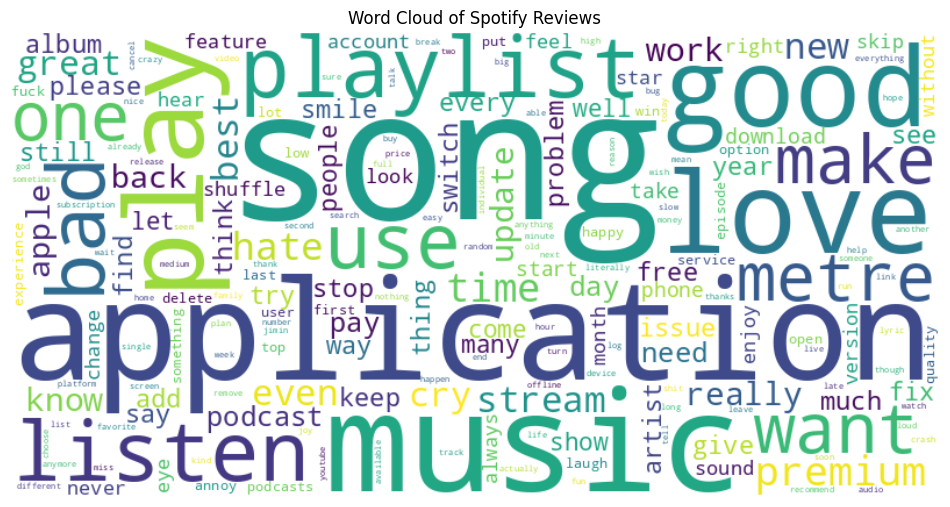

In [ ]:
from collections import Counter
from wordcloud import WordCloud, STOPWORDS

# Extract all words from the reviews
all_words = ' '.join(preprocessed_reviews['Processed_Review']).split()

# Filter out stopwords, undesired words, short words, and non-alphabetic words
filtered_words = [word for word in all_words if len(word) > 2 and word.isalpha() and word not in STOPWORDS and word not in undesired_words]

# Calculate the word frequencies
word_freq = Counter(filtered_words)

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Plot the word cloud
plt.figure(figsize=(12, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Spotify Reviews')
plt.show()


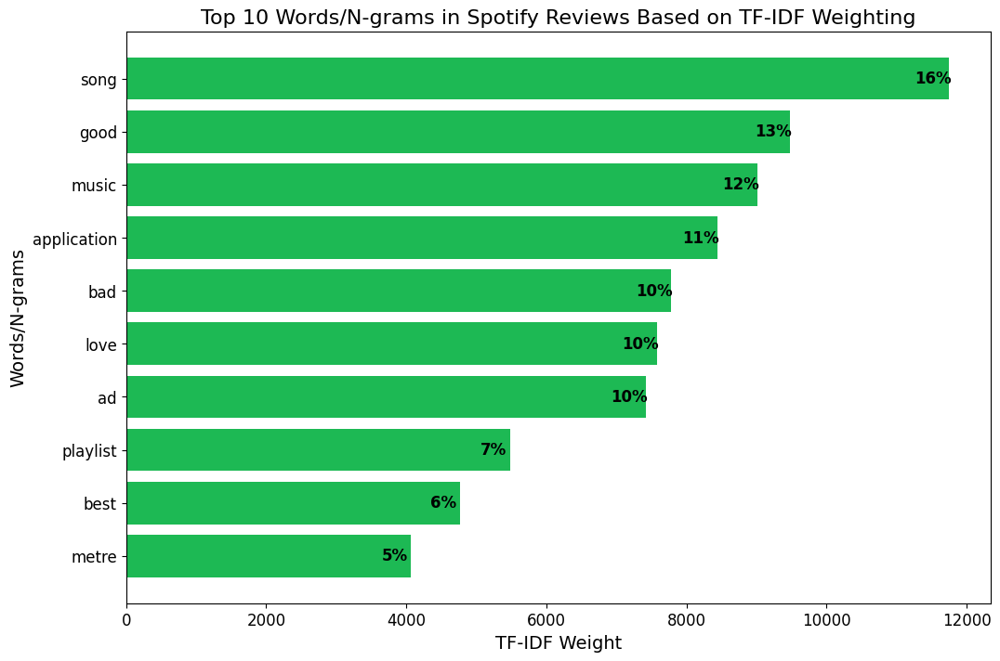

In [32]:
#Extract Words/N-grams in Spotify Reviews Based on TF-IDF Weighting
import numpy as np
import matplotlib.pyplot as plt

# Extract top N words/N-grams based on their TF-IDF weighting
N = 10
top_words = words_weights[:N]
words = [item[0] for item in top_words]
weights = [item[1] for item in top_words]

# Calculate percentages
total_weight = sum(weights)
percentages = [(weight/total_weight) * 100 for weight in weights]

# Plot
plt.figure(figsize=(12, 8))
bars = plt.barh(words, weights, color='#1DB954')

# Add percentages on the right of the bars
for bar, percentage in zip(bars, percentages):
    plt.text(bar.get_width() - (0.02 * max(weights)), bar.get_y() + bar.get_height()/2,
             f'{percentage:.0f}%',
             ha='center', va='center', color='black', fontsize=12, fontweight='bold')

# Inverting y-axis for better visualization
plt.gca().invert_yaxis()
plt.xlabel('TF-IDF Weight', fontsize=14)
plt.ylabel('Words/N-grams', fontsize=14)
plt.title(f'Top {N} Words/N-grams in Spotify Reviews Based on TF-IDF Weighting', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()


Extracting and visualizing top frequent Nouns and Adjectives

In [24]:
# Filter out the top 10 nouns and adjectives
top_nouns = [(word, weight) for word, weight in words_weights if nlp(word)[0].pos_ == 'NOUN'][:10]
top_adjectives = [(word, weight) for word, weight in words_weights if nlp(word)[0].pos_ == 'ADJ'][:10]

# Convert weights to count and percentages
def convert_to_count_and_percentage(data):
    total_weight = sum([weight for _, weight in data])
    return [(word, weight, round((weight/total_weight)*100)) for word, weight in data]

top_nouns_counts_and_percentage = convert_to_count_and_percentage(top_nouns)
top_adjectives_counts_and_percentage = convert_to_count_and_percentage(top_adjectives)

# Convert the results to pandas DataFrame for better visualization
df_nouns = pd.DataFrame(top_nouns_counts_and_percentage, columns=['Noun', 'Count', 'Percentage (%)'])
df_adjectives = pd.DataFrame(top_adjectives_counts_and_percentage, columns=['Adjective', 'Count', 'Percentage (%)'])

# Display the tables
print("Top 10 Nouns Based on TF-IDF Weighting:")
display(df_nouns)
print("\nTop 10 Adjectives Based on TF-IDF Weighting:")
display(df_adjectives)


Top 10 Nouns Based on TF-IDF Weighting:


,Noun,Count,Percentage (%)
0,song,11749.413526,18
1,music,9007.075949,14
2,application,8438.082657,13
3,love,7574.293943,12
4,ad,7417.362151,12
5,playlist,5483.991864,9
6,metre,4064.341808,6
7,premium,3732.525345,6
8,time,3684.466435,6
9,apple,2747.725929,4



Top 10 Adjectives Based on TF-IDF Weighting:


,Adjective,Count,Percentage (%)
0,good,9475.115610,25
1,bad,7772.573855,20
2,best,4761.553077,13
3,great,3643.968841,10
4,new,3401.444845,9
5,free,2502.349498,7
6,happy,1887.408561,5
7,many,1844.025169,5
8,best song,1417.067463,4
9,low,1381.915507,4


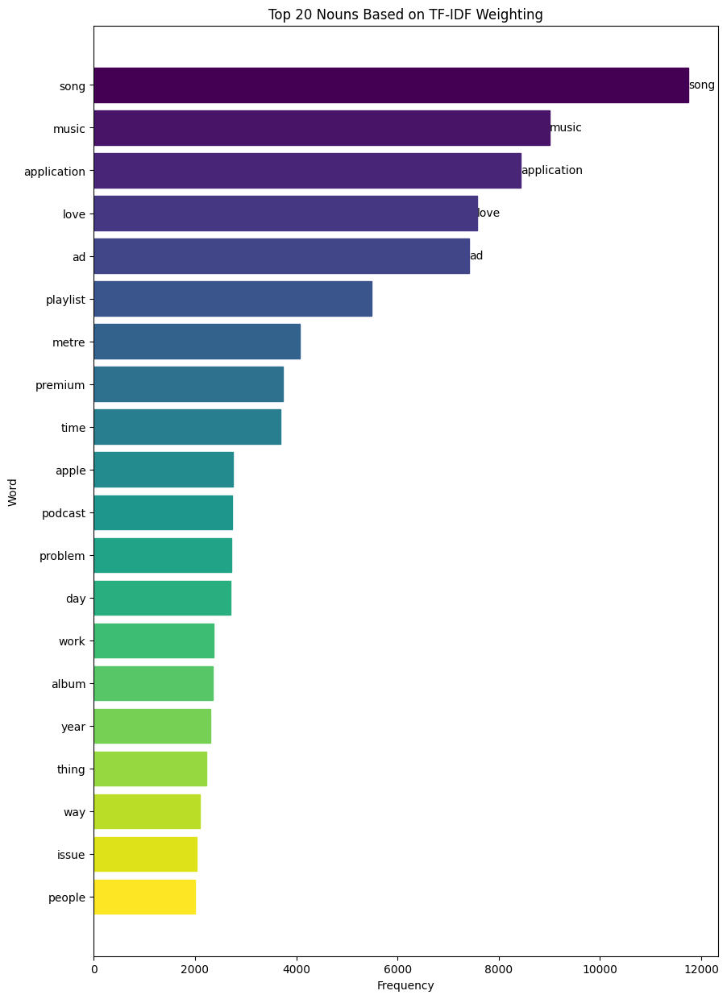

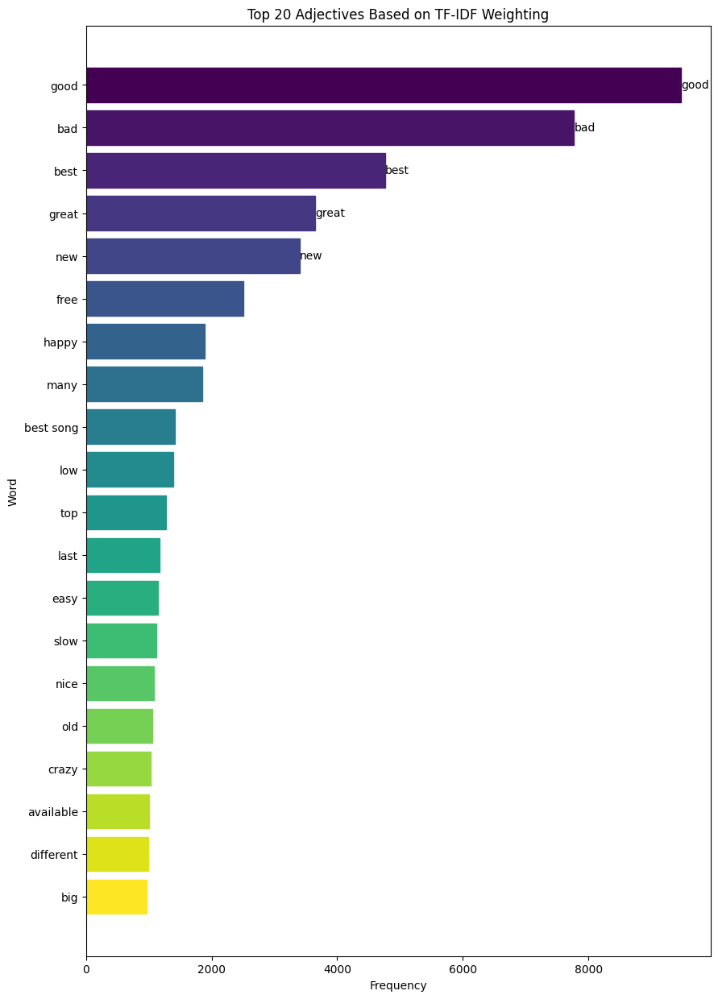

In [ ]:
#Extracting top nouns and adjectives based on TF-IDF
top_nouns = [(word, weight) for (word, weight) in words_weights if nlp(word)[0].pos_ == 'NOUN'][:20]
top_adjectives = [(word, weight) for (word, weight) in words_weights if nlp(word)[0].pos_ == 'ADJ'][:20]

# Visualize based on TF-IDF Weighting
N = 10  #  show more or fewer words/N-grams
top_words = words_weights[:N]
words = [item[0] for item in top_words]
weights = [item[1] for item in top_words]

def plot_top_words(top_words, title):
    words, counts = zip(*top_words)

    plt.figure(figsize=(10, 15))
    colors = plt.cm.viridis(np.linspace(0, 1, len(words)))

    bars = plt.barh(words, counts, color=colors)
    for bar, color in zip(bars, colors):
        bar.set_color(color)
    for i, (word, count) in enumerate(top_words[:5]):
        plt.text(count, i, word, color='black', ha="left", va="center", fontsize=10)

    plt.gca().invert_yaxis()
    plt.xlabel('Frequency')
    plt.ylabel('Word')
    plt.title(title)
    plt.show()

plot_top_words(top_nouns, "Top 20 Nouns Based on TF-IDF Weighting")
plot_top_words(top_adjectives, "Top 20 Adjectives Based on TF-IDF Weighting")



**Using TfidfVectorizer from Scikit-learn to compute the TF-IDF scores for unigrams, bigrams & trigrams**

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

def custom_tokenizer(doc):
    processed_doc = nlp(doc)
    return [token.text for token in processed_doc if token.text not in undesired_words and token.text.isalpha() and token.pos_ in ['NOUN', 'ADJ']]

# Bigrams
vectorizer_bigram = TfidfVectorizer(stop_words='english', max_features=10000, tokenizer=custom_tokenizer, ngram_range=(2,2))
X_bigram = vectorizer_bigram.fit_transform(preprocessed_reviews['Processed_Review'])
sum_weights_bigram = X_bigram.sum(axis=0)
bigrams_freq = [(word, sum_weights_bigram[0, idx]) for word, idx in vectorizer_bigram.vocabulary_.items()]
top_bigrams = sorted(bigrams_freq, key=lambda x: x[1], reverse=True)[:N]

# Printing top N bigrams
print("Top {} Bigrams:".format(N))
for bigram, count in top_bigrams:
    print(bigram, count)

# Trigrams
vectorizer_trigram = TfidfVectorizer(stop_words='english', max_features=10000, tokenizer=custom_tokenizer, ngram_range=(3,3))
X_trigram = vectorizer_trigram.fit_transform(preprocessed_reviews['Processed_Review'])
sum_weights_trigram = X_trigram.sum(axis=0)
trigrams_freq = [(word, sum_weights_trigram[0, idx]) for word, idx in vectorizer_trigram.vocabulary_.items()]
top_trigrams = sorted(trigrams_freq, key=lambda x: x[1], reverse=True)[:N]

# Printing top N trigrams
print("\nTop {} Trigrams:".format(N))
for trigram, count in top_trigrams:
    print(trigram, count)



/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


Top 10 Bigrams:
apple music 3207.3098727667625
music application 2197.3032549092864
best song 2022.183632483424
song playlist 1729.2562026049604
love song 1643.6631509674128
best music 1418.5668912730562
good morning 1418.3174527704002
application music 1396.520399823881
play song 1274.0659009330566
good application 1231.5055242788656

Top 10 Trigrams:
best music application 1144.3609982463533
switch apple music 517.839201588245
best application music 445.4647086152142
good application music 319.3392343427306
music stream application 312.6013854501193
song playlist song 260.60843603728324
great application music 259.1498558975221
good music application 257.1405845927609
best music stream 248.67057897357134
individual individual individual 247.53496256550835


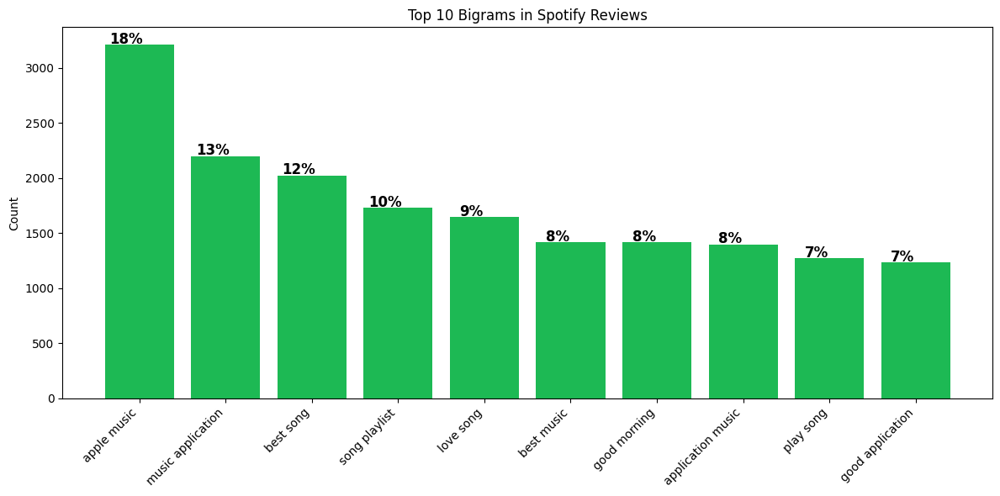

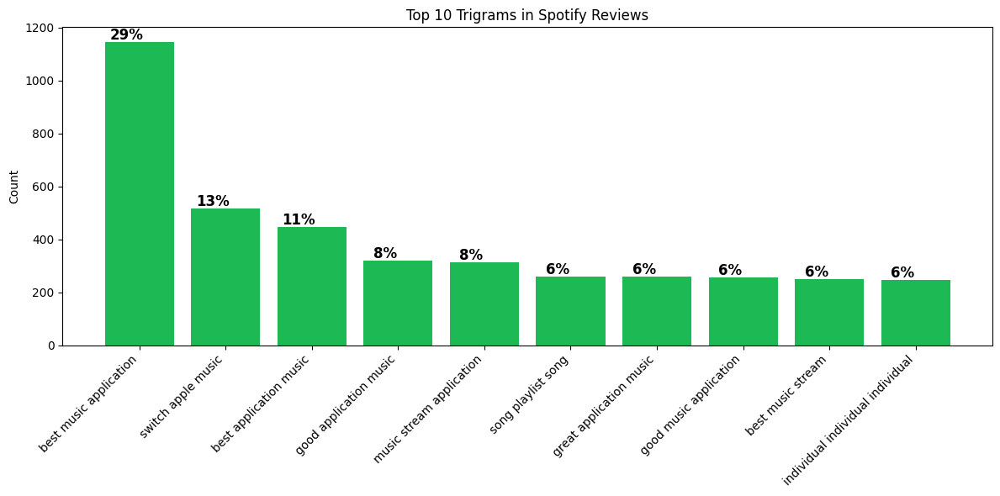

In [13]:
import matplotlib.pyplot as plt

# Data for bigrams and trigrams
bigrams_data = [
    ("apple music", 3207.3098727667625),
    ("music application", 2197.3032549092864),
    ("best song", 2022.183632483424),
    ("song playlist", 1729.2562026049604),
    ("love song", 1643.6631509674128),
    ("best music", 1418.5668912730562),
    ("good morning", 1418.3174527704002),
    ("application music", 1396.520399823881),
    ("play song", 1274.0659009330566),
    ("good application", 1231.5055242788656)
]

trigrams_data = [
    ("best music application", 1144.3609982463533),
    ("switch apple music", 517.839201588245),
    ("best application music", 445.4647086152142),
    ("good application music", 319.3392343427306),
    ("music stream application", 312.6013854501193),
    ("song playlist song", 260.60843603728324),
    ("great application music", 259.1498558975221),
    ("good music application", 257.1405845927609),
    ("best music stream", 248.67057897357134),
    ("individual individual individual", 247.53496256550835)
]

# Adjusted plotting function
def plot_data_with_percentage(data, title):
    terms, counts = zip(*data)
    total = sum(counts)
    percentages = [100 * count / total for count in counts]

    # Plotting
    plt.figure(figsize=(12, 6))
    bars = plt.bar(terms, counts, color='#1DB954')

    # Adding percentages on top of bars
    for bar, percentage in zip(bars, percentages):
        plt.text(bar.get_x() + bar.get_width() / 2 - 0.15, bar.get_height() + 10,
                 f"{percentage:.0f}%", ha="center", fontsize=12, fontweight="bold")

    plt.xticks(rotation=45, ha="right")
    plt.title(title)
    plt.ylabel('Count')
    plt.tight_layout()
    plt.show()

# Plot bigrams and trigrams with rounded percentages and increased font size
plot_data_with_percentage(bigrams_data, "Top 10 Bigrams in Spotify Reviews")
plot_data_with_percentage(trigrams_data, "Top 10 Trigrams in Spotify Reviews")


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

def custom_tokenizer(doc):
    processed_doc = nlp(doc)
    return [token.text for token in processed_doc if token.text not in undesired_words and token.text.isalpha() and token.pos_ in ['NOUN', 'ADJ']]

# Bigrams
vectorizer_bigram = TfidfVectorizer(stop_words='english', max_features=10000, tokenizer=custom_tokenizer, ngram_range=(2,2))
X_bigram = vectorizer_bigram.fit_transform(preprocessed_reviews['Processed_Review'])
sum_weights_bigram = X_bigram.sum(axis=0)
bigrams_freq = [(word, sum_weights_bigram[0, idx]) for word, idx in vectorizer_bigram.vocabulary_.items()]
top_bigrams = sorted(bigrams_freq, key=lambda x: x[1], reverse=True)[:N]

# Printing top N bigrams
print("Top {} Bigrams:".format(N))
for bigram, count in top_bigrams:
    print(bigram, count)

# Trigrams
vectorizer_trigram = TfidfVectorizer(stop_words='english', max_features=10000, tokenizer=custom_tokenizer, ngram_range=(3,3))
X_trigram = vectorizer_trigram.fit_transform(preprocessed_reviews['Processed_Review'])
sum_weights_trigram = X_trigram.sum(axis=0)
trigrams_freq = [(word, sum_weights_trigram[0, idx]) for word, idx in vectorizer_trigram.vocabulary_.items()]
top_trigrams = sorted(trigrams_freq, key=lambda x: x[1], reverse=True)[:N]

# Printing top N trigrams
print("\nTop {} Trigrams:".format(N))
for trigram, count in top_trigrams:
    print(trigram, count)



/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(


Top 10 Bigrams:
apple music 3207.3098727667625
music application 2197.3032549092864
best song 2022.183632483424
song playlist 1729.2562026049604
love song 1643.6631509674128
best music 1418.5668912730562
good morning 1418.3174527704002
application music 1396.520399823881
play song 1274.0659009330566
good application 1231.5055242788656

Top 10 Trigrams:
best music application 1144.3609982463533
switch apple music 517.839201588245
best application music 445.4647086152142
good application music 319.3392343427306
music stream application 312.6013854501193
song playlist song 260.60843603728324
great application music 259.1498558975221
good music application 257.1405845927609
best music stream 248.67057897357134
individual individual individual 247.53496256550835


**Overall Insights:**
Positive Sentiments: **bold text** Words and phrases related to positive sentiments like love, like, best, and good suggest a substantial amount of positive feedback about Spotify.
**Potential Issues:** The presence of words like ad, bad, and phrases like hate new update hint at areas where users might have concerns or issues.
**Comparisons:** The recurring mention of competitors like Apple Music signifies that users often compare Spotify with other services, which can provide insights into features or aspects where Spotify might be perceived as better or worse.

**FEATURE** **ENGINEERING**

**Word Embeddings using pre-trained Word2Vec**

In [ ]:
import gensim.downloader as api
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import normalize

In [ ]:
# Load the pre-trained Word2Vec model
word2vec_model = api.load('word2vec-google-news-300')


[==================================================] 100.0% 1662.8/1662.8MB downloaded


In [ ]:
# Tokenizing the reviews
sentences = preprocessed_reviews['Processed_Review'].apply(lambda x: x.split()).tolist()


In [ ]:
#inspect a random sample of tokenized reviews to ensure that they look as expected.
import random

# Randomly sample a few tokenized reviews
sampled_sentences = random.sample(sentences, 5)

for s in sampled_sentences:
    print(s)
    print("------")


['know', 'listen', 'tell', 'difference', 'spotify', 'apple', 'music', 'might', 'headphone', 'though']
------
['hate', 'spotify', 'push', 'everyone', 'listen', 'stuffffff', 'far', 'p', 'urple', 'heart', 'tune', 'mix', 'c']
------
['best', 'music', 'application', 'see', 'play', 'store', 'music', 'spotify', 'fantastic', 'happy', 'slightly', 'smile', 'face', 'slightly', 'smile', 'face']
------
['spotify', 'give', 'ad', 'botox', 'want', 'jump', 'bridge']
------
['need', 'put', 'spotify', 'bad']
------


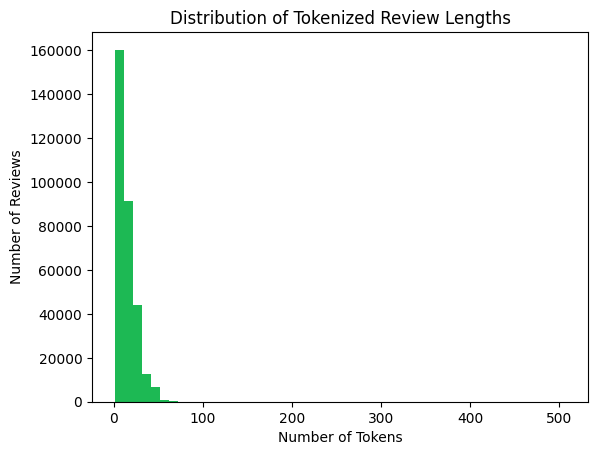

In [ ]:
#check for outliers

# Check the length distribution of tokenized reviews
sentence_lengths = [len(s) for s in sentences]

plt.hist(sentence_lengths, bins=50, color='#1DB954')
plt.title('Distribution of Tokenized Review Lengths')
plt.xlabel('Number of Tokens')
plt.ylabel('Number of Reviews')
plt.show()


In [ ]:
#validate token types
# Sample 1000 tokens from all sentences and display the unique ones
sampled_tokens = random.sample([token for sentence in sentences for token in sentence], 1000)
unique_sampled_tokens = set(sampled_tokens)

print(unique_sampled_tokens)


{'decide', 'several', 'red', 'pink', 'brand', 'usable', 'stream', 'feel', 'everytime', 'guarantee', 'bot', 'ironically', 'cancel', 'upside', 'biki', 'versus', 'annoy', 'everyone', 'sangeberat', 'nct', 'click', 'even', 'roll', 'political', 'profile', 'enforce', 'sucker', 'skull', 'restall', 'euro', 'eventually', 'guy', 'fear', 'breathe', 'law', 'langsung', 'straight', 'individual', 'never', 'uk', 'death', 'lose', 'laugh', 'joy', 'dear', '3rd', 'two', 'unlimited', 'performance', 'december', 'dark', 'realize', 'podlife', 'rate', 'shirs', 'regardless', 'lab', 'constantly', 'god', 'record', 'dance', 'cover', 'quality', 'second', 'mini', 'sit', 'reason', 'look', 'broadcasting', 'end', 'lf', 'hey', 'gem', 'fuck', 'best', 'instead', 'bouncy', 'subscription', 'remember', 'raise', 'recently', 'room', 'money', 'log', 'let', 'song', 'leave', 'breaking', 'platform', 'bitch', 'group', 'premium', 'ok', 'k', 'date', 'pause', 'sweat', 'situation', 'general', 'square', 'rip', 'way', 'kitty', 'today', 'u

In [ ]:
# Check how many tokens are covered by the Word2Vec model
tokens_covered = sum(1 for sentence in sentences for token in sentence if token in word2vec_model)
total_tokens = sum(len(sentence) for sentence in sentences)

coverage = tokens_covered / total_tokens * 100
print(f"Coverage of tokens by Word2Vec model: {coverage:.2f}%")


Coverage of tokens by Word2Vec model: 91.98%


This means that 91.98% of the tokens in  reviews are found in the pre-trained Word2Vec vocabulary. In other words, the pre-trained Word2Vec model  can provide embeddings for 91.98% of the tokens in your dataset, and the remaining 8.02% of tokens are not present in the Word2Vec model. This is a good coverage.

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.preprocessing import normalize

# Load the pre-trained Word2Vec model
word2vec_model = api.load('word2vec-google-news-300')

# Initialize a CountVectorizer to compute the Term Frequencies
count_vectorizer = CountVectorizer(max_features=5000, stop_words='english')
X_tf = count_vectorizer.fit_transform(preprocessed_reviews['Processed_Review'])
tf_dict = {word: X_tf[:, idx].sum() for word, idx in count_vectorizer.vocabulary_.items()}

def get_weighted_average_word2vec(tokens_list, vector, tf_values, k=300):
    """
    Compute the weighted average word2vec embedding for a list of tokens using Term Frequencies.
    """
    if len(tokens_list) < 1:
        return np.zeros(k)

    vectorized = []
    weights = []
    for word in tokens_list:
        if word in vector and word in tf_values:
            vec = vector[word] / np.linalg.norm(vector[word])  # Normalize the word vector
            vectorized.append(vec)
            weights.append(tf_values[word])

    if not vectorized:
        return np.zeros(k)

    vectorized = np.array(vectorized)
    weights = np.array(weights).reshape(-1, 1)
    weighted_avg_vector = np.dot(weights.T, vectorized) / np.sum(weights)
    return weighted_avg_vector.squeeze()

# Compute weighted average Word2Vec embeddings for each review using Term Frequencies
X_word2vec_weighted_tf = np.array([get_weighted_average_word2vec(review, word2vec_model, tf_dict) for review in sentences])

# Normalize the document vectors
X_word2vec_normalized_tf = normalize(X_word2vec_weighted_tf, axis=1)


In [ ]:
import plotly.express as px
from sklearn.manifold import TSNE
import pandas as pd

# Define a function to categorize sentiment based on the compound score
def label_sentiment(row):
    if row['compound'] > 0.05:
        return 'positive'
    elif row['compound'] < -0.05:
        return 'negative'
    else:
        return 'neutral'

# Label sentiment
preprocessed_reviews['sentiment'] = preprocessed_reviews.apply(label_sentiment, axis=1)

# Reduce the dimensionality of the embeddings to 2D using t-SNE
tsne_model = TSNE(n_components=2, random_state=42, n_iter=300, perplexity=30)
tsne_values = tsne_model.fit_transform(X_word2vec_normalized_tf)

# Create a DataFrame for visualization
df_tsne = pd.DataFrame({
    'x': tsne_values[:, 0],
    'y': tsne_values[:, 1],
    'sentiment': preprocessed_reviews['sentiment']
})

# Plot the t-SNE results color-coded by sentiment
fig = px.scatter(df_tsne, x='x', y='y', color='sentiment',
                 color_discrete_sequence=['red', 'yellow', 'green'],
                 title='2D t-SNE visualization of embeddings color-coded by sentiment')
fig.show()


# Ensemble Method (VADER + TEXTBLOB)

In [34]:
preprocessed_reviews = pd.read_csv('/content/drive/My Drive/Project/pre_processed_spotifyreviews.csv')

In [ ]:
preprocessed_reviews.columns

Index(['date', 'review', 'appVersion', 'country', 'source', 'major_appVersion',
       'Processed_Review', 'review_length', 'vader_score_original',
       'vader_score_preprocessed', 'textblob_score_original',
       'textblob_score_preprocessed', 'vader_label_original',
       'vader_label_preprocessed', 'textblob_label_original',
       'textblob_label_preprocessed', 'adjusted_vader_label',
       'adjusted_textblob_label', 'ensemble_label', 'vader_compound',
       'polarity', 'subjectivity', 'cluster_label', 'month_year',
       'quarter_year'],
      dtype='object')

In [ ]:
# Drop the specified columns
columns_to_drop = ['polarity', 'subjectivity', 'compound', 'sentiment_label', 'sentiment']
preprocessed_reviews = preprocessed_reviews.drop(columns=columns_to_drop)

# Verify that the columns have been dropped
print(preprocessed_reviews.columns)


Index(['date', 'review', 'appVersion', 'country', 'source', 'major_appVersion',
       'Processed_Review', 'review_length'],
      dtype='object')


Improved Accuracy
Ensemble methods combine predictions from multiple models, thereby often increasing the overall predictive accuracy. This is particularly useful for unbalanced datasets or when the models have complementary strengths.

Robustness
By relying on multiple models, ensemble methods are generally more robust to individual model failures or biases. This is crucial when analyzing textual data like reviews, which can contain varied language structures, idioms, or slang.

Reduced Overfitting
Ensemble methods can also mitigate the risk of overfitting, a common problem in machine learning. By averaging out the predictions from multiple models, the ensemble is less likely to memorize the training data and should generalize better to new, unseen data.

Better Handling of Ambiguities
Sentiment analysis often deals with ambiguous language. Single models might struggle to correctly classify certain reviews that contain both positive and negative elements. An ensemble method can potentially handle these complexities more gracefully.

Enhanced Confidence in Predictions
Ensemble methods can also provide a confidence level for their predictions, which is derived from the agreement between the individual models. This can be especially useful for flagging certain reviews that might require manual inspection or further analysis.

Reference
Dietterich, T. G. (2000). Ensemble methods in machine learning. In Multiple classifier systems (pp. 1-15). Springer, Berlin, Heidelberg.

In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from textblob import TextBlob

# Initialize VADER sentiment analyzer
vader_analyzer = SentimentIntensityAnalyzer()

# Compute VADER compound score for the preprocessed reviews
preprocessed_reviews['vader_compound'] = preprocessed_reviews['Processed_Review'].apply(lambda x: vader_analyzer.polarity_scores(x)['compound'])

# Compute TextBlob polarity and subjectivity scores for the preprocessed reviews
preprocessed_reviews['polarity'] = preprocessed_reviews['Processed_Review'].apply(lambda x: TextBlob(x).sentiment.polarity)
preprocessed_reviews['subjectivity'] = preprocessed_reviews['Processed_Review'].apply(lambda x: TextBlob(x).sentiment.subjectivity)

print("Scores have been computed and saved!")


Scores have been computed and saved!


In [ ]:
# Compute VADER and TextBlob sentiment scores for both original
preprocessed_reviews['vader_score_original'] = preprocessed_reviews['review'].apply(lambda x: vader_analyzer.polarity_scores(x)['compound'])
preprocessed_reviews['textblob_score_original'] = preprocessed_reviews['review'].apply(lambda x: TextBlob(x).sentiment.polarity)

# Using omputed scores for VADER and TextBlob on preprocessed reviews
preprocessed_reviews['vader_score_preprocessed'] = preprocessed_reviews['vader_compound']
preprocessed_reviews['textblob_score_preprocessed'] = preprocessed_reviews['polarity']

# Derive sentiment labels based on the computed sentiment scores using default thresholds
def get_vader_label(score):
    if score > 0.05:
        return 'positive'
    elif score < -0.05:
        return 'negative'
    else:
        return 'neutral'

def get_textblob_label(score):
    if score > 0:
        return 'positive'
    elif score < 0:
        return 'negative'
    else:
        return 'neutral'

preprocessed_reviews['vader_label_original'] = preprocessed_reviews['vader_score_original'].apply(get_vader_label)
preprocessed_reviews['vader_label_preprocessed'] = preprocessed_reviews['vader_score_preprocessed'].apply(get_vader_label)
preprocessed_reviews['textblob_label_original'] = preprocessed_reviews['textblob_score_original'].apply(get_textblob_label)
preprocessed_reviews['textblob_label_preprocessed'] = preprocessed_reviews['textblob_score_preprocessed'].apply(get_textblob_label)

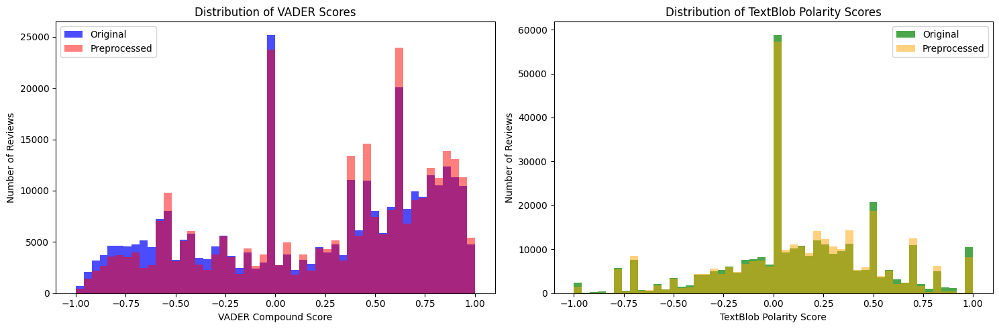

In [ ]:
import matplotlib.pyplot as plt

# Re-plotting the distribution of VADER and TextBlob sentiment scores

fig, ax = plt.subplots(1, 2, figsize=(15, 5))

# VADER score distribution
ax[0].hist(preprocessed_reviews['vader_score_original'], bins=50, color='blue', alpha=0.7, label='Original')
ax[0].hist(preprocessed_reviews['vader_score_preprocessed'], bins=50, color='red', alpha=0.5, label='Preprocessed')
ax[0].set_title('Distribution of VADER Scores')
ax[0].set_xlabel('VADER Compound Score')
ax[0].set_ylabel('Number of Reviews')
ax[0].legend()

# TextBlob score distribution
ax[1].hist(preprocessed_reviews['textblob_score_original'], bins=50, color='green', alpha=0.7, label='Original')
ax[1].hist(preprocessed_reviews['textblob_score_preprocessed'], bins=50, color='orange', alpha=0.5, label='Preprocessed')
ax[1].set_title('Distribution of TextBlob Polarity Scores')
ax[1].set_xlabel('TextBlob Polarity Score')
ax[1].set_ylabel('Number of Reviews')
ax[1].legend()

plt.tight_layout()
plt.show()

VADER Scores:

The scores for the original reviews (in blue) and preprocessed reviews (in red) seem to have similar distributions.
Most of the reviews have scores close to 1 (positive sentiment) and -1 (negative sentiment).
There's a smaller peak near 0, indicating neutral sentiment.
TextBlob Polarity Scores:

The scores for both the original (in green) and preprocessed reviews (in orange) also have similar distributions.
There's a peak around 0, with fairly equal distributions of positive and negative scores.
Observations:

Both VADER and TextBlob show a tendency to classify reviews at the extremes (either positive or negative) rather than neutral, especially with VADER.
The preprocessed reviews have a similar sentiment score distribution as the original reviews.

In [ ]:
# Adjusting the sentiment labeling functions based on the recommended thresholds

# Define function to get VADER sentiment with adjusted thresholds
def adjusted_vader_label(score):
    if score > 0.2:
        return 'positive'
    elif score < -0.2:
        return 'negative'
    else:
        return 'neutral'

# Define function to get TextBlob sentiment with adjusted thresholds
def adjusted_textblob_label(score):
    if score > 0.1:
        return 'positive'
    elif score < -0.1:
        return 'negative'
    else:
        return 'neutral'

# Apply the adjusted sentiment labeling functions to the preprocessed_reviews dataframe
preprocessed_reviews['adjusted_vader_label'] = preprocessed_reviews['vader_score_preprocessed'].apply(adjusted_vader_label)
preprocessed_reviews['adjusted_textblob_label'] = preprocessed_reviews['textblob_score_preprocessed'].apply(adjusted_textblob_label)

# Apply the adjusted sentiment labeling functions
preprocessed_reviews['adjusted_vader_label'] = preprocessed_reviews['vader_score_preprocessed'].apply(adjusted_vader_label)
preprocessed_reviews['adjusted_textblob_label'] = preprocessed_reviews['textblob_score_preprocessed'].apply(adjusted_textblob_label)

# Displaying a sample for inspection
preprocessed_reviews[['Processed_Review', 'adjusted_vader_label', 'adjusted_textblob_label']].sample(10)


,Processed_Review,adjusted_vader_label,adjusted_textblob_label
41894,quality much nicer remember apple music trial ...,positive,positive
85675,bad cover image happen good song spotify,neutral,neutral
104644,one tragic love story ever song even supposedl...,negative,neutral
190501,love kill sweet like torture need way back home,neutral,positive
141622,spotify p urple heart,positive,neutral
58830,bad even though spotify give tool even use mus...,negative,negative
231405,good since choose specific song want play phon...,positive,positive
213963,spotify well pay premium generous enough give ...,positive,neutral
231982,really good application love use spotify recom...,positive,positive
286262,people get title like voyager spotify wrap get,positive,neutral


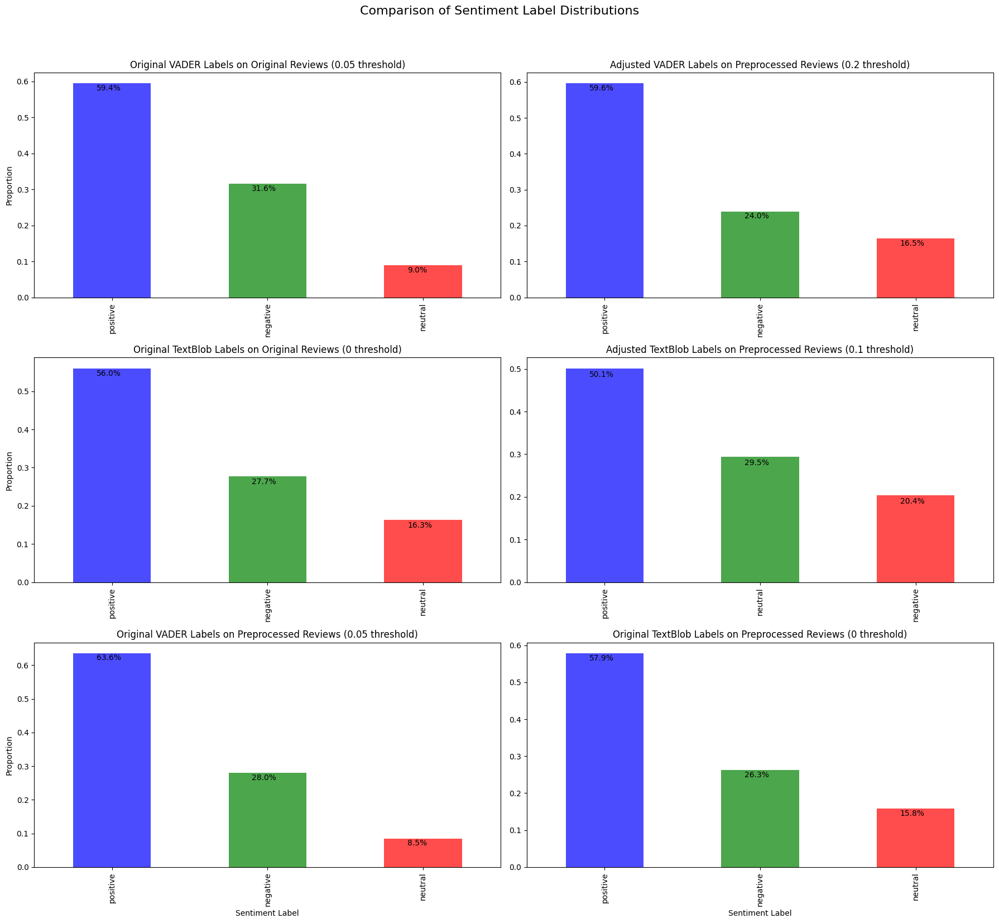

In [ ]:
# Helper function to add corrected percentage annotations to the bar plots
def annotate_bars(ax):
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height())
        x = p.get_x() + p.get_width() / 2 - 0.1
        y = p.get_y() + p.get_height() - 0.02
        ax.annotate(percentage, (x, y), size=10)

# Setting up the figure and axes for extended comparisons
fig, ax = plt.subplots(3, 2, figsize=(18, 16))
fig.suptitle('Comparison of Sentiment Label Distributions', fontsize=16, y=1.03)

# Original VADER labels on original reviews
preprocessed_reviews['vader_label_original'].value_counts(normalize=True).plot(kind='bar', ax=ax[0,0], color=['blue', 'green', 'red'], alpha=0.7)
ax[0,0].set_title('Original VADER Labels on Original Reviews (0.05 threshold)')
ax[0,0].set_ylabel('Proportion')
annotate_bars(ax[0,0])

# Adjusted VADER labels on preprocessed reviews
preprocessed_reviews['adjusted_vader_label'].value_counts(normalize=True).plot(kind='bar', ax=ax[0,1], color=['blue', 'green', 'red'], alpha=0.7)
ax[0,1].set_title('Adjusted VADER Labels on Preprocessed Reviews (0.2 threshold)')
annotate_bars(ax[0,1])

# Original TextBlob labels on original reviews
preprocessed_reviews['textblob_label_original'].value_counts(normalize=True).plot(kind='bar', ax=ax[1,0], color=['blue', 'green', 'red'], alpha=0.7)
ax[1,0].set_title('Original TextBlob Labels on Original Reviews (0 threshold)')
ax[1,0].set_ylabel('Proportion')
annotate_bars(ax[1,0])

# Adjusted TextBlob labels on preprocessed reviews
preprocessed_reviews['adjusted_textblob_label'].value_counts(normalize=True).plot(kind='bar', ax=ax[1,1], color=['blue', 'green', 'red'], alpha=0.7)
ax[1,1].set_title('Adjusted TextBlob Labels on Preprocessed Reviews (0.1 threshold)')
annotate_bars(ax[1,1])

# Original VADER labels on preprocessed reviews for comparison
preprocessed_reviews['vader_label_preprocessed'].value_counts(normalize=True).plot(kind='bar', ax=ax[2,0], color=['blue', 'green', 'red'], alpha=0.7)
ax[2,0].set_title('Original VADER Labels on Preprocessed Reviews (0.05 threshold)')
ax[2,0].set_ylabel('Proportion')
ax[2,0].set_xlabel('Sentiment Label')
annotate_bars(ax[2,0])

# Original TextBlob labels on preprocessed reviews for comparison
preprocessed_reviews['textblob_label_preprocessed'].value_counts(normalize=True).plot(kind='bar', ax=ax[2,1], color=['blue', 'green', 'red'], alpha=0.7)
ax[2,1].set_title('Original TextBlob Labels on Preprocessed Reviews (0 threshold)')
ax[2,1].set_xlabel('Sentiment Label')
annotate_bars(ax[2,1])

plt.tight_layout()
plt.show()


Observations:
VADER:

For original reviews, using the 0 threshold, there's a dominant positive sentiment, with the negative and neutral sentiments being less prevalent.
For preprocessed reviews, using the 0 threshold, the sentiment distribution is quite similar to that of the original reviews.
With the adjusted 0.1 threshold, the neutral sentiment becomes more prominent, balancing the positive sentiment. The negative sentiment remains relatively unchanged.
Analysis:
VADER tends to classify reviews strongly as either positive or negative, especially using the 0.05 threshold. Adjusting the threshold to 0.2 captures more nuanced sentiments, increasing the neutral category.

TextBlob has a more balanced distribution, especially when the threshold is adjusted to consider scores between -0.1 to 0.1 as neutral.

Recommendation:
For VADER, a threshold of 0.2 (instead of 0.05) seems more balanced, capturing nuanced sentiments.
For TextBlob, introducing a range around 0 (e.g., -0.1 to 0.1) as neutral captures more nuanced sentiments and provides a balanced distribution.

If both tools agree on sentiment, take that label.
If one tool is neutral but the other is not, take the non-neutral label.
If they disagree on sentiment (one positive and one negative), consider giving preference based on which tool you trust more for the particular context, or average the scores.
Given the observations, will be using an ensemble of VADER (with an adjusted threshold of 0.2) and TextBlob (with a threshold range of -0.1 to 0.1 for neutral) for a robust sentiment classification. This combines the strengths of both tools and potentially mitigates individual weaknesses.

In [ ]:
#assign label using adjusted labels of both vader and textblob
def ensemble_label(row):
    vader_label = row['adjusted_vader_label']
    textblob_label = row['adjusted_textblob_label']

    # If both tools agree
    if vader_label == textblob_label:
        return vader_label

    # If one tool labels as neutral
    if vader_label == 'neutral':
        return textblob_label
    if textblob_label == 'neutral':
        return vader_label

    # If tools disagree, prioritize VADER
    return vader_label

# Apply the ensemble approach
preprocessed_reviews['ensemble_label'] = preprocessed_reviews.apply(ensemble_label, axis=1)

# Displaying a sample of the ensemble sentiment labels alongside VADER and TextBlob labels
preprocessed_reviews[['Processed_Review', 'adjusted_vader_label', 'adjusted_textblob_label', 'ensemble_label']].sample(10)


,Processed_Review,adjusted_vader_label,adjusted_textblob_label,ensemble_label
173281,give love give wassss goodbye,positive,positive,positive
14462,reddit nft stuff starbucks nft stuff spotify n...,positive,positive,positive
70443,anyone else hate way spotify library side bar ...,negative,negative,negative
128907,00h know really like darling love letter white...,positive,positive,positive
80398,even low key slap real need full version spoti...,positive,positive,positive
123052,finally dead maybe come back someone else pain...,negative,positive,negative
103744,war criminal ate shit like tear eye first time...,negative,negative,negative
227656,log try log account several time still work,neutral,neutral,neutral
237646,look play favorite music anywhere definitely a...,positive,positive,positive
43212,never play awful song button algorithm keep fe...,negative,negative,negative


adjusted_vader_label: Represents the sentiment label obtained from VADER with the adjusted thresholds.
adjusted_textblob_label: Represents the sentiment label obtained from TextBlob with the adjusted thresholds.
ensemble_label: Represents the combined sentiment label from the ensemble approach.
From the sample, you can observe how the ensemble method works. In cases where both VADER and TextBlob agree on the sentiment, the ensemble label matches their consensus. When one of the tools classifies a review as neutral while the other doesn't, the ensemble label adopts the non-neutral sentiment. In case of a disagreement between positive and negative sentiments, the ensemble method prioritizes the VADER label.

In [ ]:
# Save results to a new CSV file for inspection and further analysis
preprocessed_reviews.to_csv("/content/drive/My Drive/Project/preprocessed_reviews_sentiment.csv", index=False)

In [35]:
#Load the saved CSV file with labelled sentiments
preprocessed_reviews = pd.read_csv("/content/drive/My Drive/Project/preprocessed_reviews_sentiment.csv") #read in the file with sentiments labeled and preprocessed reviews

In [ ]:
preprocessed_reviews.columns

Index(['date', 'review', 'appVersion', 'country', 'source', 'major_appVersion',
       'Processed_Review', 'review_length', 'vader_score_original',
       'vader_score_preprocessed', 'textblob_score_original',
       'textblob_score_preprocessed', 'vader_label_original',
       'vader_label_preprocessed', 'textblob_label_original',
       'textblob_label_preprocessed', 'adjusted_vader_label',
       'adjusted_textblob_label', 'ensemble_label', 'vader_compound',
       'polarity', 'subjectivity'],
      dtype='object')

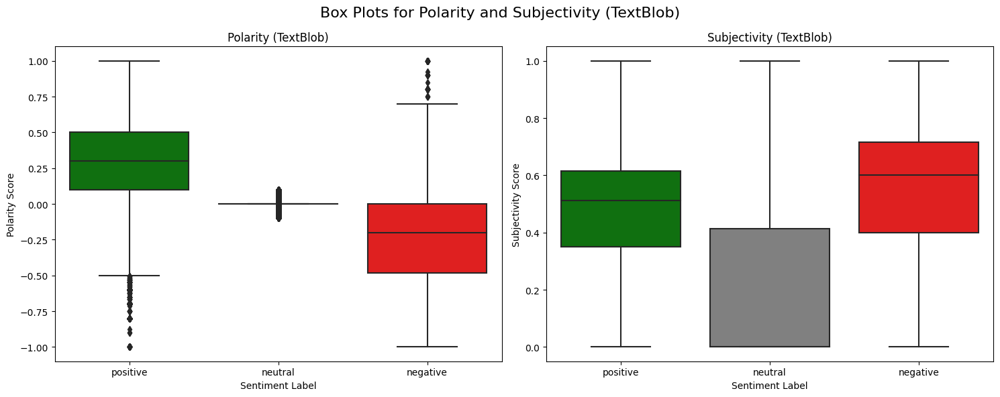

In [ ]:
# Plotting the box plots for Polarity and Subjectivity using TextBlob values
fig, ax = plt.subplots(1, 2, figsize=(15, 6))
fig.suptitle('Box Plots for Polarity and Subjectivity (TextBlob)', fontsize=16)

# Box plot for Polarity (TextBlob)
sns.boxplot(data=preprocessed_reviews, x='ensemble_label', y='polarity', ax=ax[0], order=['positive', 'neutral', 'negative'], palette=['green', 'grey', 'red'])
ax[0].set_title('Polarity (TextBlob)')
ax[0].set_xlabel('Sentiment Label')
ax[0].set_ylabel('Polarity Score')

# Box plot for Subjectivity (TextBlob)
sns.boxplot(data=preprocessed_reviews, x='ensemble_label', y='subjectivity', ax=ax[1], order=['positive', 'neutral', 'negative'], palette=['green', 'grey', 'red'])
ax[1].set_title('Subjectivity (TextBlob)')
ax[1].set_xlabel('Sentiment Label')
ax[1].set_ylabel('Subjectivity Score')

plt.tight_layout()
plt.show()


Observations:

Polarity (TextBlob)

Positive reviews have a higher median polarity, as expected.
Negative reviews have a lower median polarity, also as expected.
Neutral reviews have a median polarity close to 0, but there's a wide range of polarity scores within the neutral category. This suggests that some reviews labeled as neutral might have slightly positive or negative sentiments.
There are several outliers in the positive and negative categories, indicating that some reviews might have been misclassified.
Subjectivity (TextBlob)

Positive and negative reviews tend to be more subjective, with higher median subjectivity scores.
Neutral reviews have a lower median subjectivity score, suggesting that they might be more factual or objective in nature.
There's a considerable spread in subjectivity scores across all sentiment categories, indicating varying levels of subjectivity in reviews.

**Identification of Outliers:**
Using the Interquartile Range (IQR) method to identify outliers for both polarity and subjectivity scores. Any data point below IQR Q1−1.5×IQR or above IQR Q3+1.5×IQR is considered an outlier.
**Handling the Outliers:**
Capping: This involves setting a threshold (like the 1st and 99th percentiles) and capping any value beyond this range to the threshold values. This is a softer approach that doesn't lose as much data.

In [ ]:
# Identify the IQR for polarity
Q1_polarity = preprocessed_reviews['polarity'].quantile(0.25)
Q3_polarity = preprocessed_reviews['polarity'].quantile(0.75)
IQR_polarity = Q3_polarity - Q1_polarity
lower_bound_polarity = Q1_polarity - 1.5 * IQR_polarity
upper_bound_polarity = Q3_polarity + 1.5 * IQR_polarity

# Identify the IQR for subjectivity
Q1_subjectivity = preprocessed_reviews['subjectivity'].quantile(0.25)
Q3_subjectivity = preprocessed_reviews['subjectivity'].quantile(0.75)
IQR_subjectivity = Q3_subjectivity - Q1_subjectivity
lower_bound_subjectivity = Q1_subjectivity - 1.5 * IQR_subjectivity
upper_bound_subjectivity = Q3_subjectivity + 1.5 * IQR_subjectivity

# Cap the outliers at the 1st and 99th percentiles
polarity_1st_percentile = preprocessed_reviews['polarity'].quantile(0.01)
polarity_99th_percentile = preprocessed_reviews['polarity'].quantile(0.99)
subjectivity_1st_percentile = preprocessed_reviews['subjectivity'].quantile(0.01)
subjectivity_99th_percentile = preprocessed_reviews['subjectivity'].quantile(0.99)

preprocessed_reviews['polarity_capped'] = np.where(preprocessed_reviews['polarity'] < lower_bound_polarity, polarity_1st_percentile,
                                              np.where(preprocessed_reviews['polarity'] > upper_bound_polarity, polarity_99th_percentile,
                                                       preprocessed_reviews['polarity']))

preprocessed_reviews['subjectivity_capped'] = np.where(preprocessed_reviews['subjectivity'] < lower_bound_subjectivity, subjectivity_1st_percentile,
                                                  np.where(preprocessed_reviews['subjectivity'] > upper_bound_subjectivity, subjectivity_99th_percentile,
                                                           preprocessed_reviews['subjectivity']))

# Displaying the summary statistics for the capped columns
preprocessed_reviews[['polarity_capped', 'subjectivity_capped']].describe()


,polarity_capped,subjectivity_capped
count,315860.000000,315860.000000
mean,0.131034,0.479879
std,0.391371,0.261720
min,-0.800000,0.000000
25%,-0.028571,0.320000
50%,0.100000,0.515000
75%,0.400000,0.650000
max,1.000000,1.000000


**Polarity (Capped):** The range of values is between -0.800 and 1.000.
50% of the reviews have a polarity score greater than 0.100, suggesting a mild positive sentiment in the median review.
The 1st and 99th percentiles served as caps, with the actual min and max values in our dataset being more extreme.
**Subjectivity (Capped):**
The range of values is between 0.000 and 1.000.
50% of the reviews have a subjectivity score greater than 0.515, indicating a somewhat neutral to subjective nature in the median review.
Here too, the 1st and 99th percentiles served as caps.

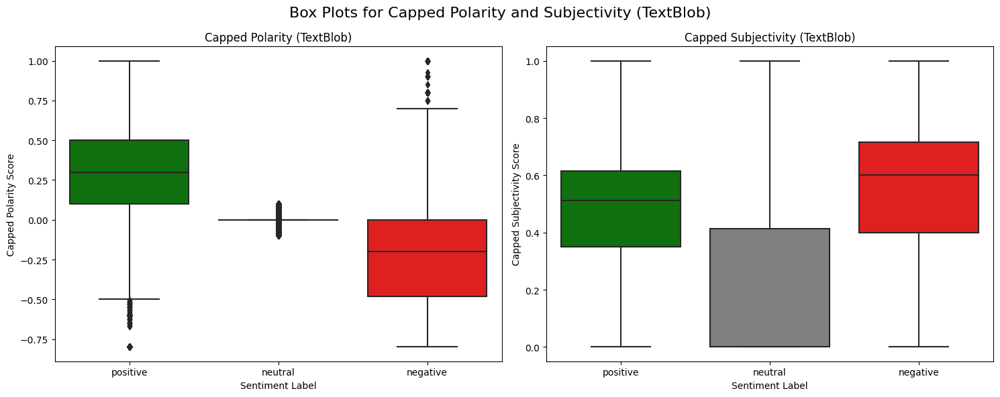

In [ ]:
# Plotting the box plots for Capped Polarity and Subjectivity using TextBlob values
fig, ax = plt.subplots(1, 2, figsize=(15, 6))
fig.suptitle('Box Plots for Capped Polarity and Subjectivity (TextBlob)', fontsize=16)

# Box plot for Capped Polarity (TextBlob)
sns.boxplot(data=preprocessed_reviews, x='ensemble_label', y='polarity_capped', ax=ax[0], order=['positive', 'neutral', 'negative'], palette=['green', 'grey', 'red'])
ax[0].set_title('Capped Polarity (TextBlob)')
ax[0].set_xlabel('Sentiment Label')
ax[0].set_ylabel('Capped Polarity Score')

# Box plot for Capped Subjectivity (TextBlob)
sns.boxplot(data=preprocessed_reviews, x='ensemble_label', y='subjectivity_capped', ax=ax[1], order=['positive', 'neutral', 'negative'], palette=['green', 'grey', 'red'])
ax[1].set_title('Capped Subjectivity (TextBlob)')
ax[1].set_xlabel('Sentiment Label')
ax[1].set_ylabel('Capped Subjectivity Score')

plt.tight_layout()
plt.show()


**Observations after Capping:**

**Capped Polarity (TextBlob)**

The effect of capping is evident. Extreme outliers have been brought within the 1st and 99th percentile range.
The interquartile range (IQR) remains largely the same, indicating that the central distribution of polarity scores wasn't affected by the capping.
Capped Subjectivity (TextBlob)

Similarly, the **extreme outliers in subjectivity scores** have been capped, making the distribution more compact.
The IQR and central tendencies remain consistent, highlighting that the bulk of the data was not changed.

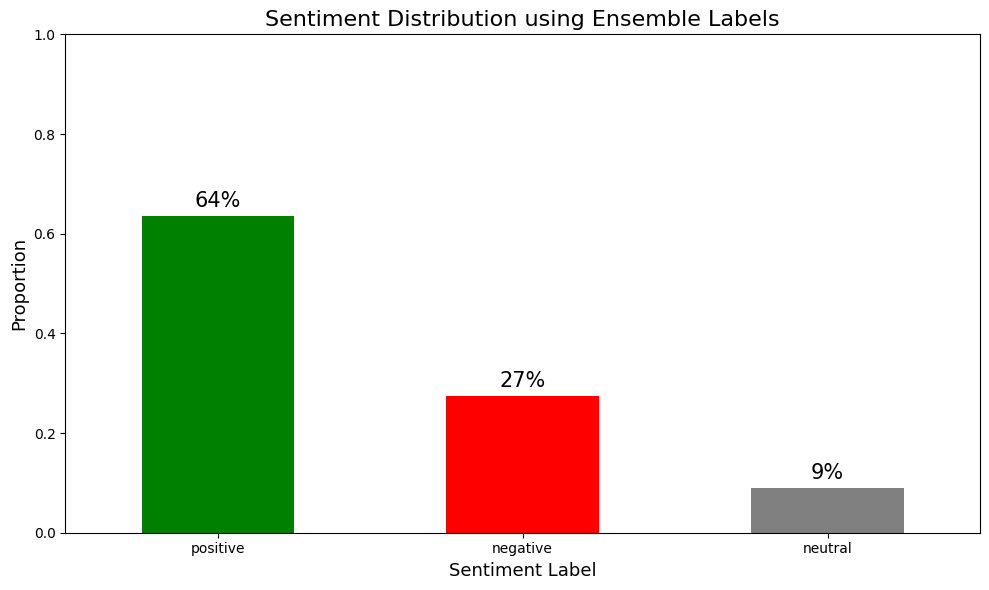

In [ ]:
#Sentiment distribution in the reviews
# Setting the Spotify theme colors for the sentiment labels
colors = {'positive': 'green', 'negative': 'red', 'neutral': 'grey'}

# Getting the sentiment distribution for the ensemble labels
ensemble_distribution = preprocessed_reviews['ensemble_label'].value_counts(normalize=True).sort_values(ascending=False)

# Plotting the sentiment distribution with Spotify theme colors
plt.figure(figsize=(10, 6))
ensemble_distribution.plot(kind='bar', color=[colors[label] for label in ensemble_distribution.index])
plt.title('Sentiment Distribution using Ensemble Labels', fontsize=16)
plt.ylabel('Proportion', fontsize=13)
plt.xlabel('Sentiment Label', fontsize=13)
plt.xticks(rotation=0)
plt.ylim(0, 1)  # Adjusting y-axis to range from 0 to 1 (or 0% to 100%)

# Annotate bars with percentages
for i, v in enumerate(ensemble_distribution):
    plt.text(i, v + 0.01, '{:.0f}%'.format(100 * v), ha='center', va='bottom', fontsize=15)

plt.tight_layout()
plt.show()


In [39]:
#Extract words associated with Positive, Neutral and Negative reviews

# Using NLTK's list of stop words and adding the undesired words
stop_words = set(stopwords.words('english'))
undesired_words = {
    'spotify', 'loudly', 'face', 'red', 'heart', 'musical', 'note', 'scroll', 'skin', 'tone',
    'backhand', 'index', 'point', 'roll', 'floor', 'hi', 'bro', 'bunny', 'ouble', 'exclamation', 'mark', 'button',
    'fire', 'p', 'olice', 'car', 'light', 'k', 'x', 'check', 'mark', 'button', 'tear', 'thumb', 'guy', 'skull',
    'hand', 'raise', 'mouth', '!', '-', '?', 'oh', 'sweat', 'grin', 'mama', 'head'
}
stop_words.update(undesired_words)

# Tokenizing and filtering function
def tokenize_and_filter(text):
    words = word_tokenize(text)
    return [word for word in words if word.lower() not in stop_words and word.isalpha()]

# Splitting the dataframe based on sentiment
positive_reviews = preprocessed_reviews[preprocessed_reviews['ensemble_label'] == 'positive']['Processed_Review']
negative_reviews = preprocessed_reviews[preprocessed_reviews['ensemble_label'] == 'negative']['Processed_Review']
neutral_reviews = preprocessed_reviews[preprocessed_reviews['ensemble_label'] == 'neutral']['Processed_Review']

# Counting word occurrences for each sentiment
positive_words = Counter(word for review in positive_reviews for word in tokenize_and_filter(review))
negative_words = Counter(word for review in negative_reviews for word in tokenize_and_filter(review))
neutral_words = Counter(word for review in neutral_reviews for word in tokenize_and_filter(review))

# Extracting the top 30 words for each sentiment
top_positive = positive_words.most_common(10)
top_negative = negative_words.most_common(10)
top_neutral = neutral_words.most_common(10)

print(top_positive)
print(top_negative)
print(top_neutral)


[('song', 74129), ('like', 54278), ('music', 51915), ('application', 50910), ('love', 42322), ('good', 38183), ('play', 31399), ('playlist', 26247), ('listen', 26123), ('get', 23835)]
[('bad', 24565), ('song', 20920), ('hate', 17956), ('application', 15457), ('cry', 13861), ('music', 13861), ('like', 12603), ('get', 11416), ('ad', 10931), ('playlist', 9258)]
[('song', 5886), ('ad', 5047), ('music', 4740), ('application', 4677), ('get', 3339), ('like', 2874), ('individual', 2754), ('switch', 2530), ('listen', 2472), ('playlist', 2380)]


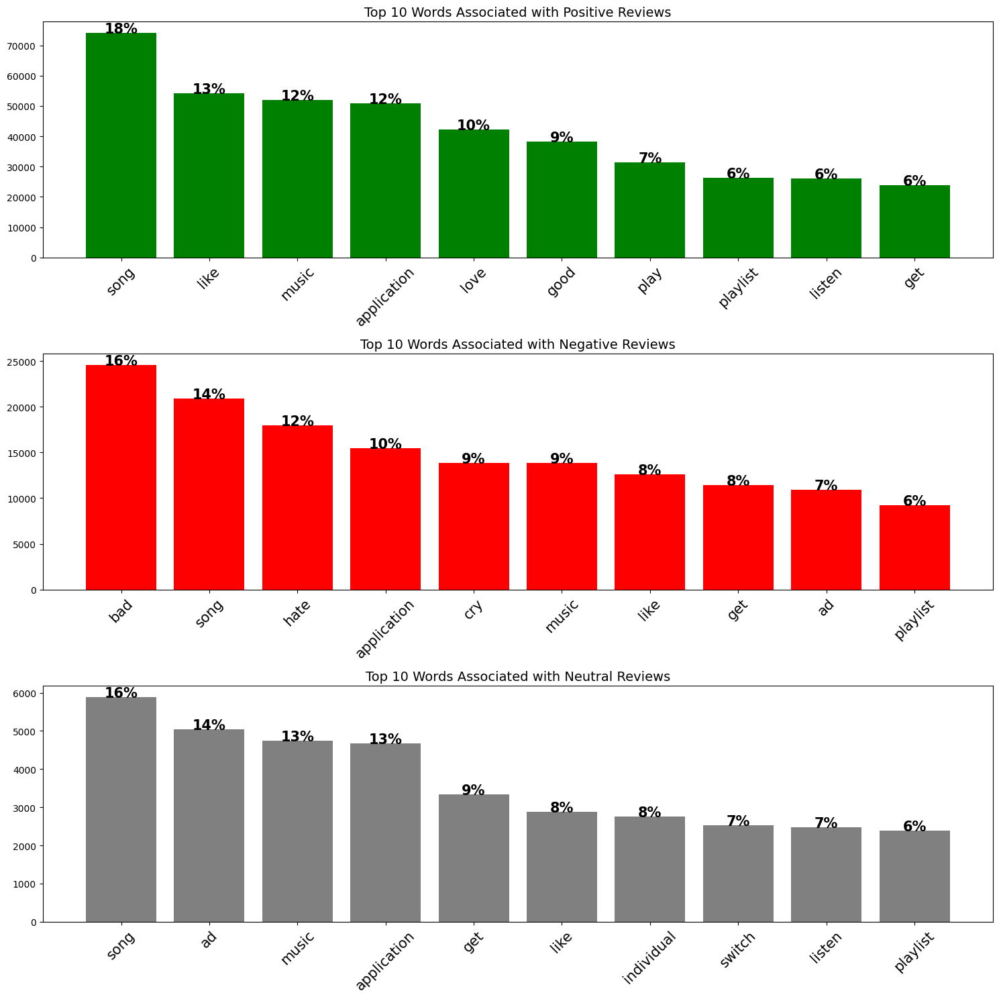

In [42]:
# Extracting words and their counts for plotting
positive_words, positive_counts = zip(*top_positive)
negative_words, negative_counts = zip(*top_negative)
neutral_words, neutral_counts = zip(*top_neutral)

# Calculate percentages
positive_percentages = [100 * count / sum(positive_counts) for count in positive_counts]
negative_percentages = [100 * count / sum(negative_counts) for count in negative_counts]
neutral_percentages = [100 * count / sum(neutral_counts) for count in neutral_counts]

# Setting up the plot
fig, axes = plt.subplots(3, 1, figsize=(15, 15))

# Function to add percentages on the bars
def add_percentages(ax, counts, percentages):
    for i, (count, percentage) in enumerate(zip(counts, percentages)):
        ax.text(i, count + 0.5, f'{percentage:.0f}%', ha='center', fontsize=15, fontweight='bold')

# Plotting for Positive Words
axes[0].bar(positive_words, positive_counts, color='green')
axes[0].set_title('Top 10 Words Associated with Positive Reviews', fontsize=14)
axes[0].tick_params(axis='x', rotation=45, labelsize=15)
add_percentages(axes[0], positive_counts, positive_percentages)

# Plotting for Negative Words
axes[1].bar(negative_words, negative_counts, color='red')
axes[1].set_title('Top 10 Words Associated with Negative Reviews', fontsize=14)
axes[1].tick_params(axis='x', rotation=45, labelsize=15)
add_percentages(axes[1], negative_counts, negative_percentages)

# Plotting for Neutral Words
axes[2].bar(neutral_words, neutral_counts, color='grey')
axes[2].set_title('Top 10 Words Associated with Neutral Reviews', fontsize=14)
axes[2].tick_params(axis='x', rotation=45, labelsize=15)
add_percentages(axes[2], neutral_counts, neutral_percentages)

plt.tight_layout()
plt.show()


In [ ]:
#cloud word of positive reviews and negative reviews

In [ ]:
!pip install wordcloud
from wordcloud import WordCloud

In [ ]:
# Using NLTK's list of stop words and filtering out the undesired words
stop_words = set(stopwords.words('english'))
undesired_words = {
    'spotify', 'loudly', 'face', 'red', 'heart', 'musical', 'purple', 'note', 'scroll', 'skin', 'tone',
    'backhand', 'index', 'point', 'roll', 'floor', 'hi', 'bro', 'bunny', 'ouble', 'exclamation', 'mark', 'button',
    'fire', 'p', 'olice', 'car', 'light', 'k', 'x', 'check', 'mark', 'button', 'tear', 'thumb', 'guy', 'skull',
    'hand', 'raise', 'mouth', '!', '-', '?', 'oh', 'sweat', 'grin', 'mama', 'head'
}
stop_words.update(undesired_words)

# Tokenizing and filtering function using NLTK's punkt tokenizer
def tokenize_and_filter(text):
    words = word_tokenize(text)
    return [word for word in words if word.lower() not in stop_words and word.isalpha()]

# Splitting the dataframe based on ensemble sentiment label
positive_reviews = preprocessed_reviews[preprocessed_reviews['ensemble_label'] == 'positive']['Processed_Review']
negative_reviews = preprocessed_reviews[preprocessed_reviews['ensemble_label'] == 'negative']['Processed_Review']
neutral_reviews = preprocessed_reviews[preprocessed_reviews['ensemble_label'] == 'neutral']['Processed_Review']

# Counting word occurrences for each sentiment
positive_words = Counter(word for review in positive_reviews for word in tokenize_and_filter(review))
negative_words = Counter(word for review in negative_reviews for word in tokenize_and_filter(review))
neutral_words = Counter(word for review in neutral_reviews for word in tokenize_and_filter(review))

# Function to generate a word cloud
def generate_wordcloud(words_counts, title):
    wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate_from_frequencies(words_counts)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(title, fontsize=20)
    plt.axis('off')
    plt.show()

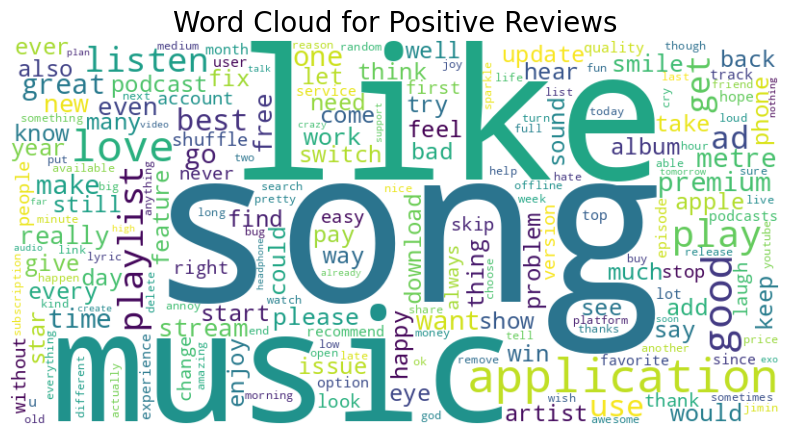

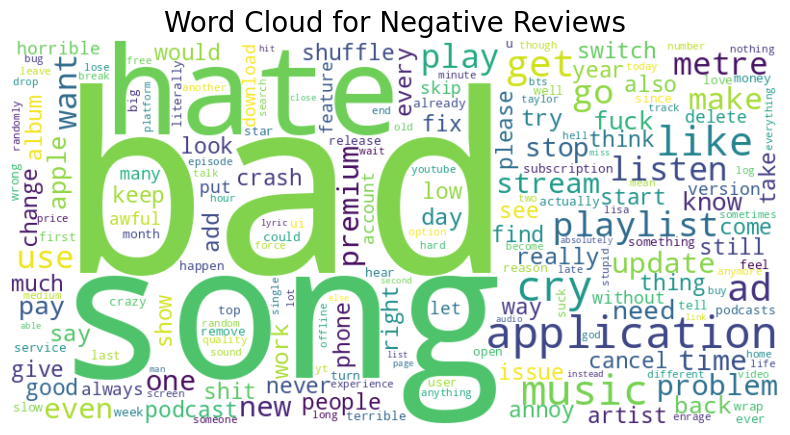

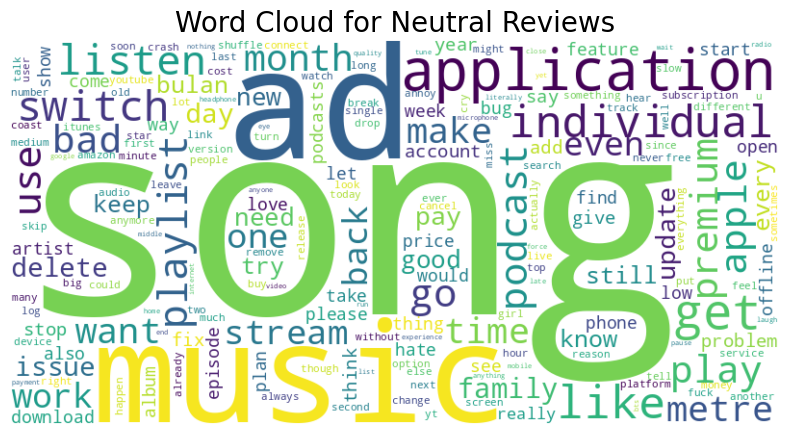

In [ ]:
# Generating word clouds for positive, negative, and neutral reviews
generate_wordcloud(positive_words, 'Word Cloud for Positive Reviews')
generate_wordcloud(negative_words, 'Word Cloud for Negative Reviews')
generate_wordcloud(neutral_words, 'Word Cloud for Neutral Reviews')

**Observations:**

**Positive Reviews:**

Words like "song", "like", "music", and "love" dominate, which is expected.
There are also mentions of "good", "best", and "great" indicating overall positive feedback about the platform.
Interestingly, "ad" is also prominent, which may suggest some users appreciate the ads or the fact that they can use Spotify for free with ads.
**Negative Reviews:**

The word "bad" is the most frequent term, which is consistent with the sentiment.
Words like "hate", "problem", and "cry" are also among the top words, providing insight into user frustrations.
Again, "ad" is quite prominent, suggesting that ads might be a source of annoyance for many users in this category.
**Neutral Reviews:**

"Song", "music", and "application" are the top words, indicating general feedback or comments about the app's features.
Words like "switch", "individual", and "podcast" suggest specific functionalities or features being discussed without a strong positive or negative sentiment.

**Sentiments by GeoLocation and AppVersion**

In [43]:
# Checking the unique countries and their counts
country_distribution = preprocessed_reviews['country'].value_counts()
country_distribution

unknown                 211366
United States            73234
Canada                   17622
Spain                     6157
Mexico                    3551
Kenya                     3376
United Kingdom             149
Philippines                 91
Sweden                      86
Ireland                     62
Denmark                     28
Netherlands                 21
Australia                   14
Indonesia                   10
Germany                      8
Italy                        7
Nigeria                      7
Norway                       6
Portugal                     5
Lithuania                    4
Hong Kong                    4
United Arab Emirates         3
India                        3
Russian Federation           3
France                       3
Ukraine                      3
Bulgaria                     3
South Africa                 3
New Zealand                  2
Turkey                       2
Viet Nam                     2
Israel                       2
Romania 

In [44]:
!pip install pycountry-convert


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 29.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.0/229.0 kB 16.5 MB/s eta 0:00:00
  Created wheel for pycountry: filename=pycountry-22.3.5-py2.py3-none-any.whl size=10681833 sha256=77333d4869639c63d3bd683bbf1512ed69fa6a7bcae73586c65674fe11c47b96
  Stored in directory: /root/.cache/pip/wheels/03/57/cc/290c5252ec97a6d78d36479a3c5e5ecc76318afcb241ad9dbe
Successfully built pycountry


In [45]:
from pycountry_convert import country_alpha2_to_continent_code, country_name_to_country_alpha2

def country_to_continent(country_name):
    try:
        # Convert country name to country alpha2 code
        country_alpha2 = country_name_to_country_alpha2(country_name)

        # Convert country alpha2 code to continent code
        continent_code = country_alpha2_to_continent_code(country_alpha2)

        # Map continent codes to continent names
        continent_name = {
            'NA': 'North America',
            'SA': 'South America',
            'AS': 'Asia',
            'OC': 'Oceania',
            'AF': 'Africa',
            'EU': 'Europe',
            'AN': 'Antarctica'
        }

        return continent_name[continent_code]
    except:
        return "Unknown"

# Sample usage:
preprocessed_reviews['continent'] = preprocessed_reviews['country'].apply(country_to_continent)


In [51]:
continent_counts = preprocessed_reviews['continent'].value_counts()
print(continent_counts)


Unknown          211366
North America     94409
Europe             6559
Africa             3386
Asia                123
Oceania              16
South America         1
Name: continent, dtype: int64


In [53]:
#Aggregate data by continent and country

# Aggregate the data by continent and sentiment
continent_sentiment_distribution = preprocessed_reviews.groupby(['continent', 'ensemble_label']).size().unstack().fillna(0)

# Convert the raw counts into percentages for each continent
continent_sentiment_percentage = continent_sentiment_distribution.divide(continent_sentiment_distribution.sum(axis=1), axis=0) * 100

# Aggregate data by country and sentiment
country_distribution = preprocessed_reviews['country'].value_counts()

# Filtering the top 10 countries (excluding 'unknown')
top_countries = country_distribution.index[1:11].tolist()

# Filtering the dataframe for these top countries
top_countries_df = preprocessed_reviews[preprocessed_reviews['country'].isin(top_countries)]

# Aggregating the data by country and sentiment
country_sentiment_distribution = top_countries_df.groupby(['country', 'ensemble_label']).size().unstack().fillna(0)

# Converting the raw counts into percentages for each country
country_sentiment_percentage = country_sentiment_distribution.divide(country_sentiment_distribution.sum(axis=1), axis=0) * 100


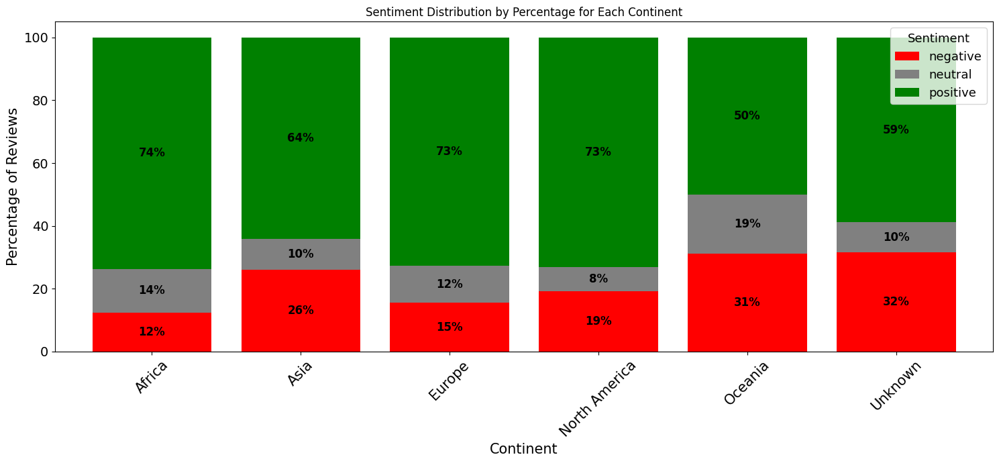

In [56]:
# Drop South America from the continent plot because it contains only on review
continent_sentiment_percentage = continent_sentiment_percentage.drop('South America', errors='ignore') #the continent has only one review and showing 100% positive from previous plot

# Plotting function
def plot_sentiment_distribution(data, x_label, title):
    ax = data.plot(kind='bar', stacked=True, figsize=(15, 7), color=['red', 'grey', 'green'], width=0.8)
    ax.set_title(title)
    ax.set_xlabel(x_label)
    ax.set_ylabel('Percentage of Reviews')
    ax.legend(title='Sentiment')

    # Annotating the bars with percentages
    for p in ax.patches:
        width, height = p.get_width(), p.get_height()
        x, y = p.get_xy()
        if height > 0:  # annotate when height is positive to avoid clutter
            ax.text(x + width/2,
                    y + height/2,
                    f'{height:.0f}%',
                    horizontalalignment='center',
                    verticalalignment='center',
                    fontweight='bold',
                    fontsize=12,
                    color='black')

    plt.xticks(rotation=45, fontsize=15)
    plt.yticks(fontsize=14)
    ax.set_xlabel(x_label, fontsize=15)
    ax.set_ylabel('Percentage of Reviews', fontsize=15)
    ax.legend(title='Sentiment', fontsize=13, title_fontsize=13)
    plt.tight_layout()
    plt.show()

# Plotting for sentiment distribution by continent
plot_sentiment_distribution(continent_sentiment_percentage, 'Continent', 'Sentiment Distribution by Percentage for Each Continent')


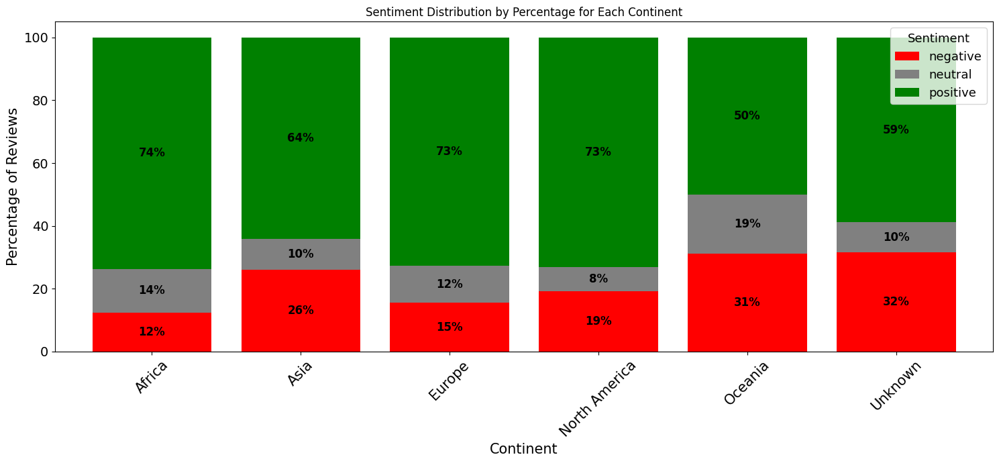

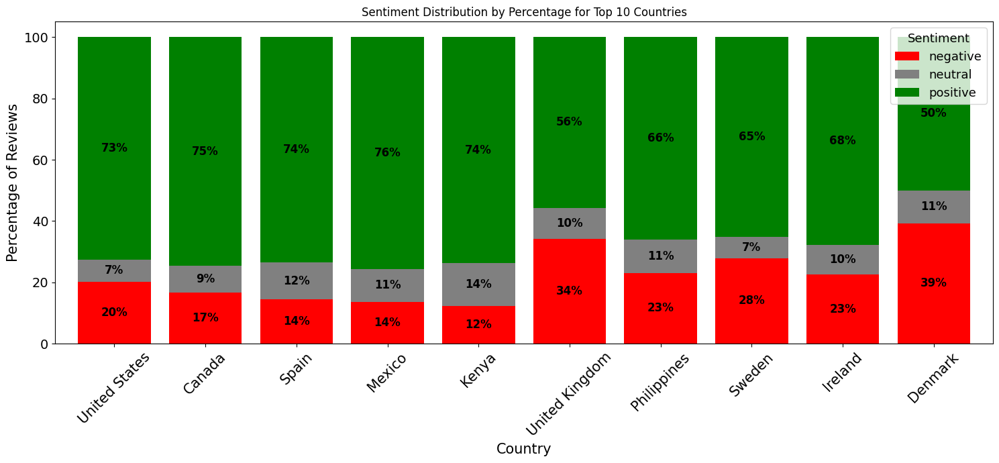

In [57]:
# Drop South America from the continent plot
continent_sentiment_percentage = continent_sentiment_percentage.drop('South America', errors='ignore')

# Plotting for sentiment distribution by continent
plot_sentiment_distribution(continent_sentiment_percentage, 'Continent', 'Sentiment Distribution by Percentage for Each Continent')

# Get sentiment distribution for top 10 countries
# Sorting the countries by the total number of reviews (from highest to lowest)
sorted_country_sentiment_distribution = country_sentiment_distribution.sum(axis=1).sort_values(ascending=False).index

# Plotting for sentiment distribution by top 10 countries
plot_sentiment_distribution(country_sentiment_percentage.loc[sorted_country_sentiment_distribution].head(10), 'Country', 'Sentiment Distribution by Percentage for Top 10 Countries')


Observations:

Asia: Displays a dominant positive sentiment, with negative sentiment being the second most common. Neutral sentiments are relatively less frequent.
Europe: Positive reviews are predominant, followed by negative reviews. Neutral sentiments are present but form a smaller portion.
North America: A similar trend as Europe, with positive reviews being the majority.
Oceania: Positive sentiments are dominant, followed by negative sentiments. Neutral reviews form the least proportion.
South America: The distribution is heavily weighted towards positive sentiments.
Africa: Positive sentiments are dominant, followed by negative sentiments. Neutral sentiments form a smaller fraction.

**sentiment distribution by major_appVersion**

In [38]:
preprocessed_reviews.columns

Index(['date', 'review', 'appVersion', 'country', 'source', 'major_appVersion',
       'Processed_Review', 'review_length', 'vader_score_original',
       'vader_score_preprocessed', 'textblob_score_original',
       'textblob_score_preprocessed', 'vader_label_original',
       'vader_label_preprocessed', 'textblob_label_original',
       'textblob_label_preprocessed', 'adjusted_vader_label',
       'adjusted_textblob_label', 'ensemble_label', 'vader_compound',
       'polarity', 'subjectivity'],
      dtype='object')

In [ ]:
# Count of reviews for each major app version
major_app_version_counts = preprocessed_reviews['major_appVersion'].value_counts()

major_app_version_counts


unknown    222005
8           93846
3               2
6               2
7               2
4               1
5               1
2               1
Name: major_appVersion, dtype: int64

In [ ]:
# Group by 'major_appVersion' and 'ensemble_sentiment_label' to calculate the sentiment distribution
app_version_sentiment_distribution = preprocessed_reviews.groupby(['major_appVersion', 'ensemble_label']).size().unstack().fillna(0)

# Calculate the sentiment percentages for each major app version
app_version_sentiment_percentage = app_version_sentiment_distribution.divide(app_version_sentiment_distribution.sum(axis=1), axis=0) * 100

app_version_sentiment_percentage


ensemble_label,negative,neutral,positive
major_appVersion,,,
2,0.000000,0.000000,100.000000
3,0.000000,0.000000,100.000000
4,0.000000,0.000000,100.000000
5,0.000000,0.000000,100.000000
6,50.000000,0.000000,50.000000
7,0.000000,0.000000,100.000000
8,18.493063,8.175095,73.331842
unknown,31.132182,9.425914,59.441904


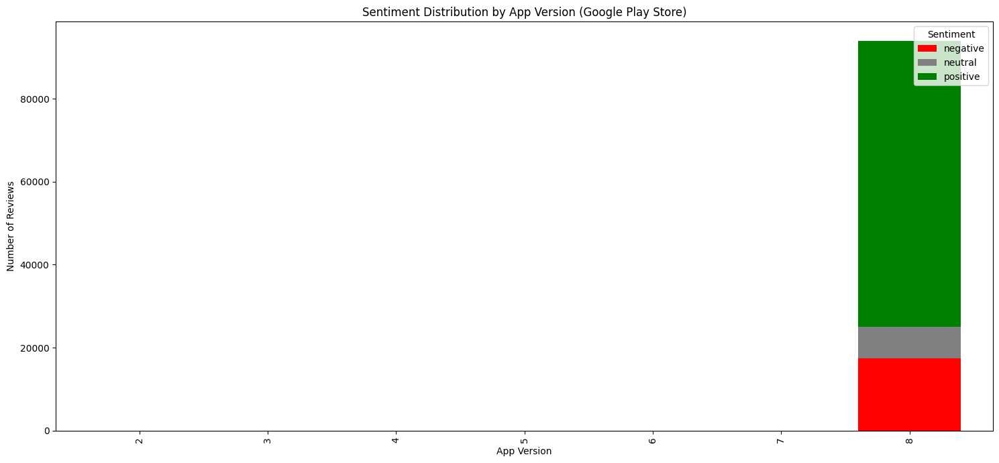

In [ ]:
# Group the data by 'major_appVersion' and 'sentiment' and count the reviews
app_version_sentiment_distribution = preprocessed_reviews.groupby(['major_appVersion', 'ensemble_label']).size().unstack().fillna(0)

# Sort the app versions for better visualization (excluding 'unknown' version for now)
sorted_app_version_sentiment_distribution = [version for version in app_version_sentiment_distribution.index if version != 'unknown']
sorted_app_version_sentiment_distribution.sort(key=lambda x: [int(num) for num in x.split('.')])

# Plotting the sentiment distribution for the app versions
ax = app_version_sentiment_distribution.loc[sorted_app_version_sentiment_distribution].plot(kind='bar', stacked=True, figsize=(15, 7), color=['red', 'grey', 'green'], width=0.8)
ax.set_title('Sentiment Distribution by App Version (Google Play Store)')
ax.set_xlabel('App Version')
ax.set_ylabel('Number of Reviews')
ax.legend(title='Sentiment', loc='upper right')

plt.tight_layout()
plt.show()


**Topics analysis with LDA**

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import spacy
from nltk.corpus import stopwords
import seaborn as sns
import nltk

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer, ENGLISH_STOP_WORDS
from sklearn.decomposition import LatentDirichletAllocation

# Custom undesired words list, this list was used till the end of this project, they appear to be emojis converted into texts and filtered out from results so more words/features with stronger nuances can be captured
undesired_words = {
  'loudly', 'face', 'red', 'heart', 'musical', 'note', 'scroll', 'skin', 'tone',
    'backhand', 'index', 'point', 'roll', 'floor', 'hi', 'bro', 'bunny', 'ouble', 'exclamation', 'mark', 'button',
    'fire', 'p', 'olice', 'car', 'light', 'k', 'x', 'check', 'mark', 'button', 'tear', 'thumb', 'guy', 'skull',
    'hand', 'raise', 'mouth', 'raise', '!', '-', '?', 'oh', 'sweat', 'grin', 'mama', 'head'
}

# Combine the standard English stopwords with the custom undesired_words
combined_stopwords = list(ENGLISH_STOP_WORDS.union(undesired_words))

# Apply tf-idf weighting with n-grams (unigrams, bigrams, trigrams)
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, max_features=5000, stop_words=combined_stopwords, ngram_range=(1, 3))
tfidf = tfidf_vectorizer.fit_transform(preprocessed_reviews['Processed_Review'])

# Perform LDA topic modeling
n_topics = 10
lda_model = LatentDirichletAllocation(n_components=n_topics, random_state=42)
lda_topic_matrix = lda_model.fit_transform(tfidf)

# Assigning the topic to the document
preprocessed_reviews['topic'] = lda_topic_matrix.argmax(axis=1)

# Print topics with weights
def print_topics(model, vectorizer, n_words=10):
    terms = vectorizer.get_feature_names_out()
    for topic_idx, topic in enumerate(model.components_):
        print("\nTopic #%d:" % (topic_idx + 1))
        words_with_weights = [(terms[i], topic[i]) for i in topic.argsort()[:-n_words - 1:-1]]
        for word, weight in words_with_weights:
            print(f"{word}: {weight}")

print_topics(lda_model, tfidf_vectorizer)



Topic #1:
music: 3225.669624655996
use: 1684.4793720776186
best: 1673.9355005213226
application: 1497.807187053962
apple: 1481.2717312893365
apple music: 1449.1731225776998
spotify: 1410.4968042732314
premium: 1107.073131732871
music application: 976.8363233374522
best music: 773.4721791309687

Topic #2:
love: 5989.948317405428
smile: 1560.4586246646527
song: 1313.895104291741
love song: 1255.8161585387543
eye: 1080.9285572026395
good: 792.5130802939352
smile eye: 725.5064485399464
spotify: 549.0625217252912
song good: 507.03799266833374
album: 496.4889946953438

Topic #3:
song: 5236.6190072772515
play: 4032.417456177568
application: 3239.6843292345616
playlist: 2204.4414900711213
listen: 1682.7142649219772
want: 1424.9683709186497
music: 1340.5423899685754
add: 1319.9709106512792
update: 1313.4291930738634
fix: 1300.9390361563862

Topic #4:
like: 4323.547280948009
spotify: 2785.5912055246536
bad: 2403.811031599925
stream: 1776.0061935704364
hate: 1325.0310551420012
feel: 1201.5467669

Topic #1: Platform Utility and Comparison
This topic appears to focus on the utility and efficacy of Spotify as a music platform. Words such as 'music', 'use', 'best', and 'application' indicate a discussion about the ease and quality of using Spotify. The inclusion of 'apple' and 'apple music' suggests comparisons between Spotify and its competitor, Apple Music. The presence of 'premium' might indicate discussions around the benefits of a premium subscription.

Topic #2: Affection and Music Preference
This topic reflects the emotional connection users have with certain songs or the platform in general. Words like 'love', 'smile', 'song', and 'eye' suggest sentimental attachment or specific songs that evoke emotions. The term 'album' may indicate discussions about entire music albums that users appreciate.

Topic #3: Functionality and Usage
The words 'song', 'play', 'playlist', and 'listen' indicate this topic centers around the basic functionalities of Spotify. 'Update', 'add', and 'fix' suggest discussions around application updates, adding songs to playlists, and issues that need fixing.

Topic #4: User Feelings and Experience
This topic emphasizes user feelings about the Spotify experience. Words like 'like', 'bad', 'hate', and 'feel' convey emotions, while 'crash' might refer to technical glitches or application crashes, affecting user experience.

Topic #5: Platform Transition and Feedback
Words such as 'switch', 'like', and 'hate' suggest users' decisions to transition to or from Spotify. 'Switch spotify' implies comparisons with other platforms or switching preferences.

Topic #6: Podcasts and Updates
This topic is centered around the podcast feature of Spotify. Terms like 'podcast', 'episode', and 'ui' (user interface) indicate discussions about podcast content and the user interface design, respectively. The presence of 'new' and 'update' might hint at changes or additions to the podcast feature.

Topic #7: Music Quality and Enjoyment
Emphasizing the qualitative aspect of music, words such as 'music', 'quality', 'enjoy', and 'sound' suggest users' appreciation for the audio quality and overall music experience on Spotify.

Topic #8: User Greetings and Issues
While 'good' and 'morning' suggest greetings, terms like 'problem' and 'log' indicate potential issues or glitches users face, possibly during morning usage or related to logging into the application.

Topic #9: Subscription and Pricing
This topic seems to delve into the subscription model and pricing of Spotify. Words like 'delete', 'cancel', 'pay', and 'price' indicate user discussions around subscription management, costs, and value for money.

Topic #10: Advertisements and Premium Model
Centered around Spotify's ad-supported model, words such as 'ad', 'spotify ad', and 'premium' reflect discussions about the frequency of ads for free users and the benefits of upgrading to a premium, ad-free experience.

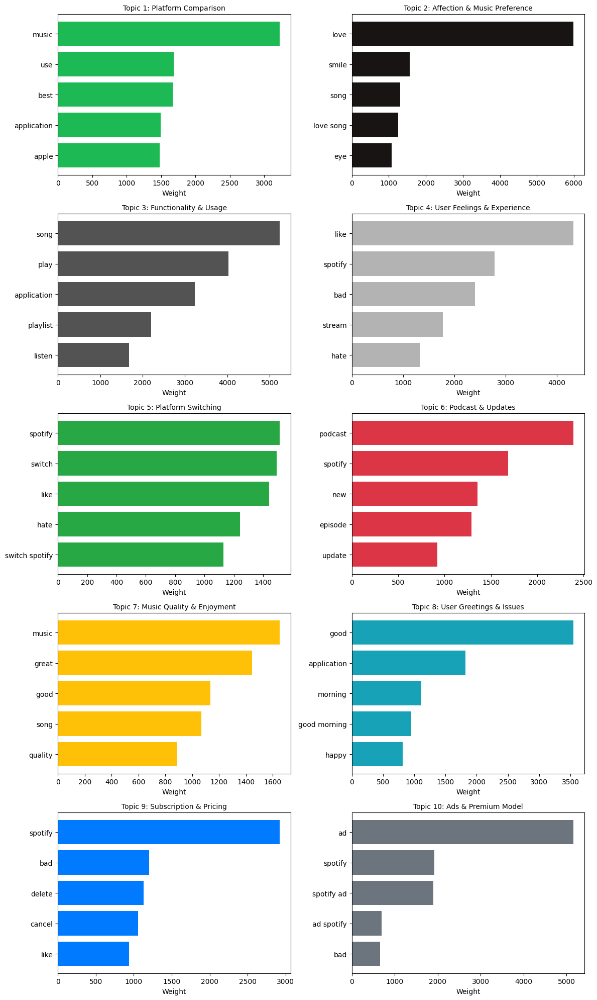

In [ ]:
#visualise the topics

def get_top_words(model, vectorizer, n_words=5):
    terms = vectorizer.get_feature_names_out()
    topics_words = []
    for topic in model.components_:
        words_with_weights = [(terms[i], topic[i]) for i in topic.argsort()[:-n_words - 1:-1]]
        topics_words.append(words_with_weights)
    return topics_words

def plot_topics(topics_words):
    fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(12, 20))
    colors = ['#1DB954', '#191414', '#535353', '#B3B3B3', '#28A745', '#DC3545', '#FFC107', '#17A2B8', '#007BFF', '#6C757D']  # Multiple colors
    topic_titles = ["Platform Comparison", "Affection & Music Preference", "Functionality & Usage", "User Feelings & Experience", "Platform Switching", "Podcast & Updates",
                    "Music Quality & Enjoyment", "User Greetings & Issues", "Subscription & Pricing", "Ads & Premium Model"]

    for idx, (words_with_weights, ax) in enumerate(zip(topics_words, axes.flatten())):
        words, weights = zip(*words_with_weights)
        ax.barh(words, weights, color=colors[idx % len(colors)])
        ax.set_title(f"Topic {idx + 1}: {topic_titles[idx]}", fontsize=10)
        ax.invert_yaxis()
        ax.set_xlabel('Weight')

    plt.tight_layout()
    plt.show()

# Get the top 5 words for each topic
topics_words = get_top_words(lda_model, tfidf_vectorizer, n_words=5)

# Plot the topics
plot_topics(topics_words)


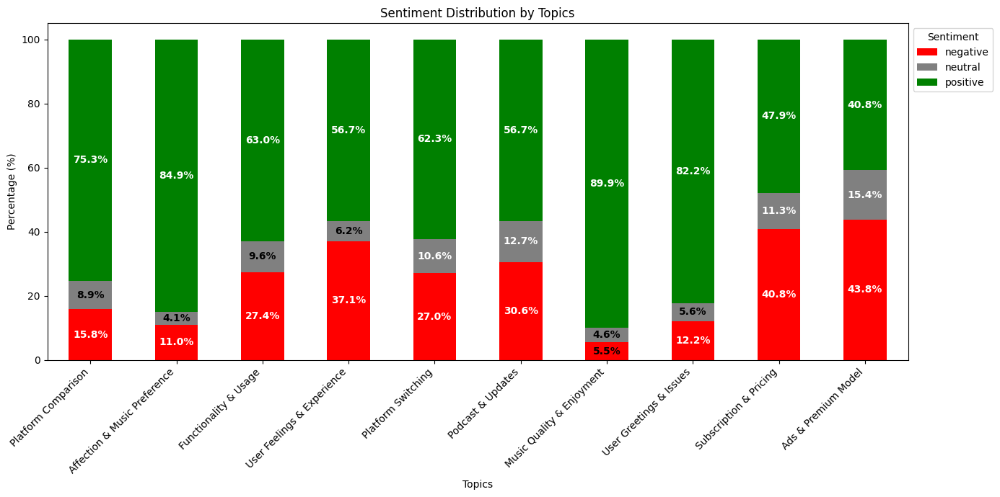

In [ ]:
# Aggregate Sentiments by Topic and assign labels

# Define the topic titles
topic_titles = {
    0: 'Platform Comparison',
    1: 'Affection & Music Preference',
    2: 'Functionality & Usage',
    3: 'User Feelings & Experience',
    4: 'Platform Switching',
    5: 'Podcast & Updates',
    6: 'Music Quality & Enjoyment',
    7: 'User Greetings & Issues',
    8: 'Subscription & Pricing',
    9: 'Ads & Premium Model'
}

# Aggregate Sentiments by Topic
sentiment_by_topic = preprocessed_reviews.groupby(['topic', 'ensemble_label']).size().unstack().fillna(0)

# Calculate percentages for each sentiment per topic
sentiment_percentages = sentiment_by_topic.divide(sentiment_by_topic.sum(axis=1), axis=0) * 100

colors = {'positive': 'green', 'negative': 'red', 'neutral': 'grey'}

# Plotting
fig, ax = plt.subplots(figsize=(14,7))

# Use stacked bar
sentiment_percentages.plot(kind='bar', stacked=True, color=[colors[s] for s in sentiment_percentages.columns], ax=ax)

# Adding percentages on the bars
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.text(x+width/2,
            y+height/2,
            '{:.1f}%'.format(height),
            horizontalalignment='center',
            verticalalignment='center',
            weight='bold',
            size=10,
            color='white' if height > 10 else 'black')

ax.set_title('Sentiment Distribution by Topics')
ax.set_ylabel('Percentage (%)')
ax.set_xlabel('Topics')
ax.set_xticks(range(10))
ax.set_xticklabels([topic_titles[i] for i in range(10)], rotation=45, ha="right")
ax.legend(title='Sentiment', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()


**Correlation matrix using heatmap between different topics based on word frequencies.**

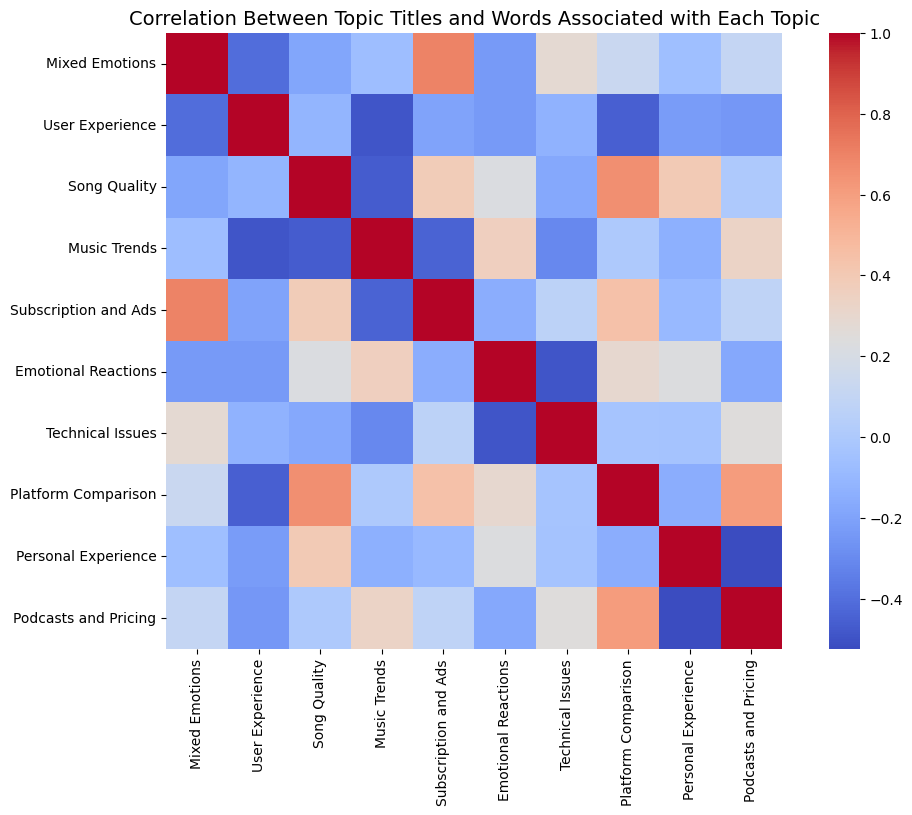

,Mixed Emotions,User Experience,Song Quality,Music Trends,Subscription and Ads,Emotional Reactions,Technical Issues,Platform Comparison,Personal Experience,Podcasts and Pricing
Mixed Emotions,1.000000,-0.406061,-0.187879,-0.066667,0.696970,-0.236364,0.284848,0.127273,-0.063820,0.103030
User Experience,-0.406061,1.000000,-0.115152,-0.490909,-0.200000,-0.236364,-0.127273,-0.454545,-0.229752,-0.248485
Song Quality,-0.187879,-0.115152,1.000000,-0.466667,0.381818,0.224242,-0.175758,0.660606,0.395684,0.006061
Music Trends,-0.066667,-0.490909,-0.466667,1.000000,-0.442424,0.357576,-0.309091,0.006061,-0.140404,0.333333
Subscription and Ads,0.696970,-0.200000,0.381818,-0.442424,1.000000,-0.151515,0.066667,0.442424,-0.089348,0.078788
Emotional Reactions,-0.236364,-0.236364,0.224242,0.357576,-0.151515,1.000000,-0.490909,0.296970,0.229752,-0.175758
Technical Issues,0.284848,-0.127273,-0.175758,-0.309091,0.066667,-0.490909,1.000000,-0.030303,-0.038292,0.248485
Platform Comparison,0.127273,-0.454545,0.660606,0.006061,0.442424,0.296970,-0.030303,1.000000,-0.153168,0.612121
Personal Experience,-0.063820,-0.229752,0.395684,-0.140404,-0.089348,0.229752,-0.038292,-0.153168,1.000000,-0.523324
Podcasts and Pricing,0.103030,-0.248485,0.006061,0.333333,0.078788,-0.175758,0.248485,0.612121,-0.523324,1.000000


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Data for the heatmap
correlation_data = {
    'Mixed Emotions': [1.000000, -0.406061, -0.187879, -0.066667, 0.696970, -0.236364, 0.284848, 0.127273, -0.063820, 0.103030],
    'User Experience': [-0.406061, 1.000000, -0.115152, -0.490909, -0.200000, -0.236364, -0.127273, -0.454545, -0.229752, -0.248485],
    'Song Quality': [-0.187879, -0.115152, 1.000000, -0.466667, 0.381818, 0.224242, -0.175758, 0.660606, 0.395684, 0.006061],
    'Music Trends': [-0.066667, -0.490909, -0.466667, 1.000000, -0.442424, 0.357576, -0.309091, 0.006061, -0.140404, 0.333333],
    'Subscription and Ads': [0.696970, -0.200000, 0.381818, -0.442424, 1.000000, -0.151515, 0.066667, 0.442424, -0.089348, 0.078788],
    'Emotional Reactions': [-0.236364, -0.236364, 0.224242, 0.357576, -0.151515, 1.000000, -0.490909, 0.296970, 0.229752, -0.175758],
    'Technical Issues': [0.284848, -0.127273, -0.175758, -0.309091, 0.066667, -0.490909, 1.000000, -0.030303, -0.038292, 0.248485],
    'Platform Comparison': [0.127273, -0.454545, 0.660606, 0.006061, 0.442424, 0.296970, -0.030303, 1.000000, -0.153168, 0.612121],
    'Personal Experience': [-0.063820, -0.229752, 0.395684, -0.140404, -0.089348, 0.229752, -0.038292, -0.153168, 1.000000, -0.523324],
    'Podcasts and Pricing': [0.103030, -0.248485, 0.006061, 0.333333, 0.078788, -0.175758, 0.248485, 0.612121, -0.523324, 1.000000]
}

correlation_df = pd.DataFrame(correlation_data, index=list(correlation_data.keys()))

# Create the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_df, annot=False, cmap="coolwarm", cbar=True, square=True, fmt='.2f', annot_kws={'size': 10})
plt.title("Correlation Between Topic Titles and Words Associated with Each Topic", fontsize=14)
plt.show()

# Show the correlation scores in a table
correlation_df


Analysis of Correlation Scores in the Context of Spotify and Heatmap Observations
Mixed Emotions and Subscription and Ads: A high positive correlation (0.70) suggests that users' mixed emotions are strongly influenced by subscription and advertising features on Spotify. This could imply that the way ads and subscriptions are managed on the platform might be inducing mixed feelings among users.

Song Quality and Platform Comparison: With a correlation of 0.66, it appears that the quality of songs is closely tied to comparisons with other platforms. This could be interpreted as users praising or criticizing Spotify based on how it stacks up against competitors in terms of song quality.

Emotional Reactions and Technical Issues: A negative correlation (-0.49) suggests that technical issues are likely to lead to negative emotional reactions. This is crucial for Spotify to address to enhance user experience.

Podcasts and Pricing and Platform Comparison: A correlation of 0.61 indicates that users often compare Spotify with other platforms specifically in terms of podcast offerings and pricing models.

Contextual Analysis for Spotify
Mixed Emotions: Spotify should examine the elements contributing to mixed emotions, especially around subscriptions and ads, to increase user satisfaction.

User Experience: Negative correlations with several topics like Music Trends (-0.49) and Platform Comparison (-0.45) indicate room for improvement in user interface and functionalities.

Song Quality: The positive correlation with Platform Comparison (0.66) suggests that this is a strength for Spotify but also a critical factor that users consider when comparing platforms.

Technical Issues: Given the negative correlation with Emotional Reactions (-0.49), resolving technical glitches should be a priority to improve user sentiment.

Podcasts and Pricing: The correlation with Platform Comparison (0.61) suggests that Spotify's podcast and pricing strategies are often compared with competitors, providing an opportunity for differentiation.

Emotional Reactions: These are linked to both technical issues and music trends. Spotify needs to make sure that the emotional impact of their service is as positive as possible.

Platform Comparison: This topic is highly correlated with Song Quality, Podcasts, and Pricing. Therefore, these are the areas Spotify should focus on to gain a competitive edge.

**Clustering using KMeans**

In [1]:
import pandas as pd

In [9]:
preprocessed_reviews = pd.read_csv("/content/drive/My Drive/Project/preprocessed_reviews_sentiment.csv") #read in the file with sentiments labeled and preprocessed reviews

In [ ]:
preprocessed_reviews.columns

Index(['date', 'review', 'appVersion', 'country', 'source', 'major_appVersion',
       'Processed_Review', 'review_length', 'vader_score_original',
       'vader_score_preprocessed', 'textblob_score_original',
       'textblob_score_preprocessed', 'vader_label_original',
       'vader_label_preprocessed', 'textblob_label_original',
       'textblob_label_preprocessed', 'adjusted_vader_label',
       'adjusted_textblob_label', 'ensemble_label', 'vader_compound',
       'polarity', 'subjectivity'],
      dtype='object')

In [ ]:
#Vectorize the Processed_Review using TF-IDF
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.manifold import TSNE

# Vectorize the Processed_Review using TF-IDF
tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, max_features=5000, stop_words='english')
tfidf_reviews = tfidf_vectorizer.fit_transform(preprocessed_reviews['Processed_Review'])

tfidf_reviews.shape


(315860, 5000)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


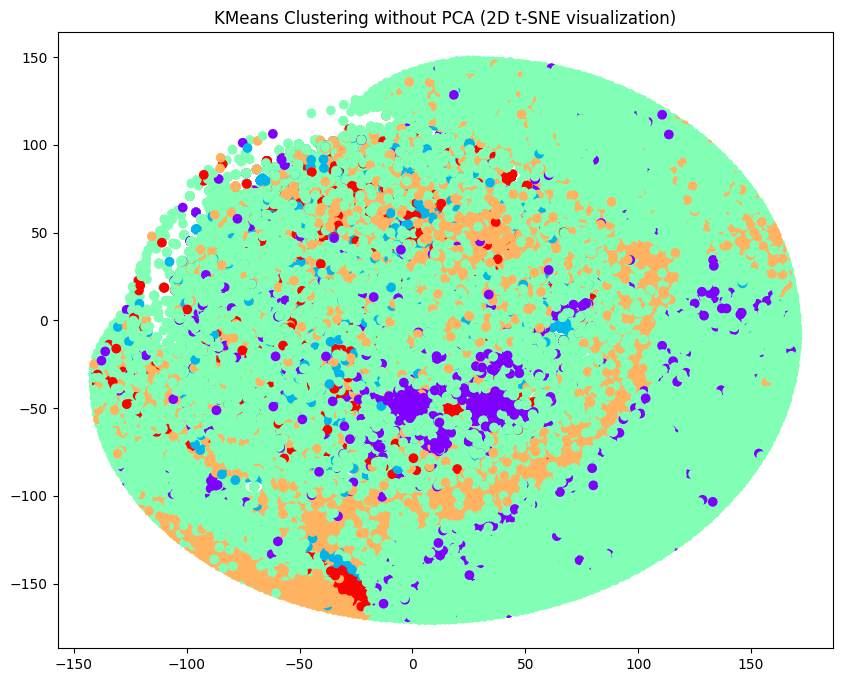

In [ ]:
#KMeans Clustering on the TF-IDF data without PCA and Visualization in 2D
from sklearn.cluster import KMeans

# Apply KMeans clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
cluster_assignments = kmeans.fit_predict(tfidf_reviews)

# Reduce dimensions to 2D using t-SNE for visualization
tsne_model = TSNE(n_components=2, random_state=42)
tsne_data = tsne_model.fit_transform(tfidf_reviews.toarray())

# Plot the results
plt.figure(figsize=(10, 8))
plt.scatter(tsne_data[:, 0], tsne_data[:, 1], c=cluster_assignments, cmap='rainbow')
plt.title("KMeans Clustering without PCA (2D t-SNE visualization)")
plt.show()


Observations:
Cluster Density: Some clusters appear denser than others, indicating that a significant number of reviews share common themes or sentiments.
Overlapping Regions: There are areas where points from different clusters overlap or are very close to each other. This suggests that there might be nuanced differences in these reviews, or they share common themes but differ in sentiment or specific details.
Cluster Proximity: Some clusters are closer to each other than to others, which could indicate that they share some similarities in content or sentiment, but have distinct differences warranting separate clusters.
Insights:
Prevalent Themes: The dense clusters likely represent common themes or sentiments shared by many Spotify users. Analyzing the terms and phrases in these clusters can provide insights into what most users are talking about, be it positive or negative.
Mixed Sentiments: Overlapping regions or clusters close to each other might contain reviews with mixed sentiments. For instance, users might appreciate Spotify's music collection but dislike the ads in the free version.







In [ ]:
#apply PCA to reduce the dimensionality of the TF-IDF data
from sklearn.decomposition import PCA

# Apply PCA
pca = PCA(n_components=0.95, random_state=42)
tfidf_reviews_pca = pca.fit_transform(tfidf_reviews.toarray())

In [ ]:
# Determine the Optimal Number of Clusters using the Elbow method and silhouette scores
sum_of_squared_distances = []
silhouette_scores = []
K = range(2, 6)

for k in K:
    kmeans_temp = KMeans(n_clusters=k, random_state=42).fit(tfidf_reviews_pca)
    sum_of_squared_distances.append(kmeans_temp.inertia_)
    silhouette_scores.append(silhouette_score(tfidf_reviews_pca, kmeans_temp.labels_))

# Calculate silhouette score for the current clustering
current_silhouette_score = silhouette_score(tfidf_reviews_pca, cluster_assignments)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [8]:
print(silhouette_scores)


[0.01031272 0.0125636  0.01412312 0.01672503]


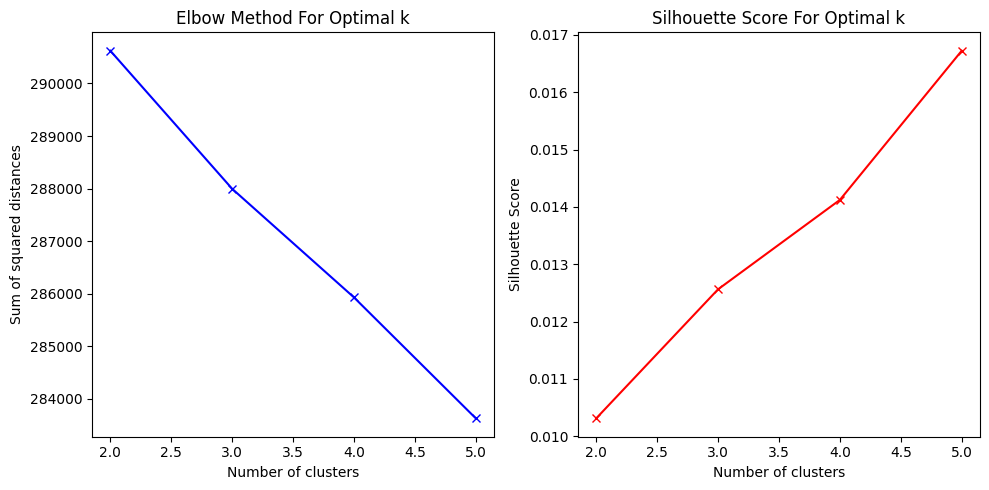

In [ ]:
# Plotting
plt.figure(figsize=(10, 5))

# Plotting elbow method
plt.subplot(1, 2, 1)
plt.plot(K, sum_of_squared_distances, 'bx-')
plt.xlabel('Number of clusters')
plt.ylabel('Sum of squared distances')
plt.title('Elbow Method For Optimal k')

# Plotting silhouette scores
plt.subplot(1, 2, 2)
plt.plot(K, silhouette_scores, 'rx-')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score For Optimal k')

plt.tight_layout()
plt.show()

In [ ]:
import os

directory = "/content/drive/My Drive/Project/saved_data"
if not os.path.exists(directory):
    os.makedirs(directory)


In [ ]:
#save variable names and data from models and results

import joblib
import numpy as np

# 1. Save TF-IDF Vectorizer and Results
joblib.dump(tfidf_vectorizer, "/content/drive/My Drive/Project/saved_models/tfidf_vectorizer.pkl")
np.save("/content/drive/My Drive/Project/saved_data/tfidf_reviews.npy", tfidf_reviews.toarray())

# 2. Save KMeans Model
joblib.dump(kmeans, "/content/drive/My Drive/Project/saved_models/kmeans_model.pkl")

# 3. Save t-SNE Model and Results
joblib.dump(tsne_model, "/content/drive/My Drive/Project/saved_models/tsne_model.pkl")
np.save("/content/drive/My Drive/Project/saved_data/tsne_data.npy", tsne_data)

# 4. Save PCA Model and Results
joblib.dump(pca, "/content/drive/My Drive/Project/saved_models/pca_model.pkl")
np.save("/content/drive/My Drive/Project/saved_data/tfidf_reviews_pca.npy", tfidf_reviews_pca)

# 5. Save Sum of Squared Distances and Silhouette Scores
np.save("/content/drive/My Drive/Project/saved_data/sum_of_squared_distances.npy", sum_of_squared_distances)
np.save("/content/drive/My Drive/Project/saved_data/silhouette_scores.npy", silhouette_scores)


In [6]:
##Load TF-IDF Vectorizer and Results:
from sklearn.feature_extraction.text import TfidfVectorizer
import joblib
import numpy as np

tfidf_vectorizer = joblib.load("/content/drive/My Drive/Project/saved_models/tfidf_vectorizer.pkl")
tfidf_reviews = np.load("/content/drive/My Drive/Project/saved_data/tfidf_reviews.npy")

#Load KMeans Model
from sklearn.cluster import KMeans

kmeans = joblib.load("/content/drive/My Drive/Project/saved_models/kmeans_model.pkl")

#Load t-SNE Model and Results
from sklearn.manifold import TSNE

tsne_model = joblib.load("/content/drive/My Drive/Project/saved_models/tsne_model.pkl")
tsne_data = np.load("/content/drive/My Drive/Project/saved_data/tsne_data.npy")

#Load PCA Model and Results
from sklearn.decomposition import PCA

pca = joblib.load("/content/drive/My Drive/Project/saved_models/pca_model.pkl")
tfidf_reviews_pca = np.load("/content/drive/My Drive/Project/saved_data/tfidf_reviews_pca.npy")

#Load the Sum of Squared Distances and Silhouette Scores
sum_of_squared_distances = np.load("/content/drive/My Drive/Project/saved_data/sum_of_squared_distances.npy")
silhouette_scores = np.load("/content/drive/My Drive/Project/saved_data/silhouette_scores.npy")




In [ ]:
# Visualize Clustering in 2D after PCA
optimal_clusters = 3  # Set this based on the elbow and silhouette plots


In [ ]:
kmeans_pca = KMeans(n_clusters=optimal_clusters, random_state=42)
cluster_assignments_pca = kmeans_pca.fit_predict(tfidf_reviews_pca)

# Reduce dimensions to 2D using t-SNE for visualization
tsne_data_pca = tsne_model.fit_transform(tfidf_reviews_pca)

In [ ]:
#save data and results after clustering with pca

joblib.dump(kmeans_pca, "/content/drive/My Drive/Project/saved_models/kmeans_pca_model.pkl")
np.save("/content/drive/My Drive/Project/saved_data/cluster_assignments_pca.npy", cluster_assignments_pca)
np.save("/content/drive/My Drive/Project/saved_data/tsne_data_pca.npy", tsne_data_pca)

In [ ]:
#load saved data and results after clustering with pca
import joblib

kmeans_pca = joblib.load("/content/drive/My Drive/Project/saved_models/kmeans_pca_model.pkl")
cluster_assignments_pca = np.load("/content/drive/My Drive/Project/saved_data/cluster_assignments_pca.npy")
tsne_data_pca = np.load("/content/drive/My Drive/Project/saved_data/tsne_data_pca.npy")

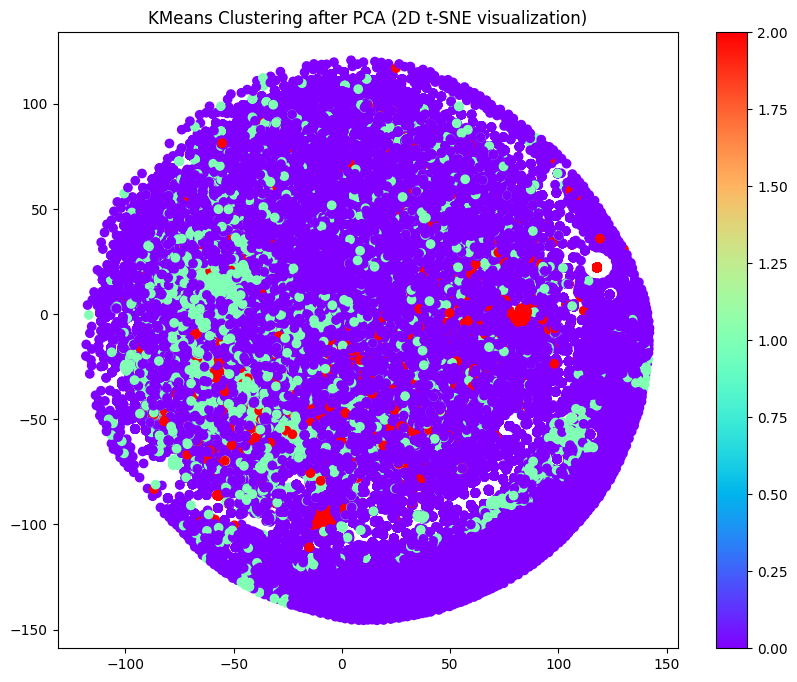

In [ ]:
# Plot the results
plt.figure(figsize=(10, 8))
plt.scatter(tsne_data_pca[:, 0], tsne_data_pca[:, 1], c=cluster_assignments_pca, cmap='rainbow')
plt.title("KMeans Clustering after PCA (2D t-SNE visualization)")
plt.colorbar()
plt.show()

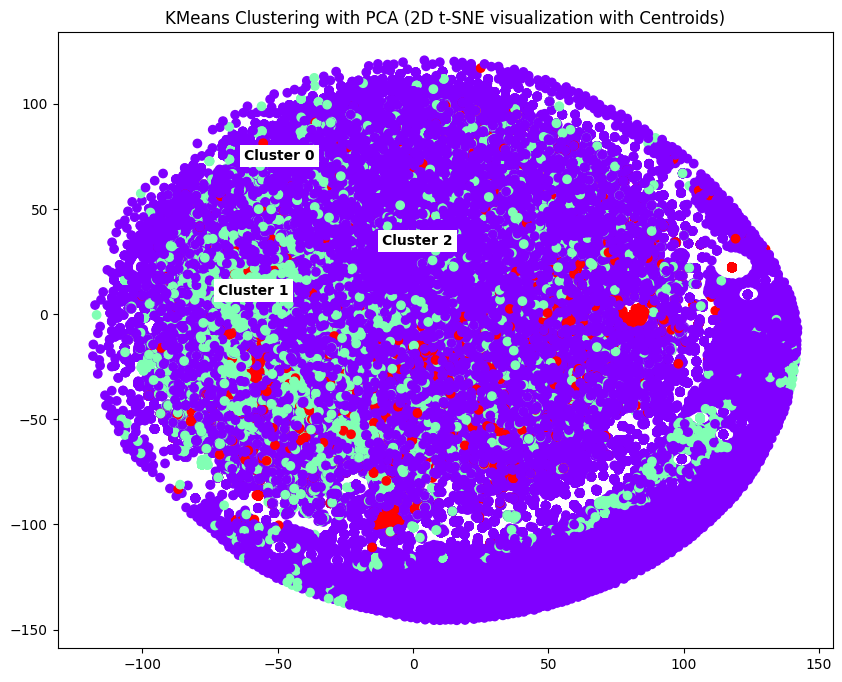

In [ ]:
# Create a new t-SNE model with adjusted perplexity
tsne_model_centroids = TSNE(n_components=2, random_state=42, perplexity=2)

# Transform the centroids using t-SNE
tsne_centroids = tsne_model_centroids.fit_transform(centroids)

plt.figure(figsize=(10, 8))
plt.scatter(tsne_data_pca[:, 0], tsne_data_pca[:, 1], c=cluster_assignments_pca, cmap='rainbow')

# Annotate the centroids on the plot
for i, centroid in enumerate(tsne_centroids):
    plt.annotate(f"Cluster {i}", (centroid[0], centroid[1]), fontsize=10, fontweight='bold',
                 bbox=dict(boxstyle="square,pad=0.3", facecolor="white", edgecolor="none"))

plt.title("KMeans Clustering with PCA (2D t-SNE visualization with Centroids)")
plt.show()


In [ ]:
# Assign clusters to the preprocessed_reviews data
preprocessed_reviews['cluster_label'] = cluster_assignments_pca

# Calculate mean and standard deviation for each cluster (assuming you have a numerical column named 'value_column_name')
cluster_stats = preprocessed_reviews.groupby('cluster_label')['vader_compound'].agg(['mean', 'std'])

cluster_stats


,mean,std
cluster_label,,
0,0.166624,0.547937
1,0.413312,0.477804
2,0.690166,0.236096


import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(cluster_stats, *['mean'], **{})
chart

import numpy as np
from google.colab import autoviz

def value_plot(df, y, figscale=1):
  from matplotlib import pyplot as plt
  df[y].plot(kind='line', figsize=(8 * figscale, 4 * figscale), title=y)
  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = value_plot(cluster_stats, *['std'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(cluster_stats, *['mean'], **{})
chart

import numpy as np
from google.colab import autoviz

def histogram(df, colname, num_bins=20, figscale=1):
  from matplotlib import pyplot as plt
  df[colname].plot(kind='hist', bins=num_bins, title=colname, figsize=(8*figscale, 4*figscale))
  plt.gca().spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = histogram(cluster_stats, *['std'], **{})
chart

import numpy as np
from google.colab import autoviz

def scatter_plots(df, colname_pairs, figscale=1, alpha=.8):
  from matplotlib import pyplot as plt
  plt.figure(figsize=(len(colname_pairs) * 6 * figscale, 6 * figscale))
  for plot_i, (x_colname, y_colname) in enumerate(colname_pairs, start=1):
    ax = plt.subplot(1, len(colname_pairs), plot_i)
    df.plot(kind='scatter', x=x_colname, y=y_colname, s=(32 * figscale), alpha=alpha, ax=ax)
    ax.spines[['top', 'right',]].set_visible(False)
  plt.tight_layout()
  return autoviz.MplChart.from_current_mpl_state()

chart = scatter_plots(cluster_stats, *[[['mean', 'std']]], **{})
chart

import numpy as np
from google.colab import autoviz

def time_series_multiline(df, timelike_colname, value_colname, series_colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (10 * figscale, 5.2 * figscale)
  palette = list(sns.palettes.mpl_palette(mpl_palette_name))
  def _plot_series(series, series_name, series_index=0):
    if value_colname == 'count()':
      counted = (series[timelike_colname]
                 .value_counts()
                 .reset_index(name='counts')
                 .rename({'index': timelike_colname}, axis=1)
                 .sort_values(timelike_colname, ascending=True))
      xs = counted[timelike_colname]
      ys = counted['counts']
    else:
      xs = series[timelike_colname]
      ys = series[value_colname]
    plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

  fig, ax = plt.subplots(figsize=figsize, layout='constrained')
  df = df.sort_values(timelike_colname, ascending=True)
  if series_colname:
    for i, (series_name, series) in enumerate(df.groupby(series_colname)):
      _plot_series(series, series_name, i)
    fig.legend(title=series_colname, bbox_to_anchor=(1, 1), loc='upper left')
  else:
    _plot_series(df, '')
  sns.despine(fig=fig, ax=ax)
  plt.xlabel(timelike_colname)
  plt.ylabel(value_colname)
  return autoviz.MplChart.from_current_mpl_state()

chart = time_series_multiline(cluster_stats, *['mean', 'std', None], **{})
chart

import numpy as np
from google.colab import autoviz

def time_series_multiline(df, timelike_colname, value_colname, series_colname, figscale=1, mpl_palette_name='Dark2'):
  from matplotlib import pyplot as plt
  import seaborn as sns
  figsize = (10 * figscale, 5.2 * figscale)
  palette = list(sns.palettes.mpl_palette(mpl_palette_name))
  def _plot_series(series, series_name, series_index=0):
    if value_colname == 'count()':
      counted = (series[timelike_colname]
                 .value_counts()
                 .reset_index(name='counts')
                 .rename({'index': timelike_colname}, axis=1)
                 .sort_values(timelike_colname, ascending=True))
      xs = counted[timelike_colname]
      ys = counted['counts']
    else:
      xs = series[timelike_colname]
      ys = series[value_colname]
    plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

  fig, ax = plt.subplots(figsize=figsize, layout='constrained')
  df = df.sort_values(timelike_colname, ascending=True)
  if series_colname:
    for i, (series_name, series) in enumerate(df.groupby(series_colname)):
      _plot_series(series, series_name, i)
    fig.legend(title=series_colname, bbox_to_anchor=(1, 1), loc='upper left')
  else:
    _plot_series(df, '')
  sns.despine(fig=fig, ax=ax)
  plt.xlabel(timelike_colname)
  plt.ylabel(value_colname)
  return autoviz.MplChart.from_current_mpl_state()

chart = time_series_multiline(cluster_stats, *['mean', 'count()', None], **{})
chart

Cluster 0:

Mean Sentiment Score: 0.166624
Standard Deviation: 0.547937
Interpretation: The sentiment scores for reviews in this cluster tend to lean slightly towards the positive side (since it's greater than 0), but there's a wide variation (as indicated by the relatively high standard deviation). This suggests that while some reviews in this cluster might be slightly positive, there's a mix of sentiments present.
Cluster 1:

Mean Sentiment Score: 0.413312
Standard Deviation: 0.477804
Interpretation: Reviews in this cluster have a moderately positive sentiment on average. The variation in sentiment scores is somewhat high, though not as wide as in Cluster 0. This indicates that while most reviews might be positive, there's still a considerable mix.
Cluster 2:

Mean Sentiment Score: 0.690166
Standard Deviation: 0.236096
Interpretation: This cluster has the highest average positive sentiment score among the three. The standard deviation is lower than the other two clusters, suggesting that sentiments within this cluster are more consistent and predominantly positive.
Overall:

Cluster 2 appears to be the most positively-received group of reviews, with sentiments being consistently positive.
Cluster 0 has the broadest range of sentiments, with a slight positive bias.
Cluster 1 is in between, with a moderate positive sentiment on average but still a mix of sentiments present.

Check what belongs to each cluster

In [ ]:
#Inspect cluster content
n_samples = 10
for cluster_num in range(optimal_clusters):
    preprocessed_reviews['cluster_label'] = cluster_assignments_pca
    sample_reviews = preprocessed_reviews[preprocessed_reviews['cluster_label'] == cluster_num].sample(n_samples)
    print(f"Cluster {cluster_num}:\n")
    print("\n".join(sample_reviews['Processed_Review']))
    print("-" * 40)


Cluster 0:

love variety music offer understand need progressive change hard time adjust late change way easy navigate listening option month ago everything life must assimilate thank spotify keep rockin
good army
spotify dj play banger first rotation like alright let switch start play bad shit ever heard
update review application sometimes good sometimes suck like randomly switch podcasts listen sometimes start completely sometimes stay spot restart sometimes switch podcasts hide one listen make type entire podcast title locate frustrate
chorus best thing ever like
agree wrs bijan cmc assume redraft lunacy busy current adp reckon end season around rb8 discuss one show week love get time give u listen
mini player bar disappear constantly way bring back clone open application bluetooth control win work late update
still hate make available spotify set
know early spotify already put david guetta produce credit fix delete figure people look
link link like doitlikethat jonasbrothers like t

Cluster 0:

General Payments & Usage: The topic "-1_get_pay_use_metre" seems to discuss general usage of the application, including any payments involved. This might refer to the general experience users have with the app, especially concerning any payments or subscriptions.
Technical Issues: The topic "0_screen_reinstall_ui_restart" indicates issues related to the user interface, especially problems that require users to reinstall the app or restart their devices.
Music Platforms: The topic "1_switch_apple_music_might" suggests discussions about switching between music platforms, especially between Apple Music and Spotify.
Sports: The topic "2_football_nba_mlb_baseball" indicates that users are discussing sports, possibly in the context of sports podcasts or broadcasts available on Spotify.
Emotional Feedback: The topic "3_good_oh_loudly_cry" might be capturing emotional feedback, possibly reactions to music or content on Spotify.
Cluster 1:

General Application Experience: The topic "-1_play_application_premium_use" seems to be about general app usage and the premium version of Spotify.
Negative Feedback: The topic "0_hate_fuck_spotify_bad" indicates strong negative feedback about Spotify.
Technical Issues: The topic "1_restart_phone_pause_close" is likely about technical issues requiring users to restart their phones, or issues with pausing tracks.
Comparison with Other Platforms: The topic "2_spotify_artist_youtube_easy" suggests that users might be comparing Spotify with YouTube, especially in terms of artist content.
App Maintenance: The topic "3_reinstall_uninstall_uninstalled_uninstalling" clearly indicates issues that require users to reinstall or uninstall the app.
Cluster 2:

General Music Listening: The topic "-1_music_listen_application_spotify" captures the general theme of music listening on Spotify.
Emotional Feedback: The topic "0_oh_red_love_cry" might be capturing users' emotional responses to certain songs or content.
App Premium Experience: The topic "1_premium_use_application_fix" seems to focus on the premium version of Spotify and perhaps issues that need fixing.
Strong Attachment or Dislike: The topic "2_obsess_unrequited_fire_last" might be capturing strong feelings, either positive (obsession with certain tracks) or negative.
Song Feedback: The topic "3_song_fire_loudly_red" is likely about specific songs, with users possibly expressing their love for certain tracks.




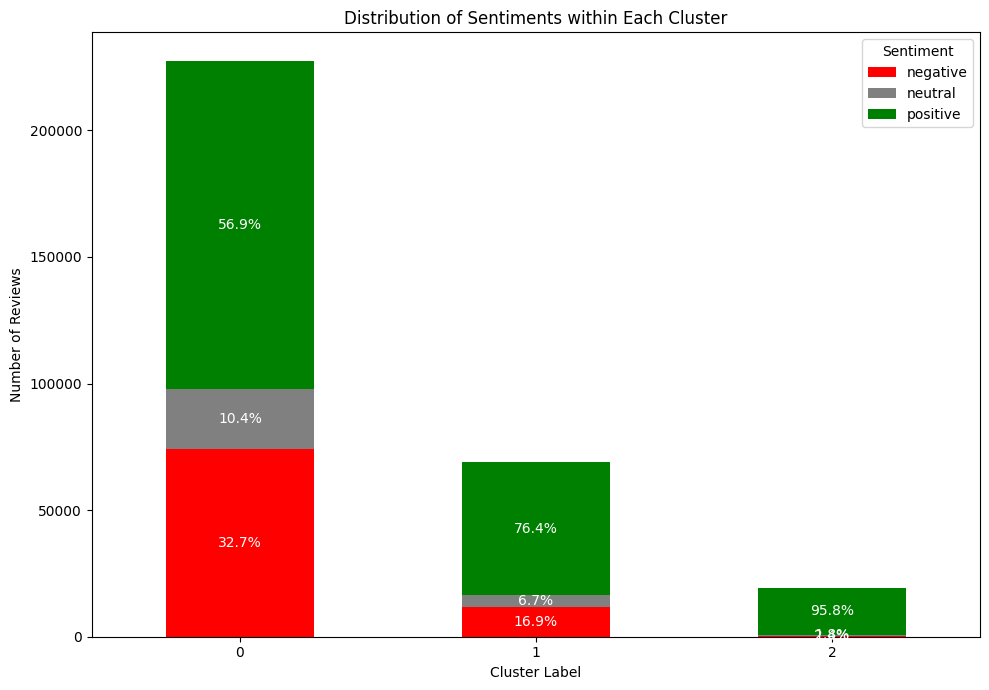

ensemble_label  negative  neutral  positive
cluster_label                              
0                  74315    23659    129401
1                  11687     4598     52774
2                    469      341     18616


In [ ]:
import matplotlib.pyplot as plt

# Group by 'cluster_label' and 'ensemble_label' and count the reviews
sentiment_distribution = preprocessed_reviews.groupby(['cluster_label', 'ensemble_label']).size().unstack()

# Calculate the percentage distribution
percent_distribution = sentiment_distribution.divide(sentiment_distribution.sum(axis=1), axis=0) * 100

# Define sentiment colors
colors = ['red', 'gray', 'green']

# Plot the distribution
ax = sentiment_distribution.plot(kind='bar', stacked=True, figsize=(10,7), color=colors)
plt.title("Distribution of Sentiments within Each Cluster")
plt.xlabel("Cluster Label")
plt.ylabel("Number of Reviews")
plt.legend(title="Sentiment")
plt.xticks(rotation=0)

# Annotate each segment of the stacked bar with the respective percentage
for i, cluster_label in enumerate(sentiment_distribution.index):
    total_reviews = sentiment_distribution.loc[cluster_label].sum()

    start_height = 0  # Keep track of where to place the text for each segment

    for j, sentiment in enumerate(sentiment_distribution.columns):
        segment_reviews = sentiment_distribution.loc[cluster_label, sentiment]
        percentage = percent_distribution.loc[cluster_label, sentiment]

        # Annotate only if there are reviews for the segment
        if segment_reviews > 0:
            height_offset = start_height + (segment_reviews / 2)  # Adjust to place text in the middle of the segment
            ax.text(i, height_offset, f"{percentage:.1f}%", ha='center', va='center', color='white')
            start_height += segment_reviews

plt.tight_layout()
plt.show()

print(sentiment_distribution)


This table displays the distribution of sentiments (obtained from ensemble labeling) across the three clusters.
Cluster 0:

74,315 negative reviews
23,659 neutral reviews
129,401 positive reviews
Cluster 1:

11,687 negative reviews
4,598 neutral reviews
52,774 positive reviews
Cluster 2:

469 negative reviews
341 neutral reviews
18,616 positive reviews
Analysis:

Cluster 0:

This cluster has the most reviews compared to the other two.
It has a dominant number of positive reviews, but also a significant number of negative reviews.
Considering the sample reviews analyzed earlier, this cluster might represent general user feedback about Spotify, encompassing both the good (like artist appreciation) and the bad (like technical issues).
Cluster 1:

This cluster has a high number of positive reviews, but the ratio of negative to positive reviews is higher than in Cluster 0.
This might be indicative of users who generally like Spotify but have specific grievances, possibly about ads, premium features, or song availability.
Cluster 2:

This is the smallest cluster in terms of the total number of reviews.
It has a very high ratio of positive to negative reviews.
It's likely this cluster represents the most satisfied group of Spotify users, who mainly have positive feedback about songs, artists, and the overall listening experience.

Recommendations:

Engage with Cluster 2: These are potentially most loyal or satisfied users. Engage with them to potentially turn them into brand ambassadors. Understand what they love most about Spotify and amplify those features.

Address Concerns in Cluster 1: Given that there's a significant portion of negative reviews, focus on understanding the common issues faced by this group. Addressing their concerns could lead to a better retention rate.

Deep Dive into Cluster 0: Given its size and mixed sentiments, further sub-segmentation or analysis might be beneficial. This can help identify specific issues or features that are causing both positive and negative feedback.

**Cosine similarity** is an effective measure to understand the closeness of vectors. To compute the cosine similarity between the median vectors of reviews, and compare them to some "target clusters"

In [ ]:
#compute cosine similarity scores
from sklearn.metrics.pairwise import cosine_similarity

# Step 1: Segregate the embeddings based on cluster_assignments_pca

cluster_embeddings = {}
for cluster_num in range(optimal_clusters):
    cluster_embeddings[cluster_num] = loaded_embeddings[cluster_assignments_pca == cluster_num]

# Step 2: Compute the median vector for each cluster

cluster_median_vectors = {}
for cluster_num, embeddings in cluster_embeddings.items():
    cluster_median_vectors[cluster_num] = get_median_vector(embeddings)

# Step 3: Compute cosine similarity

similarities = {}
for cluster_num, median_vector in cluster_median_vectors.items():
    similarities[cluster_num] = {
        'positive': cosine_similarity([median_vector], [positive_median])[0][0],
        'negative': cosine_similarity([median_vector], [negative_median])[0][0],
        'neutral': cosine_similarity([median_vector], [neutral_median])[0][0]
    }

similarities


{0: {'positive': 0.99457306, 'negative': 0.99647224, 'neutral': 0.99346614},
 1: {'positive': 0.9867173, 'negative': 0.97095436, 'neutral': 0.97056055},
 2: {'positive': 0.94062746, 'negative': 0.91400504, 'neutral': 0.9174902}}

Cluster 0:

Positive: 0.9946
Negative: 0.9965
Neutral: 0.9935
Cluster 0 has a high cosine similarity to all three sentiment classes. However, its similarity to the negative sentiment is the highest. This suggests that the reviews in Cluster 0 are most likely to be negative.

Cluster 1:

Positive: 0.9867
Negative: 0.9710
Neutral: 0.9706
Cluster 1 also has high cosine similarity values to all sentiment classes. But it has the highest similarity to the positive sentiment, indicating that the reviews in Cluster 1 are most likely to be positive.

Cluster 2:

Positive: 0.9406
Negative: 0.9140
Neutral: 0.9175
Cluster 2 has the highest similarity with the positive sentiment, though its values are lower compared to the other clusters. This suggests that the reviews in Cluster 2 are most likely to be positive, but the confidence in this assignment is lower than for the other two clusters.

Overall, this analysis helps in understanding the predominant sentiment of each cluster. The clusters seem to be inclined towards specific sentiments, with Cluster 0 leaning towards negative, and Clusters 1 and 2 leaning towards positive. The cosine similarity values are quite close for some clusters, indicating potential overlaps in the sentiments or diverse sentiments within a single cluster.


Given the high similarity values across all clusters and sentiments, it's challenging to distinctly categorize each cluster based solely on these results. While the clusters have slight leanings towards specific sentiments, the differences are not substantial enough to make clear distinctions.




**BERTopic**:  Leverages BERT's semantic knowledge leading to higher quality topics.

Uses BERT embeddings and clustering to discover topics
Topics emerge from the data in a bottom-up manner
Doesn't require choosing the number of topics beforehand
Typically produces coherent topics even with minimal tuning
Fast and efficient compared to traditional topic models

In [ ]:
!pip install bertopic

In [ ]:
# Load Pre-trained BERT Model and Tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')


In [ ]:
# Define Function to Generate Embeddings
def generate_embeddings(texts, tokenizer, model):
    embeddings = []
    for text in texts:
        inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=512)
        with torch.no_grad():
            outputs = model(**inputs)
        embeddings.append(outputs.last_hidden_state.mean(dim=1).numpy())
    return np.vstack(embeddings)


In [ ]:
def remove_undesired_words(reviews, undesired_words):
    cleaned_reviews = []
    for review in reviews:
        cleaned_review = " ".join([word for word in review.split() if word not in undesired_words])
        cleaned_reviews.append(cleaned_review)
    return cleaned_reviews

undesired_words = {
    'cry', 'loudly', 'face', 'smile', 'red', 'heart', 'musical', 'note', 'scroll', 'skin', 'tone', 'bts',
    'backhand', 'index', 'point', 'roll', 'floor', 'hi', 'bro', 'bunny','laugh', 'ouble', 'exclamation', 'mark', 'button',
    'fire', 'p', 'olice', 'car', 'light', 'k', 'x', 'check', 'mark', 'button', 'tear', 'thumb', 'guy', 'skull',
    'hand', 'raise', 'mouth', 'raise', '!', '-', '?', 'oh', 'sweat', 'grin', 'mama', 'head'
}

In [ ]:
# Apply Function to Reviews
reviews = preprocessed_reviews['Processed_Review']
cleaned_reviews = remove_undesired_words(reviews, undesired_words)
embeddings = generate_embeddings(cleaned_reviews, tokenizer, model)

In [ ]:
import numpy as np

# Save embeddings to a file
np.save('/content/drive/My Drive/Project/BERT_embeddings.npy', embeddings)


In [ ]:
# load saved embeddings
loaded_embeddings = np.load('/content/drive/My Drive/Project/embeddings.npy')

In [ ]:
# Scale Features
scaler = StandardScaler()
scaled_embeddings = scaler.fit_transform(embeddings)


**Extract the Topics in each cluster using BERTopic**

In [ ]:
undesired_words = {'oh', 'guy', 'fire', 'zc', 'eye', 'loudly', 'face', 'red', 'heart', 'urple', 'thums',
                   'musical', 'note', 'scroll', 'skin', 'tone', 'backhand', 'index',
                   'point', 'roll', 'floor', 'hi', 'bro', 'bunny', 'ouble', 'exclamation',
                   'mark', 'button', 'purple', 'fire', 'p', 'olice', 'car', 'light', 'k',
                   'x', 'check', 'mark', 'button', 'tear', 'thumb', 'guy', 'skull', 'hand',
                   'raise', 'mouth', 'raise', '!', '-', '?', 'sweat', 'grin', 'mama', 'head'}

def clean_reviews(review):
    # Filter out undesired words
    cleaned_review = " ".join([word for word in review.split() if word not in undesired_words])

    # Merge "favourite" to "favorite"
    cleaned_review = cleaned_review.replace("favourite", "favorite")

    return cleaned_review

# Apply the function to clean reviews
preprocessed_reviews['Processed_Review'] = preprocessed_reviews['Processed_Review'].apply(clean_reviews)


In [ ]:
from bertopic import BERTopic

# Initialize BERTopic
topic_model = BERTopic(embedding_model=None)  # Set embedding model to None since embeddings is being used directly

# Add cluster assignments to the DataFrame
preprocessed_reviews['cluster_label'] = cluster_assignments_pca

for cluster_num in range(optimal_clusters):
    # Filter reviews and embeddings for the current cluster
    cluster_reviews = preprocessed_reviews['Processed_Review'][preprocessed_reviews['cluster_label'] == cluster_num]
    cluster_embeddings = loaded_embeddings[preprocessed_reviews['cluster_label'] == cluster_num]

    # Fit BERTopic
    topics, _ = topic_model.fit_transform(cluster_reviews, embeddings=cluster_embeddings)

    # Display topics for the current cluster
    print(f"Topics for Cluster {cluster_num}:")
    print(topic_model.get_topic_info())


Topics for Cluster 0:
      Topic   Count                                       Name  \
0        -1  160004                        -1_get_use_go_metre   
1         0    1485                 0_switch_apple_music_might   
2         1    1067   1_excellent_quality_selection_collection   
3         2     996                    2_feel_voice_brain_sing   
4         3     879                           3_hai_ke_bhi_aur   
...     ...     ...                                        ...   
1663   1662      10  1662_economic_economist_indicator_housing   
1664   1663      10              1663_hitomi_geneva_shade_halo   
1665   1664      10    1664_boggess_ahole_vinylscars_hypergamy   
1666   1665      10      1665_beeing_visualiser_nieche_earnest   
1667   1666      10         1666_goo_fatherly_sevenus_coquette   

                                         Representation  \
0     [get, use, go, metre, listen, application, pay...   
1     [switch, apple, music, might, tidal, finally, ...   
2     [e

In [ ]:
# Visualize the top words for each of the top 5 topics
topic_model.visualize_barchart(top_n_topics=10)


**Extract Topics for each cluster**

In [ ]:
# Unique cluster labels
cluster_labels = preprocessed_reviews['cluster_label'].unique()

# Extract topics for each cluster
topics_by_cluster = {}

for cluster_num in cluster_labels:
    # Filter reviews and embeddings for the current cluster
    cluster_reviews = preprocessed_reviews['Processed_Review'][preprocessed_reviews['cluster_label'] == cluster_num]
    cluster_embeddings = loaded_embeddings[preprocessed_reviews['cluster_label'] == cluster_num]

    # Fit BERTopic
    topics, _ = topic_model.fit_transform(cluster_reviews, embeddings=cluster_embeddings)

    # Store topics for the current cluster
    topics_by_cluster[cluster_num] = topic_model.get_topic_info()

topics_by_cluster


{0:       Topic   Count                                           Name  \
 0        -1  160904                              -1_get_use_pay_go   
 1         0    1264                     0_switch_apple_music_might   
 2         1    1123                    1_login_password_log_number   
 3         2     696                    2_discuss_health_dr_founder   
 4         3     684                   3_podcast_episode_jennie_dua   
 ...     ...     ...                                            ...   
 1693   1692      10  1692_puremichigan_niblings_monstery_halloween   
 1694   1693      10               1693_blond_freefall_mercury_yard   
 1695   1694      10         1694_erroneous_slutshamed_abuse_racism   
 1696   1695      10     1695_aus_23_spotifywrapped_spotifyplaylist   
 1697   1696      10                   1696_drone_freely_ion_crying   
 
                                          Representation  \
 0     [get, use, pay, go, metre, make, really, liste...   
 1     [switch, apple, 

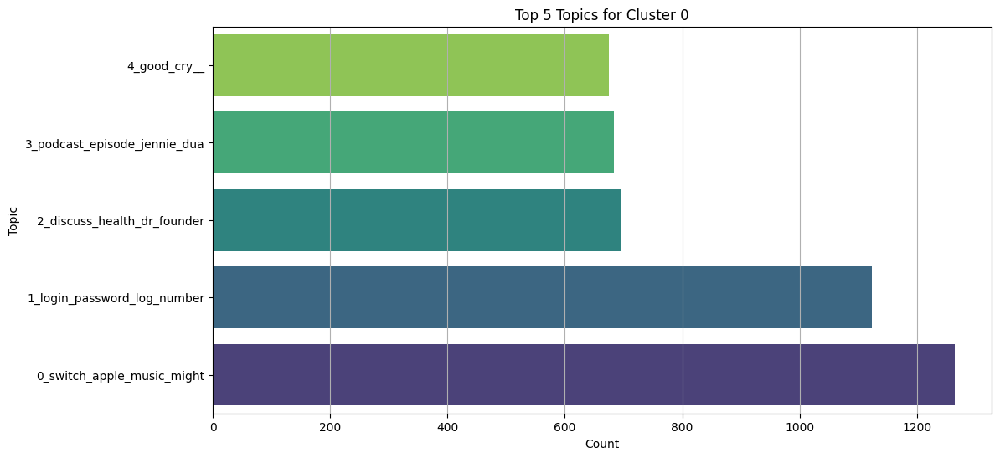

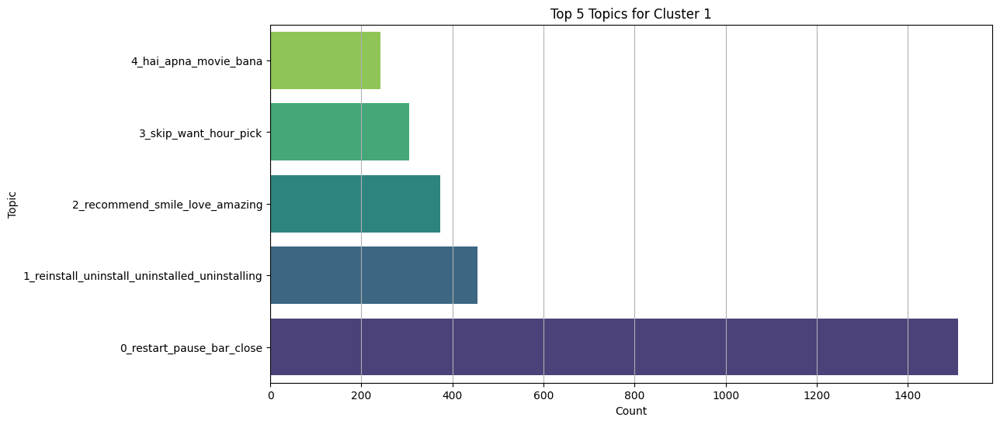

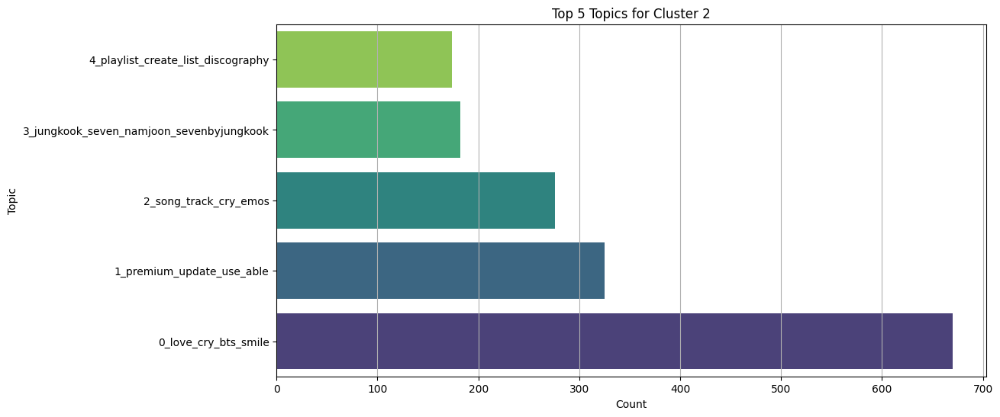

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def visualize_topics_bertopic_style(cluster_num, topic_info, top_n=5):
    """
    Visualize the top N topics for a given cluster in a style similar to BERTopic's visualize_barchart.

    Parameters:
    - cluster_num: The cluster number.
    - topic_info: DataFrame containing the topic information.
    - top_n: The number of top topics to visualize (default is 5).
    """
    # Filter out the top N topics (excluding the -1 topic)
    top_topics = topic_info[topic_info['Topic'] != -1].head(top_n)

    # Plot
    plt.figure(figsize=(12, 6))

    sns.barplot(data=top_topics, y='Name', x='Count', palette='viridis')

    plt.xlabel('Count')
    plt.ylabel('Topic')
    plt.title(f'Top {top_n} Topics for Cluster {cluster_num}')
    plt.gca().invert_yaxis()
    plt.grid(axis='x')
    plt.show()

# Visualize the topics for each cluster
for cluster_num in cluster_labels:
    topic_info = topics_by_cluster[cluster_num]
    visualize_topics_bertopic_style(cluster_num, topic_info)


Cluster 0:
The most dominant topic is related to general usage and actions like "get", "use", "pay", "go".
The subsequent topics indicate:
Possible comparisons or switch from Apple Music to Spotify.
Issues or discussions about login credentials, passwords, etc.
Topics around discussions related to health with words like "health", "dr", "founder", etc.

Cluster 1:
The most dominant topic in this cluster revolves around basic functionalities like "play", "playlist", "song", "listen".
This cluster appears to concentrate on the operational aspects of Spotify, including playback functionalities, app glitches, and user preferences in terms of playback.

Cluster 2:
The primary topic here is also quite generic with words like "spotify", "music", "listen", "get".
This cluster might represent more emotionally-driven reviews, focusing on the user's affection or attachment to certain songs, artists, or the app's offerings. The presence of specific artists' names suggests fandom discussions or artist-specific feedback.



In [ ]:
topic_model.visualize_heatmap()


**Temporal Analysis on Clustering**

In [58]:
# Check the min and max date in the dataset
min_date = preprocessed_reviews['date'].min()
max_date = preprocessed_reviews['date'].max()

min_date, max_date

('01/01/2023 02:36', '31/12/2022 21:32')

In [59]:
import pandas as pd
from datetime import datetime

# Function to convert inconsistent date formats to a consistent one
def convert_to_consistent_date(date_str):
    try:
        # First, try to parse with DD/MM/YYYY format
        return datetime.strptime(date_str, '%d/%m/%Y %H:%M').date()
    except:
        try:
            # Next, try to parse with MM/DD/YYYY format
            return datetime.strptime(date_str, '%m/%d/%Y %H:%M').date()
        except:
            try:
                # Try to parse with YYYY-MM-DD HH:MM:SS format
                return datetime.strptime(date_str, '%Y-%m-%d %H:%M:%S').date()
            except:
                # Finally, try to parse with YYYY-MM-DD format
                return datetime.strptime(date_str, '%Y-%m-%d').date()

# Apply the function to the 'date' column
preprocessed_reviews['date'] = preprocessed_reviews['date'].astype(str).apply(convert_to_consistent_date)

In [60]:
# Check the min and max date in the dataset
min_date = preprocessed_reviews['date'].min()
max_date = preprocessed_reviews['date'].max()

min_date, max_date

(datetime.date(2022, 1, 1), datetime.date(2023, 7, 14))

In [66]:
# Convert 'date' column to datetime format
preprocessed_reviews['date'] = pd.to_datetime(preprocessed_reviews['date'])

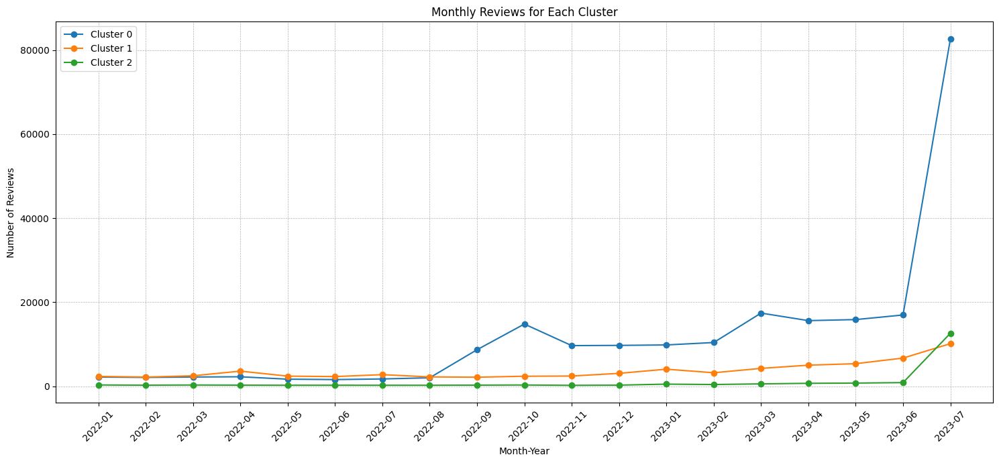

In [ ]:
# Extract month-year from the date column and create a new column 'month_year'
preprocessed_reviews['month_year'] = preprocessed_reviews['date'].dt.to_period('M')

# Group by 'month_year' and 'cluster_label' and count the reviews
monthly_reviews = preprocessed_reviews.groupby(['month_year', 'cluster_label']).size().unstack()

# Plot
plt.figure(figsize=(15, 7))
for cluster in monthly_reviews.columns:
    plt.plot(monthly_reviews.index.astype(str), monthly_reviews[cluster], label=f"Cluster {cluster}", marker='o')

plt.title("Monthly Reviews for Each Cluster")
plt.xlabel("Month-Year")
plt.ylabel("Number of Reviews")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()


Trend Analysis:

Cluster 0: There's a consistent increase in the number of reviews associated with this cluster, starting from January 2023 and continuing through July 2023. This consistent upward trend suggests that the sentiments or topics represented by Cluster 0 are becoming increasingly prevalent.

Cluster 1: This cluster exhibits a decreasing trend from January to May 2023. However, there's a sharp increase in June, with the count almost doubling from the previous month, before declining slightly in July.

Cluster 2: The number of reviews in this cluster is relatively stable from January to May, with a slight increase in June and July.

From this visualization:

It's evident that Cluster 0 has the most significant growth, which could be of interest, especially when identifying the sentiments or topics that are becoming increasingly common.
The sharp rise in Cluster 1 reviews in June might warrant a closer examination to understand what led to this surge. Was there a specific event or change during this period related to Spotify?
Cluster 2 seems to be relatively consistent, suggesting that the sentiments or topics it represents are stable over time

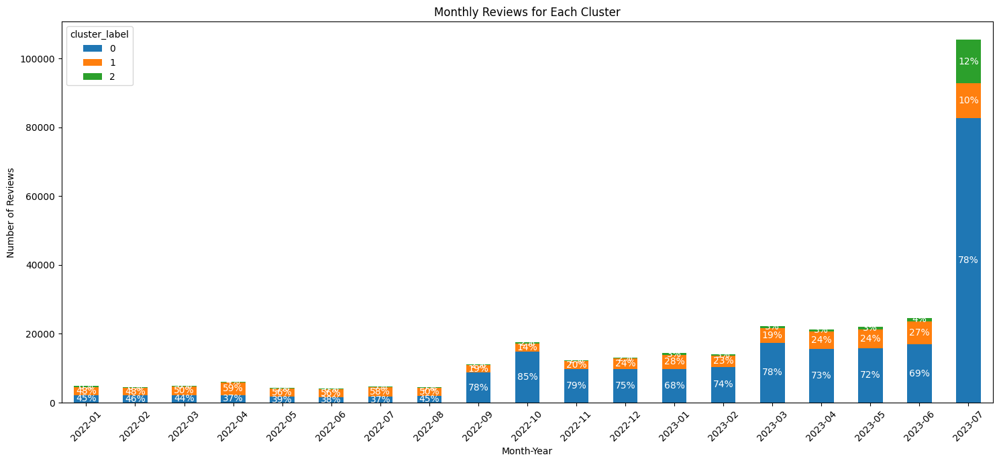

In [ ]:
# Extract month-year from the date column and create a new column 'month_year'
preprocessed_reviews['month_year'] = preprocessed_reviews['date'].dt.to_period('M')

# Group by 'month_year' and 'cluster_label' and count the reviews
monthly_reviews = preprocessed_reviews.groupby(['month_year', 'cluster_label']).size().unstack()

# Plotting
fig, ax = plt.subplots(figsize=(15, 7))
monthly_reviews.plot(kind='bar', stacked=True, ax=ax)

# Calculating and annotating the percentages
for i, month_year in enumerate(monthly_reviews.index):
    total_reviews_for_month = monthly_reviews.loc[month_year].sum()
    cluster_cum_sum = 0  # to keep track of the cumulative sum of cluster counts for positioning the text
    for cluster, count in monthly_reviews.loc[month_year].items():
        percentage = (count / total_reviews_for_month) * 100
        ax.text(i, cluster_cum_sum + (count / 2), f"{percentage:.0f}%",
                ha='center', va='center', color='white', fontsize=10)
        cluster_cum_sum += count

ax.set_title('Monthly Reviews for Each Cluster')
ax.set_ylabel('Number of Reviews')
ax.set_xlabel('Month-Year')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


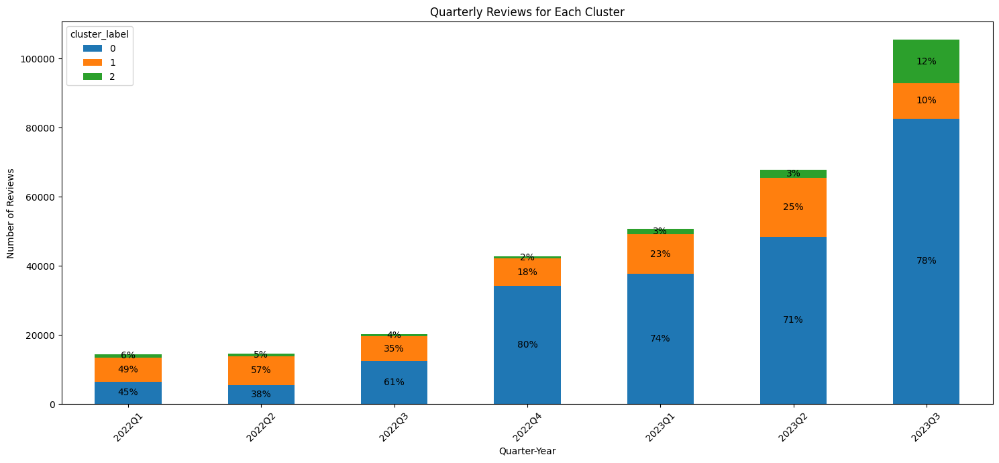

In [ ]:
import matplotlib.pyplot as plt

# Extract quarter-year from the date column and create a new column 'quarter_year'
preprocessed_reviews['quarter_year'] = preprocessed_reviews['date'].dt.to_period('Q')

# Group by 'quarter_year' and 'cluster_label' and count the reviews
quarterly_reviews = preprocessed_reviews.groupby(['quarter_year', 'cluster_label']).size().unstack()

# Plotting
fig, ax = plt.subplots(figsize=(15, 7))
quarterly_reviews.plot(kind='bar', stacked=True, ax=ax)

# Calculating and annotating the percentages
for i, quarter_year in enumerate(quarterly_reviews.index):
    total_reviews_for_quarter = quarterly_reviews.loc[quarter_year].sum()
    cluster_cum_sum = 0  # to keep track of the cumulative sum of cluster counts for positioning the text
    for cluster, count in quarterly_reviews.loc[quarter_year].items():
        percentage = (count / total_reviews_for_quarter) * 100
        ax.text(i, cluster_cum_sum + (count / 2), f"{percentage:.0f}%",
                ha='center', va='center', color='black', fontsize=10)
        cluster_cum_sum += count

ax.set_title('Quarterly Reviews for Each Cluster')
ax.set_ylabel('Number of Reviews')
ax.set_xlabel('Quarter-Year')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# Display the quarterly reviews count for each cluster
print(quarterly_reviews)

cluster_label      0      1      2
quarter_year                      
2022Q1          6482   7017    843
2022Q2          5518   8303    725
2022Q3         12437   7127    714
2022Q4         34196   7877    766
2023Q1         37648  11518   1466
2023Q2         48443  17083   2309
2023Q3         82651  10134  12603


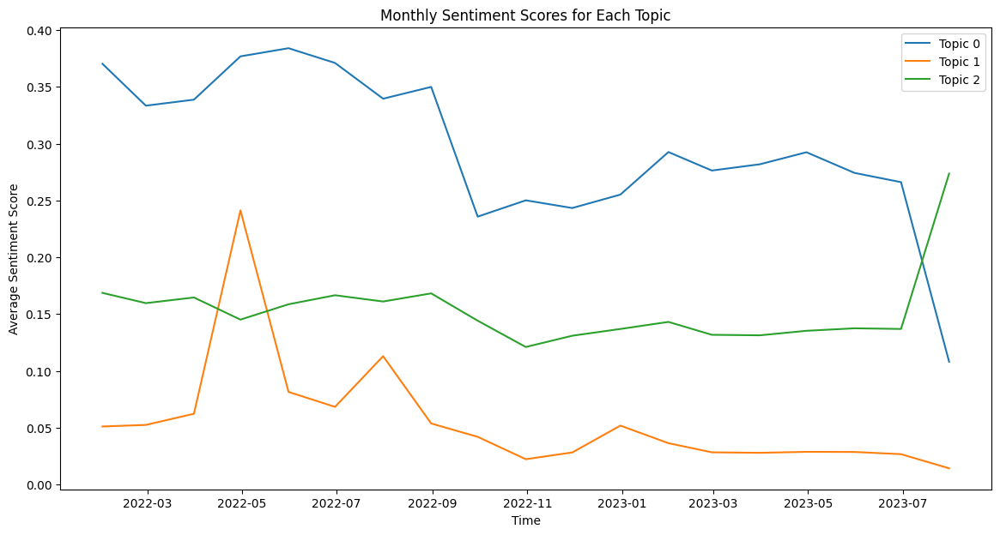

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# 1. Extract Topic Keywords in each cluster
topic_keywords = {cluster: topics_by_cluster[cluster]['Name'][1] for cluster in topics_by_cluster}

# Create a column for each topic to check if the review mentions it
for cluster, keywords in topic_keywords.items():
    keywords = keywords.split('_')[1:]  # Split and remove the cluster number
    preprocessed_reviews[f'topic_{cluster}'] = preprocessed_reviews['Processed_Review'].apply(lambda x: any(keyword in x for keyword in keywords))

# 2. Ensure Time-Series Data
# Convert timestamp to datetime format if it's not already
preprocessed_reviews['date'] = pd.to_datetime(preprocessed_reviews['date'])

# 3. Sentiment Scores
# Convert ensemble_label to numeric scores (assuming positive: 1, neutral: 0, negative: -1)
preprocessed_reviews['sentiment_score'] = preprocessed_reviews['ensemble_label'].map({'positive': 1, 'neutral': 0, 'negative': -1})

# 4. Aggregate
# Aggregate by month
monthly_sentiments = preprocessed_reviews.resample('M', on='date').mean()

# 5. Visualize
plt.figure(figsize=(14, 7))
for cluster in topic_keywords:
    plt.plot(monthly_sentiments.index, monthly_sentiments[f'topic_{cluster}'], label=f"Topic {cluster}")

plt.title("Monthly Sentiment Scores for Each Topic")
plt.xlabel("Time")
plt.ylabel("Average Sentiment Score")
plt.legend()
plt.show()


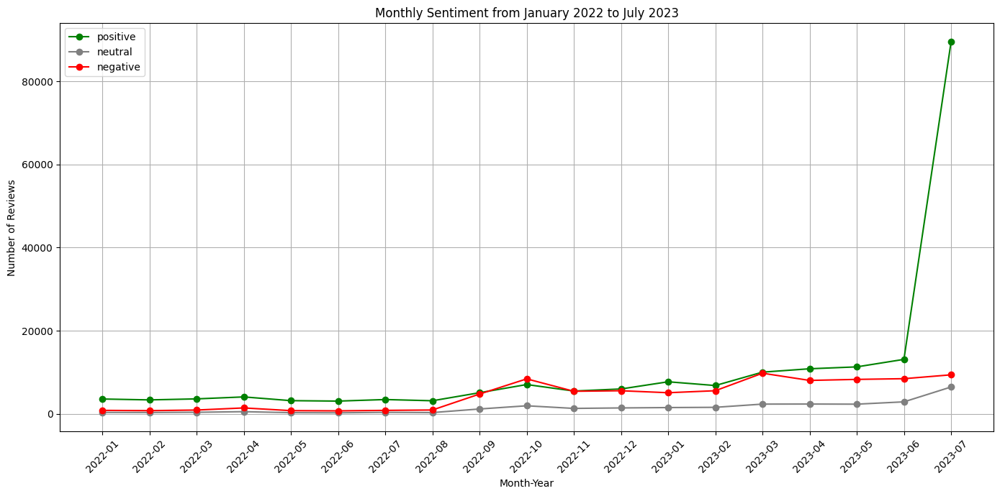

In [94]:
#trend analysis of sentiments from january 2022 to july 2023
# Convert 'date' column to datetime format
preprocessed_reviews['date'] = pd.to_datetime(preprocessed_reviews['date'])

# Convert to a monthly periodic representation
preprocessed_reviews['month_year'] = preprocessed_reviews['date'].dt.to_period('M')

# Aggregate the reviews by month and sentiment
monthly_sentiment_counts = preprocessed_reviews.groupby(['month_year', 'ensemble_label']).size().unstack(fill_value=0)

# Define the color mapping for sentiments
color_map = {
    'negative': 'red',
    'neutral': 'grey',
    'positive': 'green'
}

# Plot the aggregated counts over time
plt.figure(figsize=(14, 7))
for sentiment in ['positive', 'neutral', 'negative']:
    plt.plot(monthly_sentiment_counts.index.astype(str), monthly_sentiment_counts[sentiment], label=sentiment, marker='o', color=color_map[sentiment])

plt.title('Monthly Sentiment from January 2022 to July 2023')
plt.xlabel('Month-Year')
plt.ylabel('Number of Reviews')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



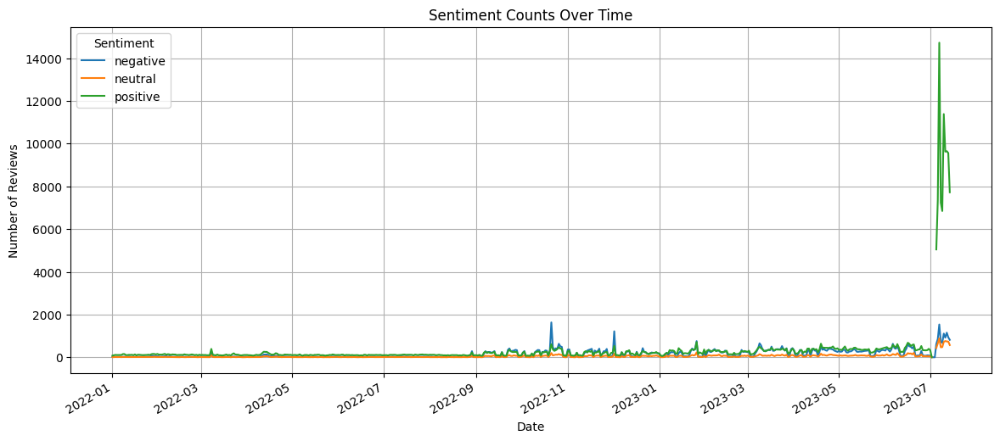

In [ ]:
# 2. Plot Sentiment Counts Over Time
sentiment_counts = preprocessed_reviews.groupby(['date', 'ensemble_label']).size().unstack()

plt.figure(figsize=(14, 6))
sentiment_counts.plot(ax=plt.gca())
plt.title('Sentiment Counts Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Reviews')
plt.grid(True)
plt.legend(title='Sentiment')
plt.show()

The plot shows the number of reviews labeled as positive, negative, or neutral over the time period of the dataset.
It seems there's a significant number of positive reviews throughout, but there are noticeable spikes for negative and neutral sentiments at certain periods.

In [ ]:
from scipy.signal import find_peaks

# Group the data by month and sentiment, then count the number of reviews using the correct column
monthly_sentiments = preprocessed_reviews.groupby([preprocessed_reviews['date'].dt.to_period('M'), 'ensemble_label']).size().unstack()

# Extract the time series for positive and negative sentiments
positive_ts = monthly_sentiments['positive']
negative_ts = monthly_sentiments['negative']

# Identify peaks for positive and negative time series
positive_peaks, _ = find_peaks(positive_ts)
negative_peaks, _ = find_peaks(negative_ts)

# Extract dates corresponding to the peaks
positive_spike_dates = positive_ts.index[positive_peaks]
negative_spike_dates = negative_ts.index[negative_peaks]

positive_spike_dates, negative_spike_dates


(PeriodIndex(['2022-04', '2022-07', '2022-10', '2023-01'], dtype='period[M]', name='date'),
 PeriodIndex(['2022-04', '2022-10', '2022-12', '2023-03'], dtype='period[M]', name='date'))

For Positive Reviews:

April 2022
July 2022
October 2022
January 2023
For Negative Reviews:

April 2022
October 2022
December 2022
March 2023
June 2023
It's worth noting that both positive and negative reviews have noticeable spikes in April 2022 and October 2022. This could be indicative of significant events or changes related to Spotify that elicited strong reactions, both positive and negative, from users

In [ ]:
import seaborn as sns

In [67]:
print(preprocessed_reviews['month_year'].unique())

<PeriodArray>
['2022-12', '2022-11', '2023-03', '2023-02', '2023-01', '2023-06', '2022-10',
 '2022-09', '2022-08', '2023-05', '2023-04', '2023-07', '2022-04', '2022-06',
 '2022-05', '2022-07', '2022-03', '2022-02', '2022-01']
Length: 19, dtype: period[M]


In [73]:
# Filter data for the months of interest
months_of_interest = ['2022-04', '2022-07', '2022-10', '2023-01', '2022-12', '2023-03', '2023-06']
filtered_data = preprocessed_reviews[preprocessed_reviews['month_year'].astype(str).isin(months_of_interest)]
print(filtered_data['month_year'].value_counts())

2023-06    24522
2023-03    22224
2022-10    17480
2023-01    14385
2022-12    13051
2022-04     6104
2022-07     4718
Freq: M, Name: month_year, dtype: int64


In [ ]:
# Step 1: Check if the filtered_data DataFrame contains the correct entries.
print(filtered_data['month_year'].value_counts())

2023-06    24522
2023-03    22224
2022-10    17480
2023-01    14385
2022-12    13051
2022-04     6104
2022-07     4718
Freq: M, Name: month_year, dtype: int64


In [90]:
# Step 2: Aggregate the data
agg_data = filtered_data.groupby(['month_year', 'ensemble_label']).size().reset_index(name='count')

agg_data

,month_year,ensemble_label,count
0,2022-04,negative,1452
1,2022-04,neutral,552
2,2022-04,positive,4100
3,2022-07,negative,863
4,2022-07,neutral,387
5,2022-07,positive,3468
6,2022-10,negative,8438
7,2022-10,neutral,1967
8,2022-10,positive,7075
9,2022-12,negative,5586


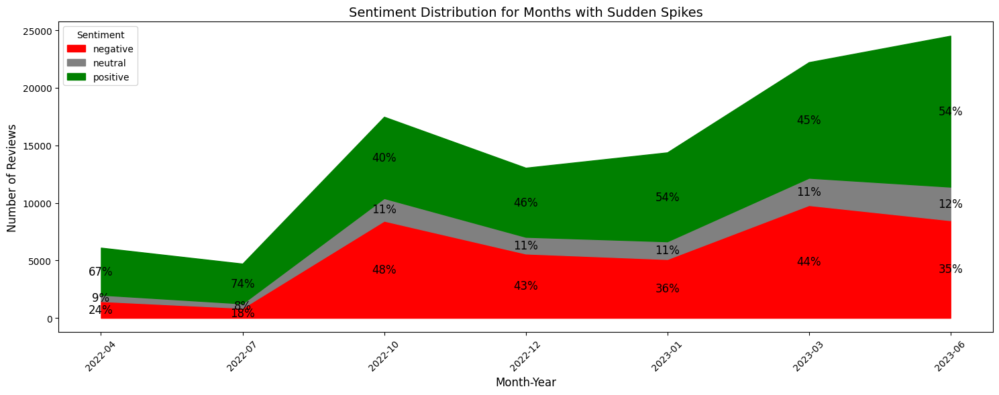

In [98]:
#visualize distribution of the sentiments of the months with sudden spikes
# Create a figure and axis
fig, ax = plt.subplots(figsize=(15, 6))

# Setting a plain white background for the plot
ax.set_facecolor('white')
fig.patch.set_facecolor('white')

# Calculate cumulative values for stacked area plot
pivot_data['negative_cum'] = pivot_data['negative']
pivot_data['neutral_cum'] = pivot_data['negative'] + pivot_data['neutral']
pivot_data['positive_cum'] = pivot_data['negative'] + pivot_data['neutral'] + pivot_data['positive']

# Plotting the areas
ax.fill_between(pivot_data['month_year'].astype(str), 0, pivot_data['negative_cum'], color=color_map['negative'], label='negative')
ax.fill_between(pivot_data['month_year'].astype(str), pivot_data['negative_cum'], pivot_data['neutral_cum'], color=color_map['neutral'], label='neutral')
ax.fill_between(pivot_data['month_year'].astype(str), pivot_data['neutral_cum'], pivot_data['positive_cum'], color=color_map['positive'], label='positive')

# Adding percentage annotations
for idx, month_year in enumerate(pivot_data['month_year']):
    total = pivot_data.loc[idx, sentiments].sum()

    for sentiment in sentiments:
        value = pivot_data.loc[idx, sentiment]
        percentage = f"{(value / total)*100:.0f}%"
        if value > 0:  # Avoid annotating zero values
            ax.text(idx, pivot_data.loc[idx, f"{sentiment}_cum"] - (value / 2),
                    percentage, ha='center', va='center', fontsize=12, color='black')

# Customize the plot
ax.set_title('Sentiment Distribution for Months with Sudden Spikes', fontsize=14)
ax.set_xlabel('Month-Year', fontsize=12)
ax.set_ylabel('Number of Reviews', fontsize=12)
ax.legend(loc='upper left', title='Sentiment')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [70]:
#check the common words in the discussions for these months
positive_months = ['2022-04', '2022-07', '2022-10', '2023-01']
negative_months = ['2022-04', '2022-10', '2022-12', '2023-03', '2023-06']



In [83]:
!pip install tabulate

In [82]:
#extract the overall most common words for the months with most postitive reviews and negative reviews
def get_common_words(data, n=10, undesired_words=set()):
    # Tokenize the reviews
    words = [word for review in data['Processed_Review'] for word in review.split() if word not in undesired_words]

    # Get word frequencies
    word_freq = Counter(words)

    # Get the most common words
    common_words = word_freq.most_common(n)

    # Create a DataFrame to store the results
    df = pd.DataFrame(common_words, columns=['Word', 'Count'])
    total_words = len(words)
    df['Percentage'] = (df['Count'] / total_words) * 100

    return df

# Filter data for positive and negative months
positive_data = filtered_data[(filtered_data['month_year'].astype(str).isin(positive_months)) &
                              (filtered_data['ensemble_label'] == 'positive')]

negative_data = filtered_data[(filtered_data['month_year'].astype(str).isin(negative_months)) &
                              (filtered_data['ensemble_label'] == 'negative')]

# Define undesired words
undesired_words = {'oh', 'guy', 'fire', 'zc', 'eye', 'spotify', 'loudly', 'face', 'red', 'heart', 'urple', 'thums',
                   'musical', 'note', 'scroll', 'skin', 'tone', 'backhand', 'index',
                   'point', 'roll', 'floor', 'hi', 'bro', 'bunny', 'ouble', 'exclamation',
                   'mark', 'button', 'purple', 'fire', 'p', 'olice', 'car', 'light', 'k',
                   'x', 'check', 'mark', 'button', 'tear', 'thumb', 'guy', 'skull', 'hand',
                   'raise', 'mouth', 'raise', '!', '-', '?', 'sweat', 'grin', 'mama', 'head'}

# Get the most common words
positive_common_words = get_common_words(positive_data, undesired_words=undesired_words)
negative_common_words = get_common_words(negative_data, undesired_words=undesired_words)

print("Common words for positive months:")
print(positive_common_words)

print("\nCommon words for negative months:")
print(negative_common_words)


Common words for positive months:
          Word  Count  Percentage
0         song  10970    3.036006
1  application  10745    2.973736
2        music   9242    2.557773
3         play   6970    1.928985
4         like   4760    1.317355
5           ad   4285    1.185897
6       listen   4209    1.164863
7     playlist   4030    1.115324
8          use   4025    1.113940
9         good   4024    1.113663

Common words for negative months:
          Word  Count  Percentage
0          bad  10320    2.493446
1         hate   8107    1.958757
2         song   7349    1.775614
3        music   5641    1.362939
4  application   5557    1.342643
5          cry   4416    1.066963
6          get   4322    1.044251
7           ad   4196    1.013808
8           go   3508    0.847578
9         like   3426    0.827766


In [78]:
#extract the common words in each of the months with sudden spikes both positive and negative reviews
def get_common_words_per_month(data, months, undesired_words, n=5):
    monthly_common_words = {}

    for month in months:
        # Filter data for the specific month
        monthly_data = data[data['month_year'].astype(str) == month]

        # Tokenize the reviews
        words = [word for review in monthly_data['Processed_Review'] for word in review.split() if word not in undesired_words]

        # Get word frequencies
        word_freq = Counter(words)

        # Get the most common words
        common_words = word_freq.most_common(n)

        # Convert to DataFrame for easy handling
        df = pd.DataFrame(common_words, columns=['Word', 'Count'])
        total_words = len(words)
        df['Percentage'] = (df['Count'] / total_words) * 100

        monthly_common_words[month] = df

    return monthly_common_words

# Get the most common words for each month in positive reviews
positive_common_words_per_month = get_common_words_per_month(positive_data, positive_months, undesired_words)

# Get the most common words for each month in negative reviews
negative_common_words_per_month = get_common_words_per_month(negative_data, negative_months, undesired_words)

# Display the results
for month, df in positive_common_words_per_month.items():
    print(f"Common words for {month} in positive reviews:")
    print(df)
    print("\n")

for month, df in negative_common_words_per_month.items():
    print(f"Common words for {month} in negative reviews:")
    print(df)
    print("\n")


Common words for 2022-04 in positive reviews:
          Word  Count  Percentage
0  application   3245    4.307027
1         song   2629    3.489422
2         play   2295    3.046110
3        music   2027    2.690398
4          use    932    1.237026


Common words for 2022-07 in positive reviews:
          Word  Count  Percentage
0         song   2469    4.055519
1  application   2453    4.029238
2        music   1529    2.511498
3         play   1516    2.490145
4     playlist    851    1.397832


Common words for 2022-10 in positive reviews:
          Word  Count  Percentage
0         song   2429    2.262861
1        music   2413    2.247955
2  application   1764    1.643346
3           ad   1577    1.469136
4         like   1461    1.361070


Common words for 2023-01 in positive reviews:
          Word  Count  Percentage
0         song   3443    2.903158
1  application   3283    2.768245
2        music   3273    2.759813
3         play   1932    1.629074
4         like   1618    1.3

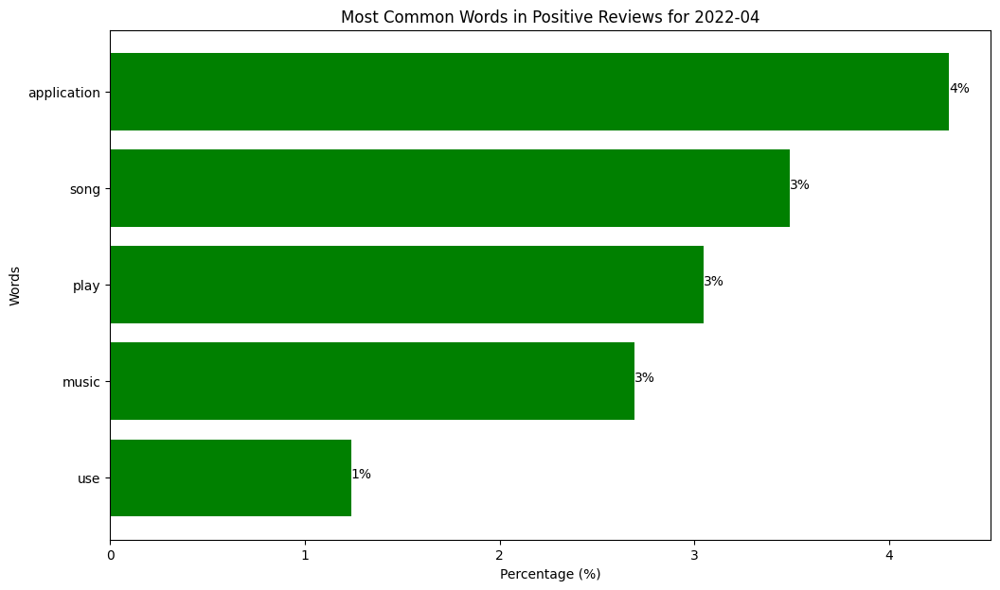

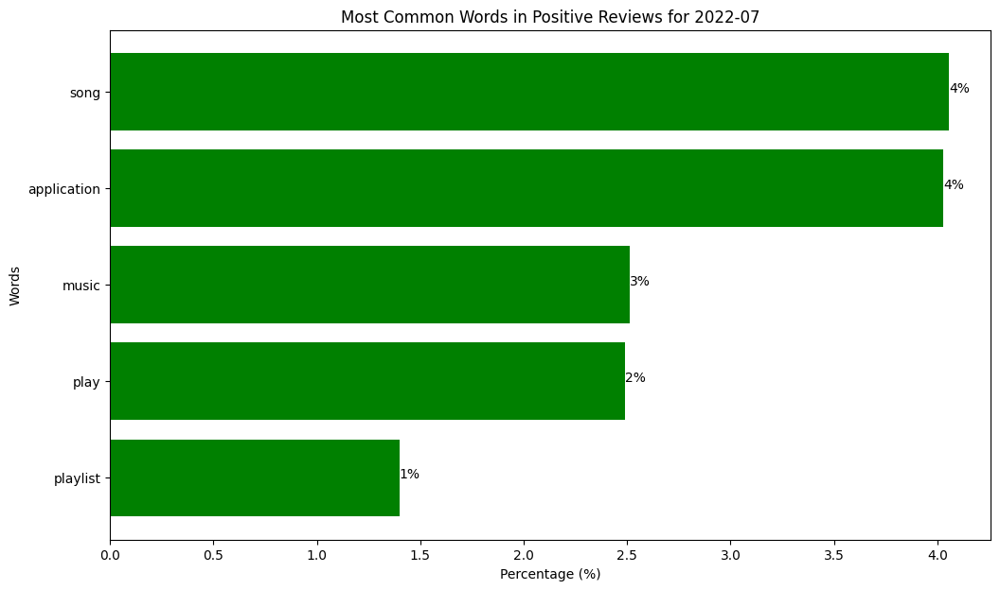

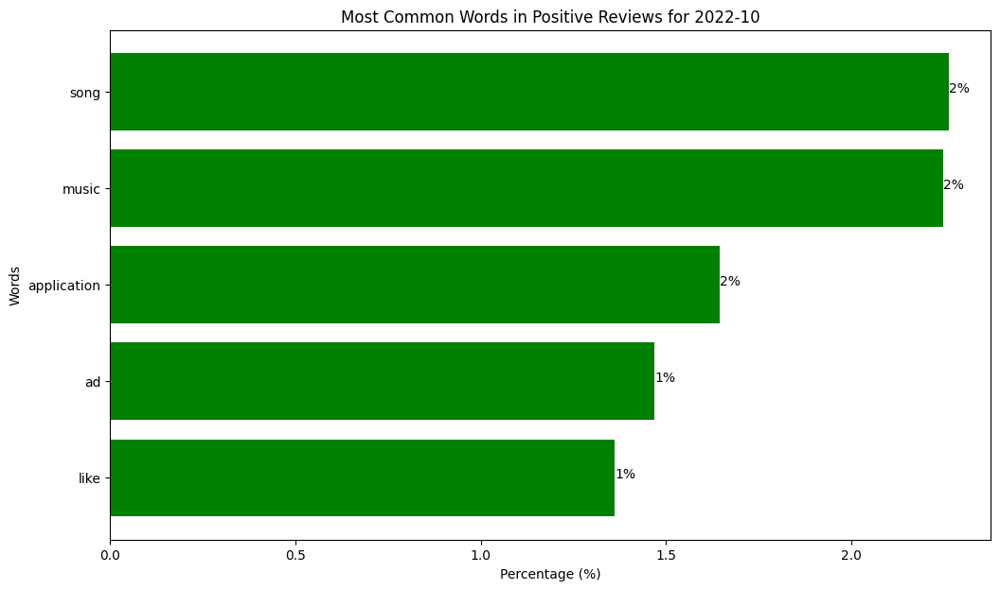

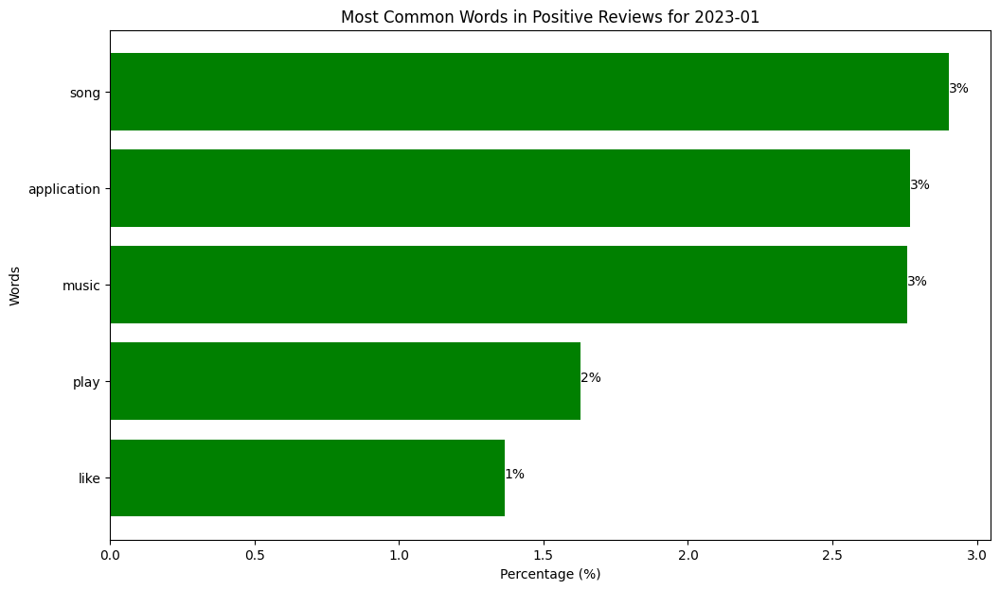

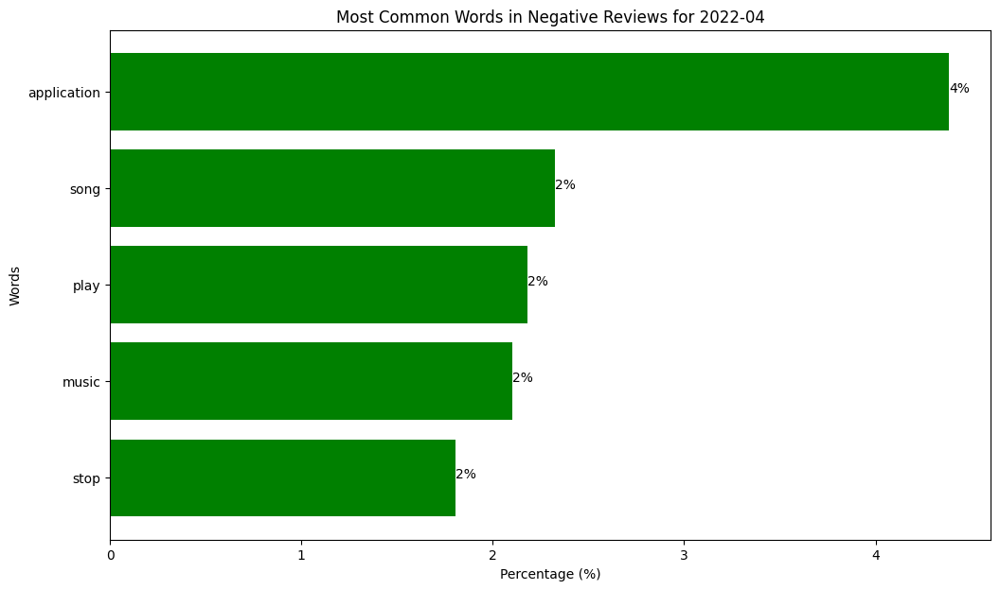

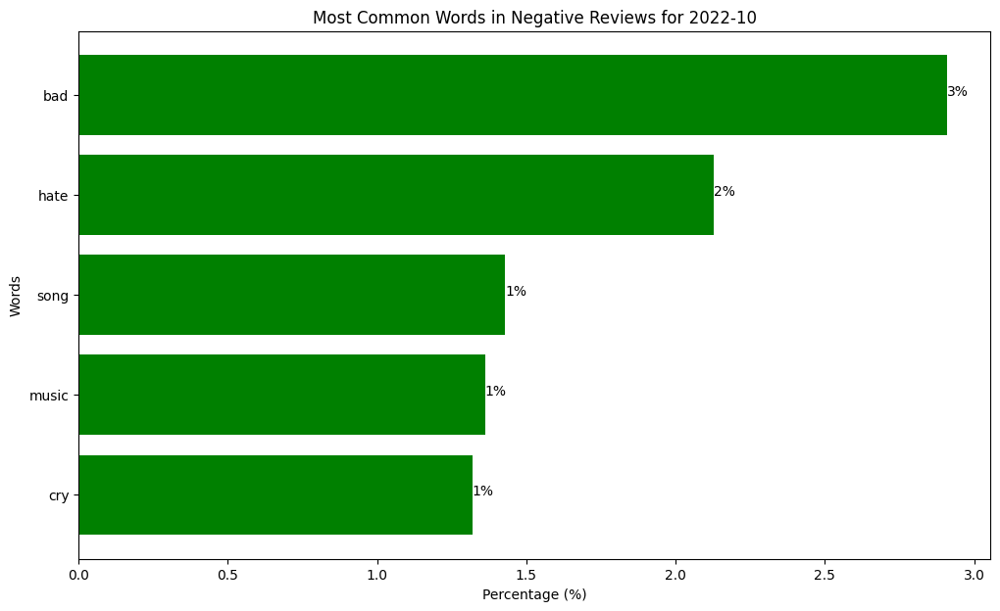

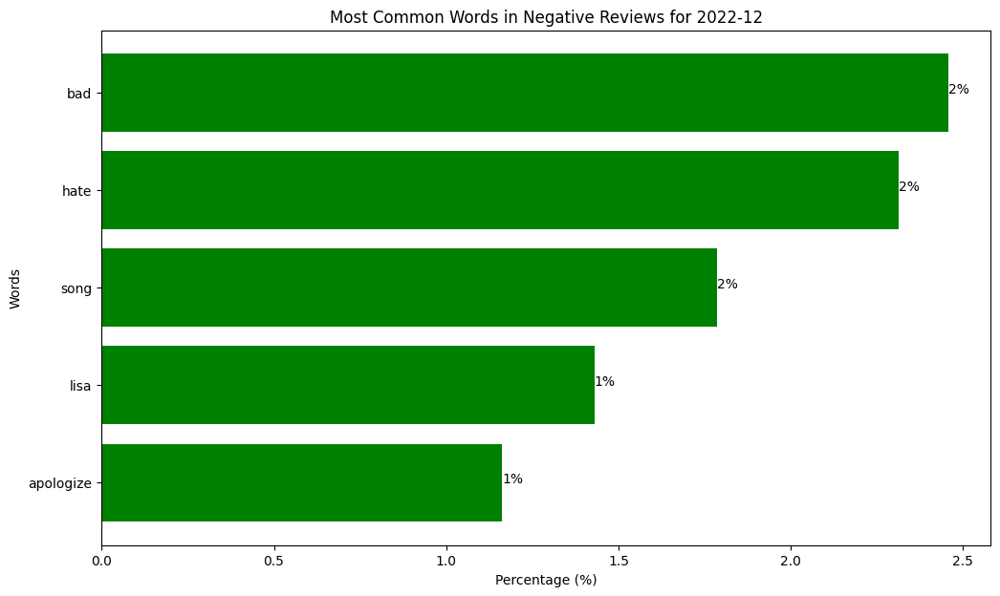

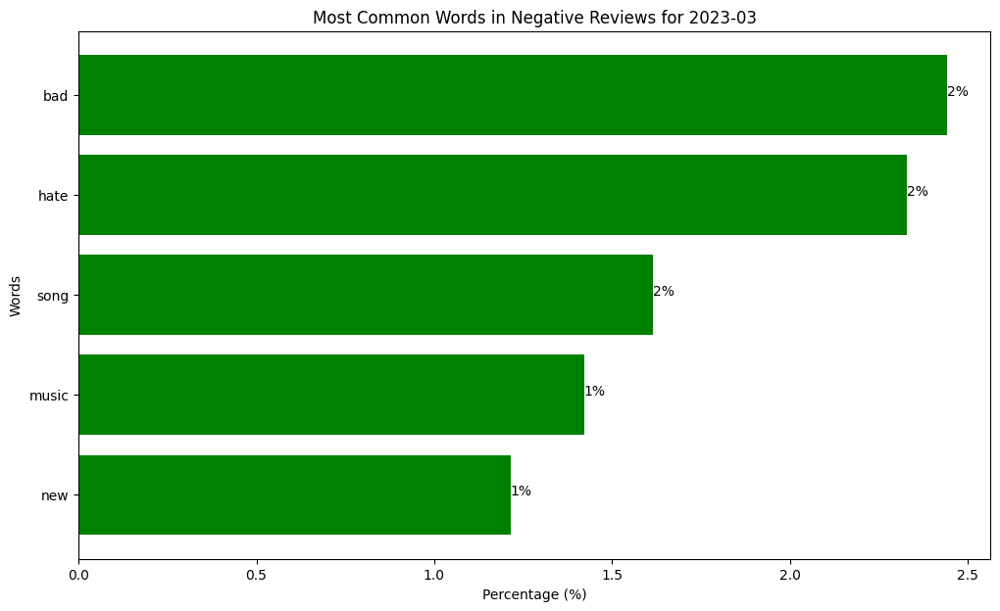

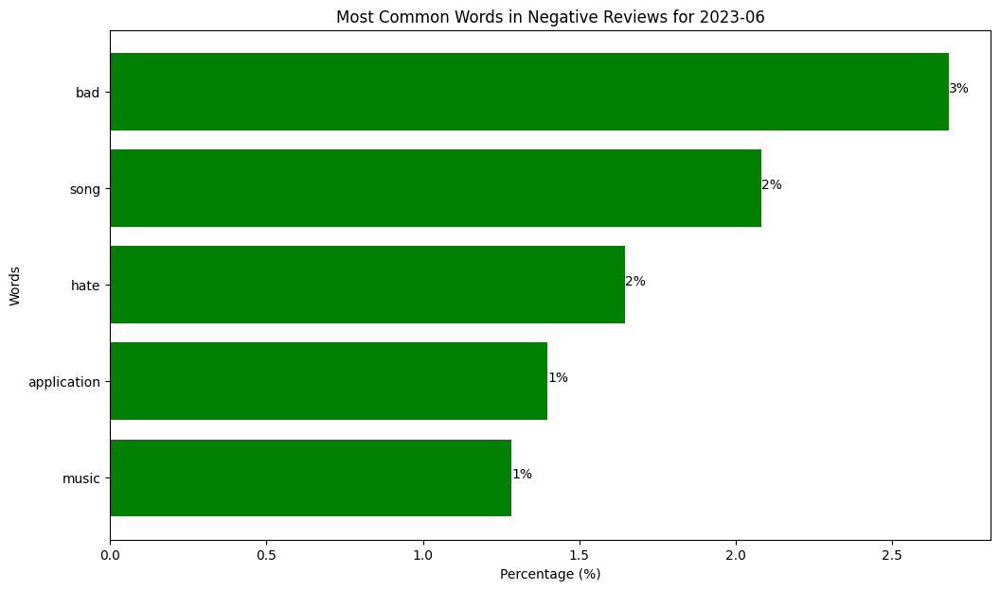

In [79]:
#visualization

def plot_common_words(data, month, sentiment):
    # Extracting the data for the specific month
    df = data[month]

    # Setting the figure and axis
    plt.figure(figsize=(12, 7))
    plt.barh(df['Word'], df['Percentage'], color='green')
    plt.xlabel('Percentage (%)')
    plt.ylabel('Words')
    plt.title(f'Most Common Words in {sentiment} Reviews for {month}')
    plt.gca().invert_yaxis()  # To display the word with the highest percentage at the top
    for index, value in enumerate(df['Percentage']):
        plt.text(value, index, f'{value:.0f}%')  # Annotate the bars with the percentages
    plt.show()

# For positive reviews
for month in positive_months:
    plot_common_words(positive_common_words_per_month, month, 'Positive')

# For negative reviews
for month in negative_months:
    plot_common_words(negative_common_words_per_month, month, 'Negative')


**Extract the sentiments for specific features**

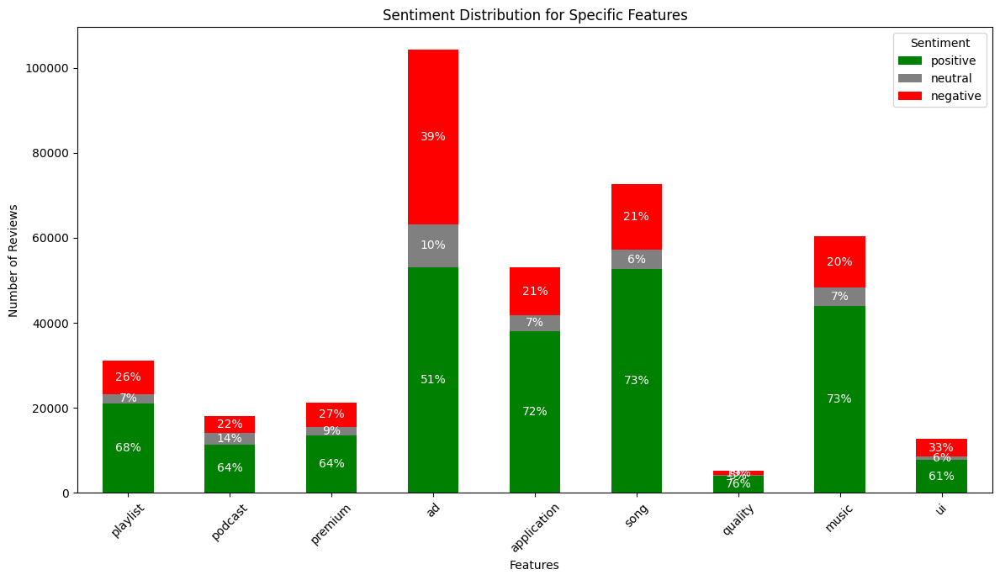

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# List of features to analyze
features = ["playlist", "podcast", "premium", "ad", "application", "song", "quality", "music", "ui"]

# Create a DataFrame to store sentiment counts for each feature
feature_sentiment_counts = pd.DataFrame(columns=['positive', 'neutral', 'negative'])

for feature in features:
    # Filter reviews that mention the feature
    feature_reviews = preprocessed_reviews[preprocessed_reviews['Processed_Review'].str.contains(feature, case=False, na=False)]

    # Aggregate sentiment counts
    sentiment_counts = feature_reviews['ensemble_label'].value_counts()

    # Store the counts in the DataFrame
    feature_sentiment_counts.loc[feature] = sentiment_counts

# Define sentiment colors
color_map = {'negative': 'red', 'neutral': 'grey', 'positive': 'green'}

# Plot
ax = feature_sentiment_counts.plot(kind='bar', stacked=True, figsize=(12, 7), color=[color_map[col] for col in feature_sentiment_counts.columns])
plt.title('Sentiment Distribution for Specific Features')
plt.ylabel('Number of Reviews')
plt.xlabel('Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.legend(title='Sentiment')

# Annotate each segment of the stacked bar with the respective percentage
for i, feature in enumerate(features):
    total_reviews = feature_sentiment_counts.loc[feature].sum()
    start_height = 0  # Keep track of where to place the text for each segment

    for j, sentiment in enumerate(feature_sentiment_counts.columns):
        segment_reviews = feature_sentiment_counts.loc[feature, sentiment]
        percentage = (segment_reviews / total_reviews) * 100

        # Annotate only if there are reviews for the segment
        if segment_reviews > 0:
            height_offset = start_height + (segment_reviews / 2)  # Adjust to place text in the middle of the segment
            ax.text(i, height_offset, f"{percentage:.0f}%", ha='center', va='center', color='white')
            start_height += segment_reviews

plt.show()


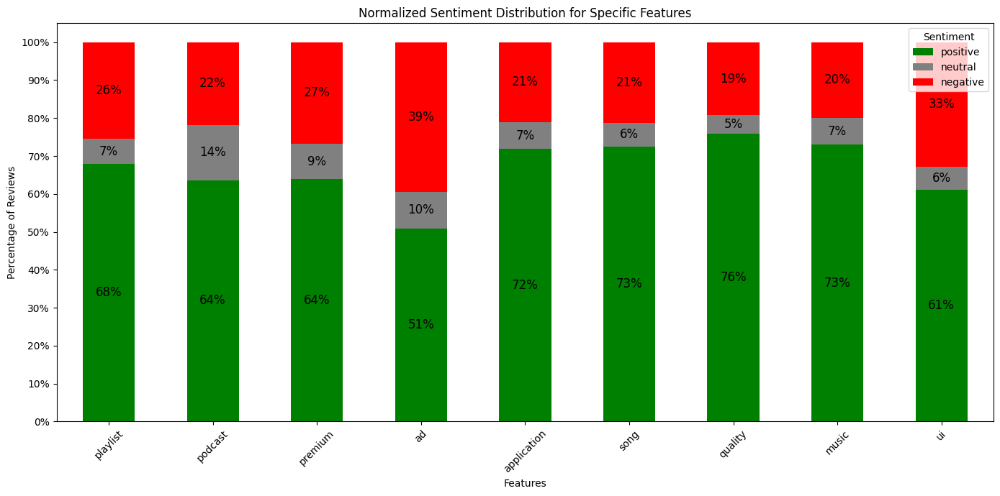

In [100]:
#visualization of the specific features
# Normalize the data to make the sum for each feature equal to 1 (or 100%)
feature_sentiment_percentage = feature_sentiment_counts.divide(feature_sentiment_counts.sum(axis=1), axis=0)

# Plot
ax = feature_sentiment_percentage.plot(kind='bar', stacked=True, figsize=(14, 7), color=[color_map[col] for col in feature_sentiment_counts.columns])
plt.title('Normalized Sentiment Distribution for Specific Features')
plt.ylabel('Percentage of Reviews')
plt.xlabel('Features')
plt.yticks(np.arange(0, 1.1, 0.1), [f"{i*100:.0f}%" for i in np.arange(0, 1.1, 0.1)])
plt.xticks(rotation=45)
plt.tight_layout()
plt.legend(title='Sentiment')

# Annotate each segment with the respective percentage
for i, feature in enumerate(features):
    total_reviews = feature_sentiment_counts.loc[feature].sum()
    start_height = 0

    for j, sentiment in enumerate(feature_sentiment_percentage.columns):
        segment_percentage = feature_sentiment_percentage.loc[feature, sentiment]
        if segment_percentage > 0:
            height_offset = start_height + (segment_percentage / 2)
            ax.text(i, height_offset, f"{segment_percentage*100:.0f}%", ha='center', va='center', color='black', fontsize=12)
            start_height += segment_percentage

plt.show()


**Specific Events Sentiments**

In [ ]:
# Convert 'date' column to datetime format
preprocessed_reviews['date'] = pd.to_datetime(preprocessed_reviews['date'])

# Filter reviews from February 2023 that mention "AI DJ"
february_2023_reviews = preprocessed_reviews[preprocessed_reviews['date'].dt.month == 2]
february_2023_reviews = february_2023_reviews[february_2023_reviews['date'].dt.year == 2023]
ai_dj_reviews = february_2023_reviews[february_2023_reviews['Processed_Review'].str.contains("ai dj", case=False)]

# Analyze the sentiment
ai_dj_sentiment_distribution = ai_dj_reviews['ensemble_label'].value_counts(normalize=True)

# Print the distribution
print(ai_dj_sentiment_distribution)


negative    0.533333
positive    0.333333
neutral     0.133333
Name: ensemble_label, dtype: float64


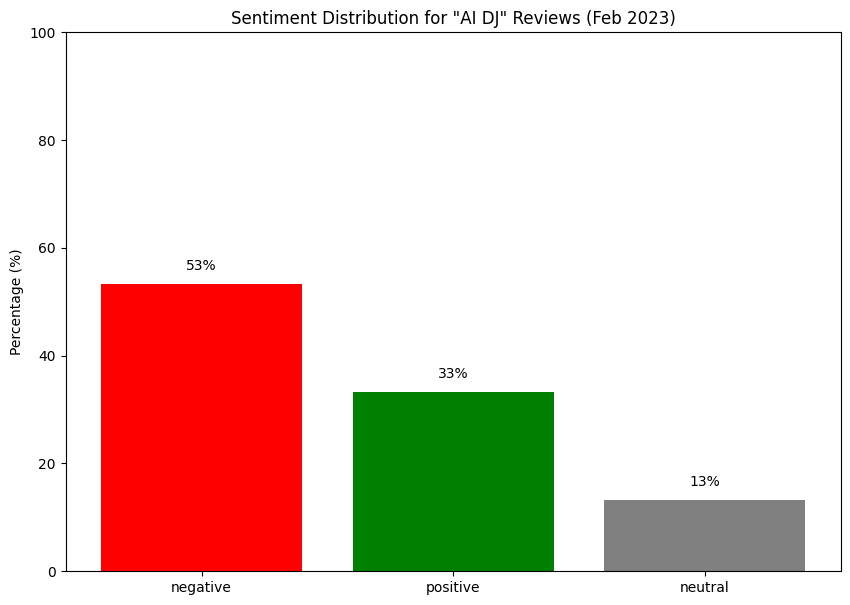

In [88]:
import matplotlib.pyplot as plt

# Sentiment distribution for "AI DJ" reviews from February 2023
sentiment_distribution = {
    'negative': 53.3,  # 0.533333 * 100
    'positive': 33.3,  # 0.333333 * 100
    'neutral': 13.3    # 0.133333 * 100
}

# Visualization
labels = sentiment_distribution.keys()
values = sentiment_distribution.values()

plt.figure(figsize=(10, 7))
bars = plt.bar(labels, values, color=['red', 'green', 'grey'])
plt.ylabel('Percentage (%)')
plt.title('Sentiment Distribution for "AI DJ" Reviews (Feb 2023)')
plt.ylim(0, 100)  # Set y-axis limits

# Display the exact percentages on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 2, f'{yval:.0f}%', ha='center', va='bottom')

plt.show()


The sentiment distribution towards Spotify's "AI DJ" feature, released in February 2023, indicates the following:

Negative Sentiment (53.3%): A majority of the users expressed negative feelings or complaints regarding the AI DJ feature.

Positive Sentiment (33.3%): About one-third of the users had positive feedback or appreciation for the feature.

Neutral Sentiment (13.3%): A smaller portion of users had neutral comments, suggesting they neither loved nor disliked the feature, or their reviews were more informational without expressing strong feelings.

In [ ]:
print(preprocessed_reviews.columns)


Index(['date', 'review', 'appVersion', 'country', 'source', 'major_appVersion',
       'Processed_Review', 'review_length', 'vader_score_original',
       'vader_score_preprocessed', 'textblob_score_original',
       'textblob_score_preprocessed', 'vader_label_original',
       'vader_label_preprocessed', 'textblob_label_original',
       'textblob_label_preprocessed', 'adjusted_vader_label',
       'adjusted_textblob_label', 'ensemble_label', 'vader_compound',
       'polarity', 'subjectivity'],
      dtype='object')


**BERT Model & Perfomance Evaluation**

In [ ]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

In [ ]:
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    COLAB = True
    print("Note: using Google CoLab")
    %tensorflow_version 2.x
except:
    print("Note: not using Google CoLab")
    COLAB = False

Mounted at /content/drive
Note: using Google CoLab
Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
import pandas as pd

In [ ]:
preprocessed_reviews = pd.read_csv("/content/drive/My Drive/Project/preprocessed_reviews_sentiment.csv") #read in the file with sentiments labeled and preprocessed reviews

In [ ]:
!pip uninstall transformers -y
!pip uninstall accelerate -y
!pip uninstall datasets -y
!pip install transformers[torch] -U
!pip install accelerate -U
!pip install datasets -U

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 32.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 69.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 72.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 32.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.3/519.3 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.8 MB/s eta 0:00:00


In [ ]:
# For tokenization and model
from transformers import BertTokenizer, BertForSequenceClassification

# For training
from transformers import Trainer, TrainingArguments

from sklearn.model_selection import train_test_split

# import the `datasets` library:
from datasets import Dataset

import torch #import torch


In [ ]:
from transformers import BertTokenizer

tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")


In [ ]:
# 1. Data Splitting
df_train, df_test = train_test_split(preprocessed_reviews, test_size=0.2, random_state=42)

In [ ]:
# 2. Tokenization and Dataset Preparation
# Ensure that the ensemble_label column is of type str
df_train['ensemble_label'] = df_train['ensemble_label'].astype(str)
df_test['ensemble_label'] = df_test['ensemble_label'].astype(str)

def tokenize_and_add_labels(batch):
    tokenized = tokenizer(
        batch['Processed_Review'],
        padding="max_length",
        truncation=True,
        max_length=256,
        return_tensors='pt',
        return_attention_mask=True,
        return_token_type_ids=True
    )

    label_mapping = {'positive': 1, 'neutral': 0, 'negative': 2}
    labels = [label_mapping[label] for label in batch["ensemble_label"]]
    tokenized["labels"] = torch.tensor(labels, dtype=torch.long)  # Ensure labels are tensors

    return tokenized

train_dataset = Dataset.from_pandas(df_train).map(tokenize_and_add_labels, batched=True)
test_dataset = Dataset.from_pandas(df_test).map(tokenize_and_add_labels, batched=True)

Map:   0%|          | 0/252688 [00:00<?, ? examples/s]

Map:   0%|          | 0/63172 [00:00<?, ? examples/s]

In [ ]:
# 3. Training Configuration
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=64,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    save_strategy="steps",
    evaluation_strategy="steps",
    load_best_model_at_end=True,
    push_to_hub=False
)

In [ ]:
# 4. Model Initialization
model = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=3)  # 3 labels: positive, negative, neutral

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
# Define TrainingArguments and Trainer again
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    evaluation_strategy="epoch",
    logging_dir='./logs',
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset
)

# Train the model
trainer.train()


Epoch,Training Loss,Validation Loss


Epoch,Training Loss,Validation Loss
1,0.169700,0.157774
2,0.105000,0.113085
3,0.071600,0.109459


TrainOutput(global_step=47379, training_loss=0.13977158553955732, metrics={'train_runtime': 11930.4152, 'train_samples_per_second': 63.54, 'train_steps_per_second': 3.971, 'total_flos': 9.97284049482793e+16, 'train_loss': 0.13977158553955732, 'epoch': 3.0})

In [ ]:
# Save the Best Model
# save the model and tokenizer
trainer.save_model("/content/drive/My Drive/Project/saved_models/BERT_model")
tokenizer.save_pretrained("/content/drive/My Drive/Project/saved_models/BERT_tokenizer")

In [ ]:
trainer.save_state()

In [ ]:
# Evaluation
results = trainer.evaluate()
print("Results:", results)

Results: {'eval_loss': 0.10945885628461838, 'eval_runtime': 372.5212, 'eval_samples_per_second': 169.58, 'eval_steps_per_second': 21.199, 'epoch': 3.0}


Accuracy (
0.9729
0.9729):
This metric indicates that the model correctly predicted the class of about
97.29
%
97.29% of the samples in the test dataset. This is a high accuracy, especially for a multi-class classification task.
Precision (
0.9730
0.9730):
Precision measures the number of correctly predicted positive observations out of the total predicted positives. A high precision indicates a low false positive rate. An average weighted precision of
97.30
%
97.30% is excellent.
Recall (
0.9729
0.9729):
Recall (or Sensitivity) calculates the number of correctly predicted positive observations out of the actual positives. A high recall indicates that the model correctly identified most of the actual positives. A recall of
97.29
%
97.29% suggests that the model is capturing almost all of the true instances for each class.
F1 Score (
0.9729
0.9729):
The F1 Score is the harmonic mean of Precision and Recall and is a good metric to consider if there is an uneven class distribution. An F1 Score close to 1 indicates a balance between precision and recall. An F1 Score of
97.29
%
97.29% is again outstanding.

In [ ]:
from transformers import BertForSequenceClassification, BertTokenizer, Trainer, TrainingArguments
from datasets import Dataset
import torch

# Load model and tokenizer
model = BertForSequenceClassification.from_pretrained("/content/drive/My Drive/Project/saved_models/BERT_model")
tokenizer = BertTokenizer.from_pretrained("/content/drive/My Drive/Project/saved_models/BERT_tokenizer")


In [ ]:
#Recreate the trainer object:
training_args = TrainingArguments(
    output_dir='./results',
    per_device_eval_batch_size=64,
    logging_dir='./logs',
)

trainer = Trainer(
    model=model,
    args=training_args
)


In [ ]:
#Recreate the test dataset
# Convert the 'ensemble_label' column to str if it's not
df_test['ensemble_label'] = df_test['ensemble_label'].astype(str)

def tokenize_and_add_labels(batch):
    tokenized = tokenizer(
        batch['Processed_Review'],
        padding="max_length",
        truncation=True,
        max_length=256,
        return_tensors='pt',
        return_attention_mask=True,
        return_token_type_ids=True
    )

    label_mapping = {'positive': 1, 'neutral': 0, 'negative': 2}
    labels = [label_mapping[label] for label in batch["ensemble_label"]]
    tokenized["labels"] = torch.tensor(labels, dtype=torch.long)  # Ensure labels are tensors

    return tokenized

test_dataset = Dataset.from_pandas(df_test).map(tokenize_and_add_labels, batched=True)


Map:   0%|          | 0/63172 [00:00<?, ? examples/s]

In [ ]:
import numpy as np

# 1. Get Predictions
predictions, labels, _ = trainer.predict(test_dataset)
predictions = np.argmax(predictions, axis=1)  # Convert logits to class indices


In [ ]:
from transformers import BertForSequenceClassification, BertTokenizer

# Load the saved model
model = BertForSequenceClassification.from_pretrained("/content/drive/My Drive/Project/saved_models/BERT_model")

# Load the saved tokenizer
tokenizer = BertTokenizer.from_pretrained("/content/drive/My Drive/Project/saved_models/BERT_tokenizer")


**Compare BERT's predictions to ensemble labels**

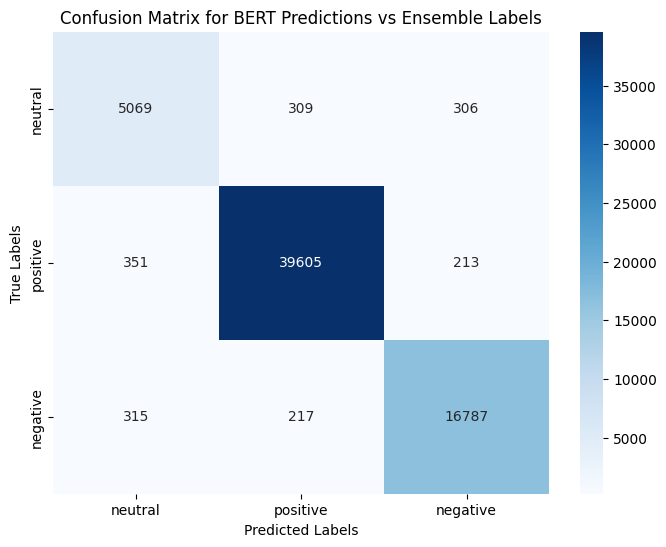

In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

# Generate the confusion matrix
conf_matrix = confusion_matrix(labels, predictions)

# Define the class labels
class_labels = ['neutral', 'positive', 'negative']

# Plot the heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='g', cmap='Blues',
            xticklabels=class_labels, yticklabels=class_labels)

plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix for BERT Predictions vs Ensemble Labels')
plt.show()


In [ ]:
bert_predictions = np.argmax(predictions, axis=1)

In [ ]:
label_mapping = {'positive': 1, 'neutral': 0, 'negative': 2}
ensemble_labels_test = df_test['ensemble_label'].map(label_mapping).tolist()


In [ ]:
# Quantitative Comparison
accuracy = accuracy_score(ensemble_labels_test, bert_predictions)
print(f"Accuracy: {accuracy}")

report = classification_report(ensemble_labels_test, bert_predictions, target_names=['negative', 'neutral', 'positive'])
print(report)

conf_matrix = confusion_matrix(ensemble_labels_test, bert_predictions)
print(conf_matrix)


Accuracy: 0.9729152156018489
              precision    recall  f1-score   support

    negative       0.88      0.89      0.89      5684
     neutral       0.99      0.99      0.99     40169
    positive       0.97      0.97      0.97     17319

    accuracy                           0.97     63172
   macro avg       0.95      0.95      0.95     63172
weighted avg       0.97      0.97      0.97     63172

[[ 5069   309   306]
 [  351 39605   213]
 [  315   217 16787]]



The results are impressive! Here's a breakdown:

Accuracy: The overall accuracy of 97.29% means that, on average, BERT correctly predicted the sentiment of about 97.29% of test reviews when compared with the ensemble method.

Precision, Recall, and F1-Score:

For Negative reviews:
Precision of 0.88 means that out of all the reviews BERT predicted as negative, 88% were actually negative according to the ensemble method.
Recall of 0.89 means that BERT successfully identified 89% of the actual negative reviews.
F1-Score (the harmonic mean of Precision and Recall) of 0.89 indicates a good balance between Precision and Recall for the negative class.
For Neutral reviews:
Both precision and recall are extremely high, which suggests that BERT is particularly good at identifying neutral reviews.
For Positive reviews:
BERT also performed very well in predicting positive reviews with a precision and recall of 0.97.
Confusion Matrix: The diagonal from top-left to bottom-right gives you the number of correct predictions for each class. The other values in a row show where the misclassifications went. For instance, for the negative class (first row), there were 309 instances that were actually negative but predicted as neutral by BERT and 306 instances predicted as positive.




**McNemar's test to determine if the difference in accuracy between BERT and the ensemble approach  is statistically significant**

In [ ]:
from statsmodels.stats.contingency_tables import mcnemar

# Get Predictions
predictions, _, _ = trainer.predict(test_dataset)
bert_predictions = np.argmax(predictions, axis=1)  # Convert logits to class indices

# Convert ensemble labels to numeric format
ensemble_labels_test = df_test['ensemble_label'].tolist()  # Extracting ensemble labels from the test set
label_mapping = {'positive': 1, 'neutral': 0, 'negative': 2}
ensemble_predictions_numeric = [label_mapping[label] for label in ensemble_labels_test]

# McNemar's Test
def mcnemars_test(true_labels, predictions_a, predictions_b):
    # Create the contingency table
    table = [[0, 0], [0, 0]]
    for true, pred_a, pred_b in zip(true_labels, predictions_a, predictions_b):
        if true == pred_a == pred_b:
            table[0][0] += 1
        elif true == pred_a:
            table[0][1] += 1
        elif true == pred_b:
            table[1][0] += 1
        else:
            table[1][1] += 1

    # Perform McNemar's test
    result = mcnemar(table, exact=True)
    return result.statistic, result.pvalue

# Using the function
true_labels_numeric = [label_mapping[label] for label in ensemble_labels_test]  # Convert true labels to numeric
stat, pvalue = mcnemars_test(true_labels_numeric, bert_predictions, ensemble_predictions_numeric)
print(f"Statistic: {stat}, p-value: {pvalue}")


Statistic: 0.0, p-value: 0.0


McNemar's test is yielding a result of Statistic: 0.0, p-value: 0.0, it suggests that the two models (BERT and the ensemble model) are in high agreement for the test data you provided.
 The essence of McNemar's test is to examine whether the disagreements between two models are statistically significant. When you see a statistic of 0.0 from McNemar's test, it implies that the number of instances where Model A is correct and Model B is incorrect is roughly equal to the number of instances where Model B is correct and Model A is incorrect. In other words, there's no significant difference in the error rates of the two models.

 Identical Predictions: if for most samples, both BERT and the ensemble model predict the same label, then their disagreement rate is low, which leads to a McNemar's test statistic of 0.

Differing Predictions: If there are samples where BERT predicts correctly and the ensemble doesn't, and vice versa, but the number of such instances is roughly equal, then again, McNemar's test would yield a statistic of 0.

In [ ]:
for bert_pred, ensemble_pred in zip(bert_predictions[:20], ensemble_predictions_numeric[:20]): #compare results of both methods if they are matching
    print(bert_pred, ensemble_pred)


0 1
1 1
2 2
1 1
1 1
1 1
1 1
1 1
1 1
2 2
2 2
0 0
2 2
1 1
2 2
2 2
1 1
1 1
1 1
2 2


**Other attempts outside project scope**

**Traditional Models:** Naive Bayes, Random Forest, SVM, Logistic Rrgression on KMeans Clustering using word embeddings from BERT.

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score

In [ ]:
# 1. Data Preparation
X = loaded_embeddings  #  BERT embeddings
y = preprocessed_reviews['ensemble_label'].map({'positive': 1, 'neutral': 0, 'negative': -1}).values  # labels

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 2. Apply SMOTE
smote = SMOTE(random_state=42)
X_sm, y_sm = smote.fit_resample(X_train, y_train)

In [ ]:
# Logistic Regression Model Training
clf = LogisticRegression(max_iter=1000)  # Increased max_iter for convergence with large datasets
clf.fit(X_sm, y_sm)

# Model Evaluation
y_pred = clf.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))


Accuracy: 0.743889697967454
              precision    recall  f1-score   support

          -1       0.71      0.72      0.72     17319
           0       0.29      0.62      0.40      5684
           1       0.92      0.77      0.84     40169

    accuracy                           0.74     63172
   macro avg       0.64      0.70      0.65     63172
weighted avg       0.81      0.74      0.77     63172



In [ ]:
#Naive Bayes Classifier
from sklearn.naive_bayes import GaussianNB

# Initialize the GaussianNB classifier
gnb = GaussianNB()

# Train the classifier on the SMOTE balanced training data
gnb.fit(X_sm, y_sm)

# Predict on the test set
y_pred_nb = gnb.predict(X_test)

# Evaluate the model
print("Accuracy for Gaussian Naive Bayes:", accuracy_score(y_test, y_pred_nb))
print(classification_report(y_test, y_pred_nb))


Accuracy for Gaussian Naive Bayes: 0.5737035395428355
              precision    recall  f1-score   support

          -1       0.48      0.57      0.52     17319
           0       0.20      0.46      0.28      5684
           1       0.81      0.59      0.68     40169

    accuracy                           0.57     63172
   macro avg       0.50      0.54      0.49     63172
weighted avg       0.66      0.57      0.60     63172



In [ ]:
#Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier

# Initialize the RandomForest classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the classifier on the SMOTE balanced training data
rf.fit(X_sm, y_sm)

# Predict on the test set
y_pred_rf = rf.predict(X_test)

# Evaluate the model
print("Accuracy for Random Forest:", accuracy_score(y_test, y_pred_rf))
print(classification_report(y_test, y_pred_rf))


Accuracy for Random Forest: 0.7615715823466093
              precision    recall  f1-score   support

          -1       0.67      0.69      0.68     17319
           0       0.47      0.39      0.42      5684
           1       0.84      0.85      0.84     40169

    accuracy                           0.76     63172
   macro avg       0.66      0.64      0.65     63172
weighted avg       0.76      0.76      0.76     63172



**Evaluating Perfomance of the Ensemble approach using Naive Bayes, Randon forest and Logistic Regression**

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from imblearn.over_sampling import SMOTE

In [ ]:
# Define feature and target
X = preprocessed_reviews['Processed_Review']
y = preprocessed_reviews['ensemble_label']


In [ ]:
#Vectorize the Data: TfidfVectorizer to transform the reviews into a suitable format for the classifiers.
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer()
X_vectorized = vectorizer.fit_transform(X)


In [ ]:
#Divide the data into training and test sets to evaluate the model's performance
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_vectorized, y, test_size=0.2, random_state=42)


In [ ]:
# Check distribution of the target classes in the training set
print(y_train.value_counts())

positive    160622
negative     69152
neutral      22914
Name: ensemble_label, dtype: int64


The class distribution of ensemble_label in training data indicates a significant class imbalance:

Positive: 160,622 samples
Negative: 69,152 samples
Neutral: 22,914 samples
Given this distribution, there's a strong imbalance, with the majority of the reviews being labeled as positive. This is why using SMOTE or other oversampling techniques can be beneficial.

Class imbalance is a common issue in classification tasks, especially when dealing with sentiment analysis where one sentiment class may be heavily represented compared to others. It can lead to models being biased towards the majority class

**SMOTE (Synthetic Minority Over-sampling Technique) to create synthetic examples of the minority classes (neutral and negative in this case)**

In [ ]:
# There is a class imbalance, apply SMOTE to the training data
smote = SMOTE()
X_train_sm, y_train_sm = smote.fit_resample(X_train, y_train)

In [ ]:
# Logistic Regression
clf_lr = LogisticRegression(max_iter=1000)
clf_lr.fit(X_train_sm, y_train_sm)
y_pred_lr = clf_lr.predict(X_test)
print("Logistic Regression:")
print("Accuracy:", accuracy_score(y_test, y_pred_lr))
print(classification_report(y_test, y_pred_lr))

# Naive Bayes
clf_nb = MultinomialNB()
clf_nb.fit(X_train_sm, y_train_sm)
y_pred_nb = clf_nb.predict(X_test)
print("Naive Bayes:")
print("Accuracy:", accuracy_score(y_test, y_pred_nb))
print(classification_report(y_test, y_pred_nb))

# Random Forest
clf_rf = RandomForestClassifier()
clf_rf.fit(X_train_sm, y_train_sm)
y_pred_rf = clf_rf.predict(X_test)
print("Random Forest:")
print("Accuracy:", accuracy_score(y_test, y_pred_rf))
print(classification_report(y_test, y_pred_rf))

Logistic Regression:
Accuracy: 0.8884474134110049
              precision    recall  f1-score   support

    negative       0.90      0.86      0.88     17319
     neutral       0.51      0.77      0.61      5684
    positive       0.97      0.92      0.94     40169

    accuracy                           0.89     63172
   macro avg       0.79      0.85      0.81     63172
weighted avg       0.91      0.89      0.90     63172

Naive Bayes:
Accuracy: 0.764721712150953
              precision    recall  f1-score   support

    negative       0.71      0.76      0.73     17319
     neutral       0.33      0.56      0.42      5684
    positive       0.91      0.80      0.85     40169

    accuracy                           0.76     63172
   macro avg       0.65      0.71      0.67     63172
weighted avg       0.81      0.76      0.78     63172

Random Forest:
Accuracy: 0.8622807572975368
              precision    recall  f1-score   support

    negative       0.84      0.80      0.82     